# Accuracy of pronounciation

**Goal**: to create a neural network that recognizes the sounds of English speech and evaluates the quality of pronunciation.

**Purpose**: using examples of the diphthong [ai] to get the most possible significant differences.

**Method**: combination of classifier and autoencoder.

For the classifier, a training set of 120 words with diphthongs [ai] was used:

https://drive.google.com/drive/folders/11_MFr0WoAqVkHqhYQuWFCEb9lL5ZA8pu?usp=sharing

Classification accuracy was evaluated on a test set of 30 words:

https://drive.google.com/drive/folders/1VNxNB1f-TLgYfF1wEKiX5x-2pE861Sqq?usp=sharing

The selected sounds [ai] from the training sample were used to train the autoencoder.

yTrain, yTest were collected in a semi-automatic mode: an audio recording was listened to, places where the required sound was present were marked, marks were added to the list. The program, in accordance with the labels, created the correct answers and cut the sounds for the autoencoder.

The words are collected from the site https://ru.forvo.com, where native speakers voice the words. Words were selected only with a positive index for those who voiced.

# Точность произношения звуков английского языка. 

**Цель**: создать нейронную сеть, которая распознаёт звуки английского языка и оценивает качество их произношения. 

**Замысел**: использовать дифтонг [ai] и получить наиболее возможные значимые отличия. 

**Метод**: комбинация классификатора и автоэнкодера. 

Для классификатора использована тренировочная выборка из 120 слов с дифтонгами [ai]: https://drive.google.com/drive/folders/11_MFr0WoAqVkHqhYQuWFCEb9lL5ZA8pu?usp=sharing

Точность классификации оценивалась на тестовой выборке в 30 слов: https://drive.google.com/drive/folders/1VNxNB1f-TLgYfF1wEKiX5x-2pE861Sqq?usp=sharing

Для тренировки автоэнкодера использовались выделенные звуки [ai] из тренировочной выборки. 

yTrain, yTest  собирались в полуавтоматическом режиме: прослушивалась аудиозапись, отмечались места, где присутствует требуемый звук, метки вносились в список. Программа в соответствии с метками создавала правильные ответы и нарезала звуки для автоэнкодера. 

Слова собраны с сайта https://forvo.com, где носители языка озвучивают слова. Отбирались слова только с положительным индексом для тех, кто озвучивал.

In [1]:
from google.colab import files 
from tensorflow.keras.utils import to_categorical 
import os 
import librosa 
import numpy as np 
import matplotlib.pyplot as plt 
import time 
from tensorflow.keras.callbacks import LambdaCallback, ReduceLROnPlateau, TensorBoard 

from tensorflow.keras.optimizers import Adam, RMSprop 
from tensorflow.keras.models import Sequential, Model 
from tensorflow.keras.layers import concatenate, Input, Dense, Dropout, Reshape, MaxPooling2D, Conv2DTranspose, MaxPooling1D, UpSampling2D, Bidirectional
from tensorflow.keras.layers import BatchNormalization, Flatten, Conv1D, Conv2D, LSTM, Lambda, Conv1DTranspose, GaussianNoise, LeakyReLU, PReLU, Embedding
from sklearn.model_selection import train_test_split 
from sklearn.preprocessing import LabelEncoder, StandardScaler, MinMaxScaler
import tensorflow.keras.backend as K
from tensorflow.keras.losses import binary_crossentropy
from tensorflow.keras.models import load_model
import pandas as pd
import matplotlib.pyplot as plt 
import librosa.display 
from google.colab import files 
import IPython.display as ipd 
from IPython.display import HTML, Audio # загружаем модуль чтобы обратиться к HTML для записи аудио с микрофона в ноутбуке
from base64 import b64decode # модуль для кодировки/раскодировки аудиозаписи(64-разрядный код)
from scipy.io.wavfile import read as wav_read # для чтения WAV формата
import io
import scipy # воспользуемся модулями библиотеки для работы со звуковой дорожкой
from google.colab.output import eval_js
import sklearn 
from sklearn.cluster import KMeans 
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
import soundfile
import seaborn as sns
import scipy
import warnings
warnings.filterwarnings('ignore')

from tensorflow.keras.utils import plot_model
%matplotlib inline

In [ ]:
sr = 22050
n_fft = 511 # 512 - количество кадров в 23 мс каждый; берём 511, 
  # чтобы получилось 256 в stft; 2048 - количество выборок по умолчанию в librosa
  # при длине кадра 93 мс (данные из librosa)

In [6]:
sr = 22050
n_fft = 255 # 512 - количество кадров в 23 мс каждый; берём 511, 
  # чтобы получилось 256 в stft; 2048 - количество выборок по умолчанию в librosa
  # при длине кадра 93 мс (данные из librosa)

Текущие задачи: 

1. Изменить нормализацию на мин-макс и получить диапазон от 0 до 1 - сродни вероятностям. 

2. изменить n_fft, чтобы получить меньшие срезы и более точное отображение звуков. 

3. Сконкатенировать все признаки в один большой массив и работать с ним. 

4. Добавить производные, средние, ошибки, обратные значения и т.д. к mfcc. 

5. Изменить архитектуру автокодировщика - изменить размер самого узкого места. 

6. Сделать классификационную модель на основе конв1д.

7. Сделать классификационную модель на основе конв2д - добавить размерности из производных, средних, ошибок и т.д.??

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Functions

In [7]:
# Функция параметризации аудио
def get_features_2d(y, sr, n_fft):
  '''
  function convert audio to parameters
  input
    y,sr from audio from toTakeRawAudio() function, n_ftt 511 - for human speach
  outputs
    parameters of audio like stft, mfcc etc
  '''
  # Получаем различные параметры аудио
  stft = librosa.stft(y, n_fft = n_fft, hop_length = n_fft) # 511 - for human speach
  stft = librosa.amplitude_to_db(abs(stft))
  mfcc = librosa.feature.mfcc(y=y, sr=sr, n_fft = n_fft, hop_length = n_fft, n_mfcc=40) 
  #mfcc = sklearn.preprocessing.scale(mfcc, axis=1)
  chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr)     # Частота цветности
  chromagram = librosa.feature.chroma_cqt(y = y, sr=sr)
  
  rmse = librosa.feature.rms(y=y)                          # Среднеквадратичная амплитуда
  spec_cent = librosa.feature.spectral_centroid(y=y, sr=sr) # Спектральный центроид
  spectral_rolloff = librosa.feature.spectral_rolloff(y, sr=sr, roll_percent=0.85) # спектральный спад частоты
  #zero_crossings = librosa.zero_crossings(y, pad=False) # переходы через 0 # , zero_crossings
  
  # Возвращаем получившийся список
  return stft, mfcc, chroma_stft, chromagram, rmse, spec_cent, spectral_rolloff


In [8]:
# Функция параметризации аудио
def get_features_2d(y, sr, n_fft):
  '''
  function convert audio to parameters
  input
    y,sr from audio from toTakeRawAudio() function, n_ftt 511 - for human speach
  outputs
    parameters of audio like stft, mfcc etc
  '''
  # Получаем различные параметры аудио
  stft = librosa.stft(y, n_fft = n_fft, hop_length = n_fft) # 511 - for human speach
  stft = librosa.amplitude_to_db(abs(stft))
  mfcc = librosa.feature.mfcc(y=y, sr=sr, n_fft = n_fft, hop_length = n_fft, n_mfcc=40) 
  #mfcc = sklearn.preprocessing.scale(mfcc, axis=1)
  chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr)     # Частота цветности
  chromagram = librosa.feature.chroma_cqt(y = y, sr=sr)
  
  rmse = librosa.feature.rms(y=y)                          # Среднеквадратичная амплитуда
  spec_cent = librosa.feature.spectral_centroid(y=y, sr=sr) # Спектральный центроид
  spectral_rolloff = librosa.feature.spectral_rolloff(y, sr=sr, roll_percent=0.85) # спектральный спад частоты
  #zero_crossings = librosa.zero_crossings(y, pad=False) # переходы через 0 # , zero_crossings
  
  # Возвращаем получившийся список
  return stft, mfcc, chroma_stft, chromagram, rmse, spec_cent, spectral_rolloff


In [9]:
# Функция параметризации аудио; без mfcc, stft
def get_features_2d2(y, sr):
  '''
  function convert audio to parameters
  input
    y,sr from audio from toTakeRawAudio() function, n_ftt 511 - for human speach
  outputs
    parameters of audio like stft, mfcc etc
  '''

  chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr,n_fft = 511, hop_length = 511)     # Частота цветности
  chromagram = librosa.feature.chroma_cqt(y = y, sr=sr)
  
  rmse = librosa.feature.rms(y=y)                          # Среднеквадратичная амплитуда
  spec_cent = librosa.feature.spectral_centroid(y=y, sr=sr) # Спектральный центроид
  spectral_rolloff = librosa.feature.spectral_rolloff(y, sr=sr, roll_percent=0.85) # спектральный спад частоты
  zero_crossings = librosa.zero_crossings(y, pad=False) # переходы через 0
  
  # Возвращаем получившийся список
  return chroma_stft, chromagram, rmse, spec_cent, spectral_rolloff, zero_crossings


In [10]:
def toTakeRawAudio(directory = r'/content/drive/MyDrive/dz/pronounce/I/'):
  '''
  function prepared array of raw audio from directory
  input
    directory
  output
    y,sr from audio for get_features_2d(function)
  '''
  audio = []
  for file in sorted(os.listdir(directory)):
    if file.endswith('.mp3') or file.endswith('.wav'):  
      original_path = directory + file
      y, sr = librosa.load(original_path, mono=True) 
      audio.append(y)
  return audio

In [11]:
def toTakeRawAudio(directory = r'/content/drive/MyDrive/dz/pronounce/I/'):
  '''
  function prepared array of raw audio from directory
  input
    directory
  output
    y,sr from audio for get_features_2d(function)
  '''
  audio = []
  for file in sorted(os.listdir(directory)):
    try:
      if file.endswith('.mp3') or file.endwith('.wav'):  
        original_path = directory + file
        y, sr = librosa.load(original_path, mono=True) 
        audio.append(y)
    except:
      print('it is no file')
  return audio

In [12]:
def analyze(arr, startend, sr):
  '''
  function convert list of time in single sounds and yTrain or yTest
  input
      take an audio from toTakeRawAudio() and an array like [[532,1024],[123, 215]...], 
      when startend[i][0] is a start of sound, and startend[i][1] is an end of sound
  and return 
      list with time-sections of target sounds (f.e. [ai], [f], [ae]) for training of first stage of sound-analyze
      array with yTrain or yTest that contains 1 where in the audio we have target sound
  '''
  y = []
  sounds = []
  for i in range(len(arr)):
    a = int((startend[i][0] / 1000) * sr) # take a start of target sound
    b = int((startend[i][1] / 1000) * sr) # take an end of target sound
    y.append(np.zeros_like(arr[i]))
    sounds.append(arr[i][a:b])
    y[i][a:b] = [1 for x in y[i][a:b]] # exchange 0 to 1 where we have a target sound
  return sounds, y

In [13]:
def toTakeRawSpectors(yTrain, n_fft = n_fft, directory = r'/content/drive/MyDrive/dz/pronounce/i_common_train/'):
  '''
  funciton take parameters of audio and form it in xTrain, xTest
  '''
  X_train_stft = []
  X_train_mfcc = []
  X_train_chroma_stft = []
  X_train_chromagram = []

  X_train_rmse = []
  X_train_spec_cent = []
  X_train_spectral_rolloff = []
  #X_train_zero_crossings = []

  ytr = [] # for a labels that marks track by track
  
  for file in sorted(os.listdir(directory)):
    if file.endswith('.mp3') or file.endwith('.wav'):  
      original_path = directory + file
  
      y, sr = librosa.load(original_path, mono=True) 
    
      stft, mfcc, chroma_stft, chromagram, rmse, spec_cent, spectral_rolloff = get_features_2d(y, sr, n_fft) # take a spectors
      X_train_stft.extend(stft.T)
      X_train_mfcc.extend(mfcc.T)
      X_train_chroma_stft.extend(chroma_stft.T)
      X_train_chromagram.extend(chromagram.T)
      X_train_rmse.extend(rmse.T)
      X_train_spec_cent.extend(spec_cent.T)
      X_train_spectral_rolloff.extend(spectral_rolloff.T)
      #X_train_zero_crossings.extend((zero_crossings.T).astype(int)) # np.array(X_train_zero_crossings), 
      ytr.append(len(mfcc[0]))
   
  return np.array(X_train_stft), np.array(X_train_mfcc), \
         np.array(X_train_chroma_stft), np.array(X_train_chromagram), \
         np.array(X_train_rmse), np.array(X_train_spec_cent), \
         np.array(X_train_spectral_rolloff), np.array(ytr)

In [14]:
def toTakeRawSounds(sounds, n_fft = n_fft, sr = sr):
  '''
  funciton take parameters from sounds for autoencoders
  '''
  stft_ = []
  mfcc_ = []
  chroma_stft_ = []
  chromagram_ = []

  rmse_ = []
  spec_cent_ = []
  spectral_rolloff_ = []

  ytr = [] # for a labels that marks track by track
  
  for i in range(len(sounds)):
    y = sounds[i] 
    stft = librosa.stft(y, n_fft = n_fft, hop_length = n_fft) # 511 - for human speach
    stft = librosa.amplitude_to_db(abs(stft))
    stft_.extend(stft.T)
  
    
    mfcc = librosa.feature.mfcc(y=y, sr=sr, n_fft = n_fft, hop_length = n_fft, n_mfcc=40) 
    mfcc_.extend(mfcc.T)

    chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr)     # Частота цветности
    chroma_stft_.extend(chroma_stft.T)

    chromagram = librosa.feature.chroma_cqt(y = y, sr=sr)
    chromagram_.extend(chromagram.T)
  
    rmse = librosa.feature.rms(y=y)                          # Среднеквадратичная амплитуда
    rmse_.extend(rmse.T)


    spec_cent = librosa.feature.spectral_centroid(y=y, sr=sr) # Спектральный центроид
    spec_cent_.extend(spec_cent.T)
    
    spectral_rolloff = librosa.feature.spectral_rolloff(y, sr=sr, roll_percent=0.85)
    spectral_rolloff_.extend(spectral_rolloff.T)

    lasts = np.hstack((chroma_stft_, chromagram_, rmse_, spec_cent_, spectral_rolloff_))

    ytr.append(len(mfcc[0]))

  return np.array(stft_), np.array(mfcc_), np.array(lasts)#, np.array(ytr)

In [15]:
def shortY(y, n_fft):
  '''
  function convert len(yTest) or len(yTrain) to len(yTrain) = len(stft) 
  inputs:
    long yTrain or yTest
    n_ftt - frame for shorting
  outputs:
    array that have same lenght, like length of spectors
  '''
  yLittle = []
  for i in range(len(y)):
    k = y[i][[x for x in range(0, y[i].shape[0], n_fft)]] # take each n_ftt's element of y

    yLittle.extend(k.T)
  return np.array(yLittle)

In [16]:
def longY(y, n_fft):
  '''
  function convert len(yTest) or len(yTrain) to len(yTrain) = len(stft) 
  '''
  yLong = []
  for i in range(len(y)):
    yLong.extend(y[i].T)
  return np.array(yLong)

In [17]:
def scal(x):
  '''
  normalize of xTrain, xTest
  '''
  scaler = StandardScaler()

  return scaler.fit_transform(x)

In [18]:
def scalMM(x):
  '''
  normalize of xTrain, xTest
  '''
  scaler = MinMaxScaler()

  return scaler.fit_transform(x)

In [19]:
def plotCompare(yTrue, yPred, lstTime):
  '''
  function compare plots of yTrue and yPred based on lstTime from toTakeRawSpectors()
  '''
  sum = 0
  for i in range(len(lstTime)):
    plt.plot(yPred[sum:sum + lstTime[i]+1], label = 'pred data')
    plt.plot(yTrue[sum:sum + lstTime[i]+1], label = 'true data')
    sum += lstTime[i]
    plt.legend()
    plt.show()

In [20]:
def plotCompare3(yTrue, yPred, yPred_au, lstTime):
  '''
  function compare plots of yTrue and yPred based on lstTime from toTakeRawSpectors()
  '''
  sum = 0
  for i in range(len(lstTime)):
    plt.plot(yPred[sum:sum + lstTime[i]+1], label = 'pred data')
    plt.plot(yPred_au[sum:sum + lstTime[i]+1], label = 'ared data after au')
    plt.plot(yTrue[sum:sum + lstTime[i]+1], label = 'true data')
    
    sum += lstTime[i]
    plt.legend()
    plt.show()

In [21]:
def mask(a, rate = 0.9):
  '''
  create a mask for train and validation sets for a autoencoders
  input: 
     a - an array that go to autoencoder
     rate - how much in train and in validation set
  output:
     masks for train and validation sets from a
  '''
  val_mask = np.random.sample(len(a))
  train_mask = val_mask < rate
  val_mask = val_mask >= rate
  return train_mask, val_mask

In [22]:
def recognizeMerges(arr, bias = 0.05):
  '''
  function create array from 0 and 1, when 1 - is a True for recognised goal-sound
  inputs: 
    arr - yPred, array after predicting
    bias - probability of sounds: low - it is no goal-sound, hight - it is goal-sound
  output: 
    list from 0 and 1, when 1 - is a True for recognised goal-sound
  '''
  #lst = []
  merges = np.zeros_like(arr)
  for i in range(len(arr)):
    if arr[i] >= bias:
      merges[i] = 1
      #lst.append(arr[i])
  #return merges, lst
  return merges

In [23]:
def fillOnes(arr):
  '''
  add 1 between 101 -> 111
  '''
  for i in range(len(arr)):
    if arr[i] != arr[-1]:
      if (arr[i+1] == 1 and arr[i-1] == 1) and arr[i] == 0:
        arr[i] = 1
  return arr

In [24]:
def recognizeLimits(arr): 
  '''
  function create limits of predicted goal-sounds
  input: 
    arr - list from 0 and 1, when 1 - is a True for recognised goal-sound
  output: 
    list from start an stop indexes of pre-recognized sounds to extract goal-mfcc from xTest to autoencoder
  '''
  limits = []
  
  for i in range(len(arr)):
    if arr[i-1] == 0 and arr[i] == 1:
      limits.append(i)
      
    elif arr[i] == 1 and arr[i + 1] == 0:
      limits.append(i+1)
      #limits.append(i)
  lst = list(zip([x for x in limits[::2]], [y for y in limits[1::2]]))
  return np.array(lst)

In [25]:
def getPlayer(track, start, stop, arr, n_fft = n_fft):
  '''
  function show player that can play places with predicted sounds
  input: 
    track - number of track from getSound()
    start - first of number of line from sounds from getSound()
    stop - second of number of line from sounds from getSound()
  output:
    player to listen to predicted sounds
  '''

  return ipd.Audio(arr[track][start:stop], rate = sr)

In [26]:
def toCheck(test, limits):
  '''
  Function elect predicted places of spectors from xTest that similar to goal-sound
  input: 
    limits - start an stop indexes_by_start of pre-recognized sounds from recognizeProb()
    tests - xTest from normalize xTest, fragments of which will go to autoencoders
    
  output:
    fragments of xTest which predicted as goal-sounds
  '''
  toCheckTest = []
  #toCheckYTest = []
  #toCheckYPred = []
  #flatt = limits.flat[:]
  for i in range(len(limits)):
    m = test[limits[i,0]:limits[i,1]]
    #print(test[limits[i,0]], m)
    #m = yLittleTest[flatt[i]:flatt[i+1]]
  #  n = yPred[flatt[i]:flatt[i+1]]
  #  m = yPred[limits[i,0]:limits[i,1]]
    toCheckTest.extend(m)
  #  toCheckYTest.append(m)
  #  toCheckYPred.extend(n) # take only a goal-sounds
  #return np.array(toCheckTest), np.array(toCheckYTest), np.array(toCheckYPred)
  return np.array(toCheckTest)#, np.array(toCheckYPred)

In [27]:
def summaError(yTest, yPred, lstOfTime_test):
  '''
  check error
  input:
    yTest - true places with true-false marks
    yPred - predicted places with true-false marks from function oneLst() or recognizeMerges()
  output:
    tr - summa of true predicted
    notr - summa of false true predicted
  '''
  tr, notr, fal, nofal = 0,0,0,0
  trL, notrL, falL, nofalL = np.zeros_like(yTest),np.zeros_like(yTest),np.zeros_like(yTest),np.zeros_like(yTest)
  for i in range(len(yTest)):
    if yTest[i] == 1 and yPred[i] == 1:
      tr += 1
      trL[i] = 1
    elif yTest[i] == 0 and yPred[i] == 1:
      notr += 1
      notrL[i] = 1
    elif yTest[i] == 1 and yPred[i] == 0:
      fal += 1
      falL[i] = 1
    elif yTest[i] == 0 and yPred[i] == 0:
      nofal += 1
      nofalL[i] = 1

  sum = tr + nofal + notr + fal
  wwr = (tr + nofal) / sum 
  wer = (notr + fal) / sum
  acc = tr / (tr + notr)
  ful = tr / (tr + fal)
  Ff = 2 * ((acc * ful) / (acc + ful))
  print(f'realy true recognized sounds: {tr}')
  print(f'recognized like true, but is false sounds: {notr}')
  print(f'recognized like false, but is true sounds: {fal}')
  print(f'realy false recognized souns: {nofal}')
  print(f'Word Recognition Rate (to differ sounds by no-sounds): {wwr*100:.2f} %')
  print(f'Word Error Rate (to differ no-sounds by sounds): {wer*100:.2f} %')
  print(f'Accuracy (how model find a sounds): {acc:.2f}')
  print(f'Fullness (how model find a no-sounds): {ful:.2f}')
  print(f'Harmonical mean: {Ff:.2f}')
  return np.array((tr, notr, fal, nofal)), np.array((trL, notrL, falL, nofalL))

In [28]:
def get_track(audio):
  '''
  функция распределяет номера треков
  вход - аудио, закачанное с помощью librosa
  выход: 
    список с номерами треков
  '''
  aa = []
  bb = []
  for i in range(len(audio)):
    for j in range(0,len(audio[i]),n_fft):
      aa.append(i)
  return aa

In [29]:
def kum_sum_range(lst):
  '''
  функция формирует список с кумулятивной суммой, чтобы отнимать значения от 
  значений макс и мин границ звука, относительно не начала списка, а начала трека
  вход: 
     список с метками начала треков из функции getRowSpectors()
  выход: 
     numpy массив с кумулятивной суммой и нулём для первого значения
  '''
  kum = np.insert((np.cumsum(lst*n_fft)), 0,0) # на основе начала и конца треков
  return kum
# 

In [30]:
def recognizeProb(arrY, arrOnes, arrTrack, kum): 
  '''
  function create limits of predicted goal-sounds
  input: 
    arr - yPred-like array in form of probability
    arrOnes - yPrel array in form of list from 0 and 1, when 1 - is a True for recognised goal-sound
    arrTrack - array, lenght = arrOnes, yPred - consist of numbers of tracks
  output: 
    list from start an stop indexes of pre-recognized sounds to extract goal-mfcc from xTest to autoencoder
  '''
  prob = [] # накапливаем вероятность
  s = 0 # для суммы вероятностей
  k = 0 # считаем количество вероятностей для поиска среднего
  mean_l = [] # накапливаем среднее
  ind_t = [] # накапливаем список индексов относительно начала каждого трека
  ind = [] # накапливаем текущий индекс, умноженный на n_fft
  indx = [] # накапливаем текущий индекс
  dorozhka = [] # для номеров треков напротив каждого звука
  ind_tot = [] # накапливаем список индексов относительно начала всей базы треков
  quant = [] # накапливаем количество единиц подряд для подсчёта выделенных для автокодировщика звуков
  
  for i in range(len(yPred)):
    
    if arrOnes[i] == 1: # если вероятность звука больше порога, то это целевой звук
      indx.append(i) # пополняем список индексами, где есть единицы
      ind.append(i*n_fft) # сразу превращаем индекс в формат для чтения аудио
      k += 1 # повышаем на 1 количество последовательных вероятностей
      s += arrY[i] # складываем соседние вероятности

    if arrOnes[i] == 1 and arrOnes[i + 1] == 0: # значит, целевой звук закончился
      dorozhka.append(arrTrack[i])
      #track2.append(arrTrack[i][1])
      quant.append(k) # пополняем список количеством единиц на выделенный звук
      mean = s/k # находим среднее
      mean_l.append(mean) # пополняем список средним значением
      prob.append(s) # пополняем список суммой вероятностей
      s = 0 # обнуляем сумму вероятностей
      k = 0 # обнуляем количество
      # пополняем список индексов минимальным индексом и максимальным - 
      # началом и концом распознанного звука и отнимаем кумулятивную сумму старта и стопа звука, 
      # чтобы получилось относительно начала трека, а не относительно начала списка
      ind_t.append([min(ind) - kum[arrTrack[i]], 
                    (((max(ind)+n_fft) - kum[arrTrack[i]]) if max(ind) == min(ind) 
                    else (max(ind) - kum[arrTrack[i]]))]) # +n_fft добавляем, если старт и стоп совпадают 
      #ind_tot.append([min(ind), # пополняем список индексов минимальным индексом и максимальным относительно начала всех треков
      #              ((max(ind)+n_fft) if max(ind) == min(ind) 
      #              else (max(ind)))])
      ind_tot.append([min(indx), # пополняем список индексов минимальным индексом и максимальным относительно начала всех треков
                    ((max(indx)+n_fft) if max(indx) == min(indx) 
                    else (max(indx)))])
      ind = [] # обновляем список индексов
      indx = []
  return np.array(prob), np.array(mean_l), ind_t, np.array(ind_tot), dorozhka, quant

In [31]:
def check_to_numbers(clarity, lim):
  '''
  функция распределяет 
  lim - indexes_by_start массив индексов распознанных звуков по отношению к началу всех звуков 
  из функции recognizeProb()
  clarity - clarity_of_sounds, yPred-подобный массив вероятностей после анализа на чистоту звука на автоэнкодере
  '''
  prob = []
  kumm = np.insert(np.cumsum(lim), 0, 0)
  #print(len(kumm))
  for i in range(len(kumm[:-1])):
    z = sum(clarity[kumm[i]:kumm[i+1]])
    #print([kumm[i], kumm[i+1]], z)
    prob.append(z)

  return np.array(prob)


# Data loading

In [ ]:
audio = toTakeRawAudio(directory = r'/content/drive/MyDrive/dz/pronounce/i_common_train/')

it is no file
it is no file


In [ ]:
audio_test = toTakeRawAudio(directory = r'/content/drive/MyDrive/dz/pronounce/i_common_test/')

In [ ]:
sounds, yTrain = analyze(audio) 

0
start: 390
stop: 570
1
start: 860
stop: 1100
2
start: 320
stop: 540
3
start: 266
stop: 418
4
start: 270
stop: 380
5
start: 360
stop: 580
6
start: 250
stop: 450
7
start: 550
stop: 840
8
start: 285
stop: 560
9
start: 595
stop: 835
10
start: 1980
stop: 2220
11
start: 356
stop: 572
12
start: 430
stop: 580
13
start: 400
stop: 600
14
start: 370
stop: 510
15
start: 55
stop: 120
16
start: 60
stop: 140
17
start: 410
stop: 710
18
start: 270
stop: 555
19
start: 150
stop: 300
20
start: 340
stop: 430
21
start: 420
stop: 690
22
start: 655
stop: 760
23
start: 1040
stop: 1220
24
start: 210
stop: 320
25
start: 70
stop: 220
26
start: 50
stop: 170
27
start: 1630
stop: 1840
28
start: 1800
stop: 2040
29
start: 2480
stop: 2820
30
start: 2120
stop: 2340
31
start: 790
stop: 950
32
start: 720
stop: 830
33
start: 1260
stop: 1540
34
start: 690
stop: 1010
35
start: 1170
stop: 1380
36
start: 370
stop: 530
37
start: 1540
stop: 1800
38
start: 1630
stop: 1840
39
start: 410
stop: 640
40
start: 480
stop: 700
41
start

In [ ]:
# time when we have sound [ai]
startend = [[284,515], [414,617], [400, 555],[0,0], [180,344], [289,470], [1255, 1383], 
            [511, 733], [315, 470], [354, 465], [461, 613], [332, 562], [3214,3371], 
            [60,160], [65,165], [347,470], [307,387], [911, 1147], [130, 314], 
            [630,857], [174,325], [600,820], [626,1000], [500,700], [150,290], 
            [110,270], [190,350], [1867,2096], [111,292], [1488,1626]]

In [ ]:
sounds_test, yTest = analyze(audio_test, startend, sr)

In [ ]:
k = int((2300 / 1000) * sr) # take a sample rates from time
k

50714

In [ ]:
yTest[27][48730:50714] = 1 # assign 1 to sounds which not recognition in function analyze()

In [ ]:
being = [[3214,3371],[3516,3642]]
bite_sized = [[60,160],[357,484]]
by_the_right = [[347,470],[650,765],[936,1032],[2399,2522]]
daylight = [[307,387],[956,1100]]
we_mast = [[1867,2096],[2210,2300]]

In [ ]:
np.save('/content/drive/MyDrive/dz/pronounce/sounds_test.npy', sounds_test)

In [ ]:

np.save('/content/drive/MyDrive/dz/pronounce/yTest.npy', yTest)

In [ ]:
# list of examples for sounds_test
a = sorted(os.listdir('/content/drive/MyDrive/dz/pronounce/i_common_test/'))
for i in range(len(a)):
  print(i, a[i])

0 pronunciation_en_abide.mp3
1 pronunciation_en_admire (1).mp3
2 pronunciation_en_advice (1).mp3
3 pronunciation_en_agile (1).mp3
4 pronunciation_en_alike (1).mp3
5 pronunciation_en_alive (1).mp3
6 pronunciation_en_all_bark_and_no_bite.mp3
7 pronunciation_en_amplify (1).mp3
8 pronunciation_en_anxiety (1).mp3
9 pronunciation_en_anxiety.mp3
10 pronunciation_en_anytime.mp3
11 pronunciation_en_apply (1).mp3
12 pronunciation_en_being_a_responsible_citizen_means_you_have_to_abide_by_the_law..mp3
13 pronunciation_en_bite-sized (1).mp3
14 pronunciation_en_bite_the_dust.mp3
15 pronunciation_en_buy_the_right_collar_size_for_your_shirt_otherwise_it_will_be_uncomfortable.mp3
16 pronunciation_en_daylight_saving_time.mp3
17 pronunciation_en_extended_time (1).mp3
18 pronunciation_en_lime.mp3
19 pronunciation_en_local_time.mp3
20 pronunciation_en_nice.mp3
21 pronunciation_en_one-size-fits-all.mp3
22 pronunciation_en_pocket-size.mp3
23 pronunciation_en_size-separated.mp3
24 pronunciation_en_time (5).mp

In [ ]:
np.save('/content/drive/MyDrive/dz/pronounce/audio.npy', audio)

In [ ]:
np.save('/content/drive/MyDrive/dz/pronounce/audio_test.npy', audio_test)


In [ ]:
np.save('/content/drive/MyDrive/dz/pronounce/sounds.npy', sounds)
np.save('/content/drive/MyDrive/dz/pronounce/yTrain.npy', yTrain)


In [56]:
yLittle = []
for i in range(len(yTrain)):
  k = yTrain[i][[x for x in range(0, yTrain[i].shape[0], n_fft)]]
  #print(len(k))
  yLittle.extend(k.T)
yLittle = np.array(yLittle)

In [ ]:
np.save('/content/drive/MyDrive/dz/pronounce/yLittle.npy', yLittle) # 511 nfft

In [57]:
np.save('/content/drive/MyDrive/dz/pronounce/yLittle255.npy', yLittle) # 255 nfft

In [58]:
yLittleTest = shortY(yTest, n_fft = n_fft)

In [ ]:
yLittleTest.shape

(2047,)

In [ ]:
np.save('/content/drive/MyDrive/dz/pronounce/yLittleTest.npy', yLittleTest)# 511 nfft
 

In [59]:
np.save('/content/drive/MyDrive/dz/pronounce/yLittleTest255.npy', yLittleTest) # 255 nfft


# data preparing

In [35]:
audio = np.load('/content/drive/MyDrive/dz/pronounce/audio.npy', allow_pickle=True)

In [36]:
audio_test = np.load('/content/drive/MyDrive/dz/pronounce/audio_test.npy', allow_pickle=True)


In [37]:
yTrain = np.load('/content/drive/MyDrive/dz/pronounce/yTrain2.npy', allow_pickle=True)


In [38]:
yTest = np.load('/content/drive/MyDrive/dz/pronounce/yTest.npy', allow_pickle=True)

In [39]:
sounds = np.load('/content/drive/MyDrive/dz/pronounce/sounds4.npy', allow_pickle=True)

In [40]:
sounds_test = np.load('/content/drive/MyDrive/dz/pronounce/sounds_test.npy', allow_pickle=True)

In [60]:
yLittleTest = np.load('/content/drive/MyDrive/dz/pronounce/yLittleTest255.npy', allow_pickle=True)

In [61]:
yLittle = np.load('/content/drive/MyDrive/dz/pronounce/yLittle255.npy', allow_pickle=True)

In [43]:
# take spectors for xTest
X_test_stft_i, X_test_mfcc_i, X_test_chroma_stft_i, X_test_chromagram_i, \
X_test_rmse_i, X_test_spec_cent_i, X_test_spectral_rolloff_i, \
lstOfTime_test = toTakeRawSpectors(yTest,  directory = r'/content/drive/MyDrive/dz/pronounce/i_common_test/')

In [44]:
# take spectors for xTrain
X_train_stft_i, X_train_mfcc_i, X_train_chroma_stft_i, X_train_chromagram_i, \
X_train_rmse_i, X_train_spec_cent_i, X_train_spectral_rolloff_i, \
lstOfTime = toTakeRawSpectors(yTrain, directory = r'/content/drive/MyDrive/dz/pronounce/i_common_train/')

In [45]:
#TT = np.hstack((X_train_chroma_stft_i2, X_train_chromagram_i2, X_train_rmse_i2,X_train_spec_cent_i2,X_train_spectral_rolloff_i2))

In [46]:
#TTest = np.hstack((X_train_chroma_stft_i_test, X_train_chromagram_i_test, X_train_rmse_i_test, X_train_spec_cent_i_test, X_train_spectral_rolloff_i_test))

In [69]:
# to normalize a xTrain
train = scalMM(X_train_mfcc_i)

In [70]:
# to normalize a xTest
test = scalMM(X_test_mfcc_i)

In [50]:
train.shape

(20672, 40)

In [71]:
yLittle.shape

(20672,)

In [51]:
test.shape

(4089, 40)

In [72]:
# splitting
x_train, x_test, y_train, y_test = train_test_split(train, yLittle, test_size=0.1)
print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(18604, 40)
(2068, 40)
(18604,)
(2068,)


In [ ]:
# if we need to add a dimension
#x_train = x_train[..., None]
#x_test = x_test[..., None]

# Prepare datas to autoencoder

In [ ]:
# take spectors for autoencoders - 120 sounds
stft, mfcc, lasts, y = toTakeRawSounds(sounds, n_fft = n_fft)

In [63]:
# take spectors for autoencoders - 30 sounds
stft2, mfcc2, lasts2 = toTakeRawSounds(sounds_test, n_fft = n_fft)

In [ ]:
# take spectors for autoencoders - 150 sounds
sounds_all = np.hstack((sounds, sounds_test))
stft3, mfcc3, lasts3 = toTakeRawSounds(sounds_all, n_fft = n_fft)


In [65]:
# check a shape
mfcc2.shape

(454, 40)

In [66]:
# to normalize an parameters
snd = scalMM(mfcc2)

In [ ]:
snd.shape # check a shape

In [67]:
train_mask, val_mask = mask(snd) # create train and validation sets for autoencoder

# 1. autoencoder Conv1D based on StandartScaler

In [ ]:
xT = snd.reshape((-1, snd.shape[1], 1))
xT.shape

(231, 40, 1)

In [ ]:
input = Input(shape = (xT.shape[1], xT.shape[2]))

# encoder
x = Conv1D(40, 2, padding="same", activation="relu")(input)
x = MaxPooling1D(2)(x)
x = Conv1D(80, 2, padding="same", activation="relu")(x)
x = MaxPooling1D(2)(x)
x = Conv1D(160, 2, padding="same", activation="relu")(x)
x = MaxPooling1D(2)(x)

x = Conv1D(320, 2, padding="same", activation="relu")(x)

x = Conv1DTranspose(160, (2), strides=(2), padding='same', activation='relu')(x)
x = Conv1D(160, 2, padding="same", activation="relu")(x)
x = Conv1DTranspose(80, (2), strides=(2), padding='same', activation='relu')(x)
x = Conv1D(80, 2, padding="same", activation="relu")(x)
x = Conv1DTranspose(40, (2), strides=(2), padding='same', activation='relu')(x)
x = Conv1D(40, 2, padding="same", activation="relu")(x)
x = Conv1D(1, (2), padding='same', activation='linear')(x)
model_conv1d = Model(input, x)

In [ ]:
model_conv1d.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 40, 1)]           0         
                                                                 
 conv1d_8 (Conv1D)           (None, 40, 40)            120       
                                                                 
 max_pooling1d_3 (MaxPooling  (None, 20, 40)           0         
 1D)                                                             
                                                                 
 conv1d_9 (Conv1D)           (None, 20, 80)            6480      
                                                                 
 max_pooling1d_4 (MaxPooling  (None, 10, 80)           0         
 1D)                                                             
                                                                 
 conv1d_10 (Conv1D)          (None, 10, 160)           2576

In [ ]:
model_conv1d.compile(optimizer=Adam(0.0001),
                  loss='mean_squared_error') # компилируем модель с оптимайзером Адам и среднеквадратичной ошибкой

In [ ]:
# to normalize an parameters
snd = scal(mfcc3)

In [ ]:
train_mask, val_mask = mask(snd) # create train and validation sets for autoencoder

Epoch 1/50
205/205 [==============================] - 3s 9ms/step - loss: 0.9488 - val_loss: 0.8773
Epoch 2/50
205/205 [==============================] - 2s 8ms/step - loss: 0.8312 - val_loss: 0.7775
Epoch 3/50
205/205 [==============================] - 2s 8ms/step - loss: 0.7721 - val_loss: 0.7406
Epoch 4/50
205/205 [==============================] - 2s 8ms/step - loss: 0.7116 - val_loss: 0.6662
Epoch 5/50
205/205 [==============================] - 2s 8ms/step - loss: 0.6550 - val_loss: 0.6210
Epoch 6/50
205/205 [==============================] - 2s 8ms/step - loss: 0.6035 - val_loss: 0.6376
Epoch 7/50
205/205 [==============================] - 2s 8ms/step - loss: 0.5735 - val_loss: 0.5878
Epoch 8/50
205/205 [==============================] - 2s 8ms/step - loss: 0.5132 - val_loss: 0.5895
Epoch 9/50
205/205 [==============================] - 2s 8ms/step - loss: 0.4955 - val_loss: 0.5464
Epoch 10/50
205/205 [==============================] - 2s 8ms/step - loss: 0.4401 - val_loss: 0.5329

findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


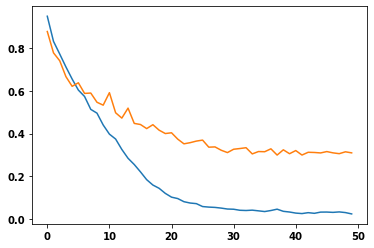

In [ ]:
history = model_conv1d.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=50,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.show()

Epoch 1/50
205/205 [==============================] - 5s 14ms/step - loss: 0.0127 - val_loss: 0.2872
Epoch 2/50
205/205 [==============================] - 3s 13ms/step - loss: 0.0073 - val_loss: 0.2850
Epoch 3/50
205/205 [==============================] - 3s 13ms/step - loss: 0.0052 - val_loss: 0.2825
Epoch 4/50
205/205 [==============================] - 2s 12ms/step - loss: 0.0040 - val_loss: 0.2815
Epoch 5/50
205/205 [==============================] - 3s 14ms/step - loss: 0.0033 - val_loss: 0.2822
Epoch 6/50
205/205 [==============================] - 2s 12ms/step - loss: 0.0027 - val_loss: 0.2834
Epoch 7/50
205/205 [==============================] - 2s 12ms/step - loss: 0.0023 - val_loss: 0.2815
Epoch 8/50
205/205 [==============================] - 3s 12ms/step - loss: 0.0019 - val_loss: 0.2827
Epoch 9/50
205/205 [==============================] - 2s 11ms/step - loss: 0.0017 - val_loss: 0.2820
Epoch 10/50
205/205 [==============================] - 3s 12ms/step - loss: 0.0015 - val_lo

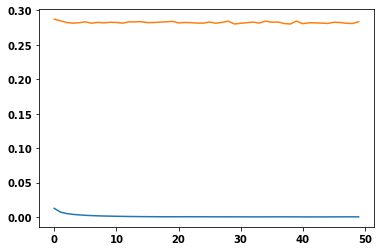

In [ ]:
history = model_conv1d.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=50,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.show()

In [ ]:
model_conv1d.save('/content/drive/MyDrive/dz/mod/conv1dmfcc2.h5')
model_conv1d.save_weights('/content/drive/MyDrive/dz/mod/conv1dMfccW2.h5')

In [ ]:
testToCheck

In [ ]:
pred = model_conv1d.predict(testToCheck)

In [ ]:
mse = np.mean(np.power(testToCheck[0] - pred[0], 2), axis=1) # определяем среднеквадратичную ошибку по X_test и предсказанием по X_test

In [ ]:
mse

array([2.9765346, 5.073584 , 3.0164437, 2.2823863, 5.14775  , 2.0126224,
       3.1661777, 2.354173 , 7.300257 , 5.211099 , 2.2686944, 2.2051487,
       3.513625 , 2.5439582, 2.1540036, 4.2510495, 2.7320266, 2.5267494,
       1.9891026, 2.819915 , 4.586357 , 2.76646  , 3.1137207, 4.3160048,
       2.1672077, 1.9878502, 2.2204752, 2.1383522, 3.4621131, 1.9977773,
       2.4047005, 3.4598503, 2.9489152, 2.8237503, 2.5352645, 7.9577856,
       5.5524435, 9.4332905, 5.3379707, 6.3188353], dtype=float32)

In [ ]:
cor = np.corr(testToCheck[0], )

# 2. autoencoder Conv1D based on MinMaxScaler

In [ ]:
xT = snd.reshape((-1, snd.shape[1], 1))
xT.shape

(231, 40, 1)

In [ ]:
input = Input(shape = (xT.shape[1], xT.shape[2]))

# encoder
x = Conv1D(40, 2, padding="same", activation="relu")(input)
x = MaxPooling1D(2)(x)
x = Conv1D(80, 2, padding="same", activation="relu")(x)
x = MaxPooling1D(2)(x)
x = Conv1D(160, 2, padding="same", activation="relu")(x)
x = MaxPooling1D(2)(x)

x = Conv1D(320, 2, padding="same", activation="relu")(x)

x = Conv1DTranspose(160, (2), strides=(2), padding='same', activation='relu')(x)
x = Conv1D(160, 2, padding="same", activation="relu")(x)
x = Conv1DTranspose(80, (2), strides=(2), padding='same', activation='relu')(x)
x = Conv1D(80, 2, padding="same", activation="relu")(x)
x = Conv1DTranspose(40, (2), strides=(2), padding='same', activation='relu')(x)
x = Conv1D(40, 2, padding="same", activation="relu")(x)
x = Conv1D(1, (2), padding='same', activation='linear')(x)
model_conv1d = Model(input, x)

In [ ]:
model_conv1d.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 40, 1)]           0         
                                                                 
 conv1d (Conv1D)             (None, 40, 40)            120       
                                                                 
 max_pooling1d (MaxPooling1D  (None, 20, 40)           0         
 )                                                               
                                                                 
 conv1d_1 (Conv1D)           (None, 20, 80)            6480      
                                                                 
 max_pooling1d_1 (MaxPooling  (None, 10, 80)           0         
 1D)                                                             
                                                                 
 conv1d_2 (Conv1D)           (None, 10, 160)           25760 

In [ ]:
model_conv1d.compile(optimizer=Adam(0.0001),
                  loss='mean_squared_error') # компилируем модель с оптимайзером Адам и среднеквадратичной ошибкой

In [ ]:
train_mask, val_mask = mask(snd) # create train and validation sets for autoencoder

Epoch 1/50
218/218 [==============================] - 6s 12ms/step - loss: 0.0402 - val_loss: 0.0369
Epoch 2/50
218/218 [==============================] - 2s 10ms/step - loss: 0.0311 - val_loss: 0.0351
Epoch 3/50
218/218 [==============================] - 2s 10ms/step - loss: 0.0283 - val_loss: 0.0334
Epoch 4/50
218/218 [==============================] - 2s 10ms/step - loss: 0.0266 - val_loss: 0.0303
Epoch 5/50
218/218 [==============================] - 2s 10ms/step - loss: 0.0248 - val_loss: 0.0283
Epoch 6/50
218/218 [==============================] - 2s 10ms/step - loss: 0.0227 - val_loss: 0.0267
Epoch 7/50
218/218 [==============================] - 2s 10ms/step - loss: 0.0211 - val_loss: 0.0246
Epoch 8/50
218/218 [==============================] - 2s 10ms/step - loss: 0.0199 - val_loss: 0.0254
Epoch 9/50
218/218 [==============================] - 1s 7ms/step - loss: 0.0189 - val_loss: 0.0234
Epoch 10/50
218/218 [==============================] - 1s 7ms/step - loss: 0.0178 - val_loss

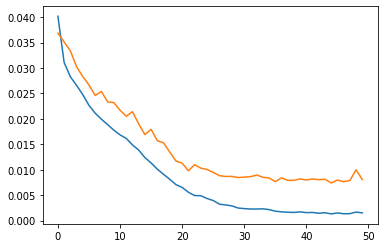

In [ ]:
history = model_conv1d.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=50,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.show()

Epoch 1/50
218/218 [==============================] - 3s 9ms/step - loss: 7.0839e-04 - val_loss: 0.0072
Epoch 2/50
218/218 [==============================] - 2s 7ms/step - loss: 4.2905e-04 - val_loss: 0.0072
Epoch 3/50
218/218 [==============================] - 2s 8ms/step - loss: 3.2551e-04 - val_loss: 0.0070
Epoch 4/50
218/218 [==============================] - 2s 7ms/step - loss: 2.6662e-04 - val_loss: 0.0070
Epoch 5/50
218/218 [==============================] - 2s 7ms/step - loss: 2.2651e-04 - val_loss: 0.0071
Epoch 6/50
218/218 [==============================] - 2s 7ms/step - loss: 1.9691e-04 - val_loss: 0.0071
Epoch 7/50
218/218 [==============================] - 2s 7ms/step - loss: 1.7321e-04 - val_loss: 0.0071
Epoch 8/50
218/218 [==============================] - 2s 7ms/step - loss: 1.5271e-04 - val_loss: 0.0072
Epoch 9/50
218/218 [==============================] - 2s 8ms/step - loss: 1.3654e-04 - val_loss: 0.0071
Epoch 10/50
218/218 [==============================] - 2s 7ms/st

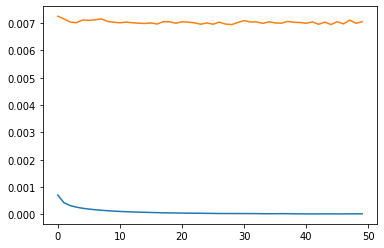

In [ ]:
history = model_conv1d.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=50,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.show()

In [ ]:
model_conv1d.save('/content/drive/MyDrive/dz/mod/conv1dmfcc.h5')
model_conv1d.save_weights('/content/drive/MyDrive/dz/mod/conv1dMfccW.h5')

In [ ]:
testToCheck

In [ ]:
pred = model_conv1d.predict(testToCheck)

In [ ]:
mse = np.mean(np.power(testToCheck[0] - pred[0], 2), axis=1) # определяем среднеквадратичную ошибку по X_test и предсказанием по X_test

In [ ]:
mse

array([2.9765346, 5.073584 , 3.0164437, 2.2823863, 5.14775  , 2.0126224,
       3.1661777, 2.354173 , 7.300257 , 5.211099 , 2.2686944, 2.2051487,
       3.513625 , 2.5439582, 2.1540036, 4.2510495, 2.7320266, 2.5267494,
       1.9891026, 2.819915 , 4.586357 , 2.76646  , 3.1137207, 4.3160048,
       2.1672077, 1.9878502, 2.2204752, 2.1383522, 3.4621131, 1.9977773,
       2.4047005, 3.4598503, 2.9489152, 2.8237503, 2.5352645, 7.9577856,
       5.5524435, 9.4332905, 5.3379707, 6.3188353], dtype=float32)

In [ ]:
cor = np.corr(testToCheck[0], )

In [ ]:
!git push origin main # перебрасываем изменения в репозиторий гит

Everything up-to-date


# 3. autoencoder Conv1D based on MinMaxScaler, nfft 255

In [73]:
xT = snd.reshape((-1, snd.shape[1], 1))
xT.shape

(454, 40, 1)

In [74]:
input = Input(shape = (xT.shape[1], xT.shape[2]))

# encoder
x = Conv1D(40, 2, padding="same", activation="relu")(input)
x = MaxPooling1D(2)(x)
x = Conv1D(80, 2, padding="same", activation="relu")(x)
x = MaxPooling1D(2)(x)
x = Conv1D(160, 2, padding="same", activation="relu")(x)
x = MaxPooling1D(2)(x)

x = Conv1D(320, 2, padding="same", activation="relu")(x)

x = Conv1DTranspose(160, (2), strides=(2), padding='same', activation='relu')(x)
x = Conv1D(160, 2, padding="same", activation="relu")(x)
x = Conv1DTranspose(80, (2), strides=(2), padding='same', activation='relu')(x)
x = Conv1D(80, 2, padding="same", activation="relu")(x)
x = Conv1DTranspose(40, (2), strides=(2), padding='same', activation='relu')(x)
x = Conv1D(40, 2, padding="same", activation="relu")(x)
x = Conv1D(1, (2), padding='same', activation='linear')(x)
model_conv1d = Model(input, x)

In [75]:
model_conv1d.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 40, 1)]           0         
                                                                 
 conv1d (Conv1D)             (None, 40, 40)            120       
                                                                 
 max_pooling1d (MaxPooling1D  (None, 20, 40)           0         
 )                                                               
                                                                 
 conv1d_1 (Conv1D)           (None, 20, 80)            6480      
                                                                 
 max_pooling1d_1 (MaxPooling  (None, 10, 80)           0         
 1D)                                                             
                                                                 
 conv1d_2 (Conv1D)           (None, 10, 160)           25760 

In [78]:
model_conv1d.compile(optimizer=Adam(0.0001),
                  loss='mean_squared_error') # компилируем модель с оптимайзером Адам и среднеквадратичной ошибкой

In [ ]:
train_mask, val_mask = mask(snd) # create train and validation sets for autoencoder

Epoch 1/50
415/415 [==============================] - 7s 10ms/step - loss: 0.0367 - val_loss: 0.0272
Epoch 2/50
415/415 [==============================] - 4s 10ms/step - loss: 0.0297 - val_loss: 0.0258
Epoch 3/50
415/415 [==============================] - 4s 9ms/step - loss: 0.0280 - val_loss: 0.0227
Epoch 4/50
415/415 [==============================] - 4s 10ms/step - loss: 0.0240 - val_loss: 0.0208
Epoch 5/50
415/415 [==============================] - 4s 10ms/step - loss: 0.0211 - val_loss: 0.0176
Epoch 6/50
415/415 [==============================] - 4s 10ms/step - loss: 0.0180 - val_loss: 0.0146
Epoch 7/50
415/415 [==============================] - 4s 10ms/step - loss: 0.0136 - val_loss: 0.0120
Epoch 8/50
415/415 [==============================] - 4s 9ms/step - loss: 0.0105 - val_loss: 0.0108
Epoch 9/50
415/415 [==============================] - 3s 6ms/step - loss: 0.0082 - val_loss: 0.0086
Epoch 10/50
415/415 [==============================] - 3s 6ms/step - loss: 0.0066 - val_loss: 

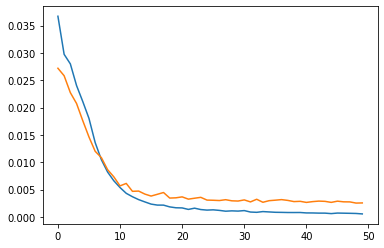

In [77]:
history = model_conv1d.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=50,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.show()

Epoch 1/10
415/415 [==============================] - 6s 11ms/step - loss: 2.5738e-04 - val_loss: 0.0022
Epoch 2/10
415/415 [==============================] - 4s 10ms/step - loss: 1.5837e-04 - val_loss: 0.0022
Epoch 3/10
415/415 [==============================] - 5s 12ms/step - loss: 1.2434e-04 - val_loss: 0.0022
Epoch 4/10
415/415 [==============================] - 5s 11ms/step - loss: 1.0548e-04 - val_loss: 0.0022
Epoch 5/10
415/415 [==============================] - 4s 10ms/step - loss: 9.2073e-05 - val_loss: 0.0022
Epoch 6/10
415/415 [==============================] - 5s 11ms/step - loss: 8.1382e-05 - val_loss: 0.0022
Epoch 7/10
415/415 [==============================] - 6s 14ms/step - loss: 7.3999e-05 - val_loss: 0.0022
Epoch 8/10
415/415 [==============================] - 4s 10ms/step - loss: 6.7439e-05 - val_loss: 0.0022
Epoch 9/10
415/415 [==============================] - 4s 10ms/step - loss: 6.1914e-05 - val_loss: 0.0022
Epoch 10/10
415/415 [==============================] - 

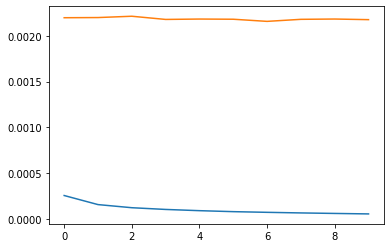

In [79]:
history = model_conv1d.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=10,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.show()

In [80]:
model_conv1d.save('/content/drive/MyDrive/dz/mod/conv1dmfcc_255.h5')
model_conv1d.save_weights('/content/drive/MyDrive/dz/mod/conv1dMfccW_255.h5')

# A. classification model Dense for mfcc based on StandartScaler

## simple Dense, mfcc 40

In [ ]:
model = Sequential()
model.add(Dense(256, activation='relu', input_shape=(x_train.shape[1],)))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))


In [ ]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_5 (Dense)             (None, 256)               10496     
                                                                 
 dense_6 (Dense)             (None, 128)               32896     
                                                                 
 dense_7 (Dense)             (None, 64)                8256      
                                                                 
 dense_8 (Dense)             (None, 32)                2080      
                                                                 
 dense_9 (Dense)             (None, 1)                 33        
                                                                 
Total params: 53,761
Trainable params: 53,761
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#Компилируем сеть
model.compile(optimizer=Adam(lr=0.0001),
              loss='binary_crossentropy',
              metrics=['accuracy'])

Epoch 1/5
9315/9315 [==============================] - 31s 3ms/step - loss: 0.1992 - accuracy: 0.9172 - val_loss: 0.1679 - val_accuracy: 0.9198
Epoch 2/5
9315/9315 [==============================] - 22s 2ms/step - loss: 0.1511 - accuracy: 0.9344 - val_loss: 0.1544 - val_accuracy: 0.9314
Epoch 3/5
9315/9315 [==============================] - 24s 3ms/step - loss: 0.1301 - accuracy: 0.9466 - val_loss: 0.1592 - val_accuracy: 0.9324
Epoch 4/5
9315/9315 [==============================] - 22s 2ms/step - loss: 0.1120 - accuracy: 0.9549 - val_loss: 0.1475 - val_accuracy: 0.9343
Epoch 5/5
9315/9315 [==============================] - 30s 3ms/step - loss: 0.0991 - accuracy: 0.9634 - val_loss: 0.2051 - val_accuracy: 0.9275


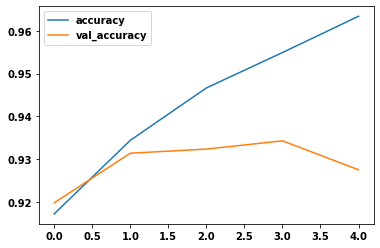

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

Epoch 1/5
9315/9315 [==============================] - 28s 3ms/step - loss: 0.0578 - accuracy: 0.9763 - val_loss: 0.2062 - val_accuracy: 0.9362
Epoch 2/5
9315/9315 [==============================] - 22s 2ms/step - loss: 0.0400 - accuracy: 0.9840 - val_loss: 0.2551 - val_accuracy: 0.9391
Epoch 3/5
9315/9315 [==============================] - 22s 2ms/step - loss: 0.0291 - accuracy: 0.9897 - val_loss: 0.3186 - val_accuracy: 0.9362
Epoch 4/5
9315/9315 [==============================] - 22s 2ms/step - loss: 0.0223 - accuracy: 0.9910 - val_loss: 0.3905 - val_accuracy: 0.9362
Epoch 5/5
9315/9315 [==============================] - 22s 2ms/step - loss: 0.0174 - accuracy: 0.9937 - val_loss: 0.5018 - val_accuracy: 0.9372


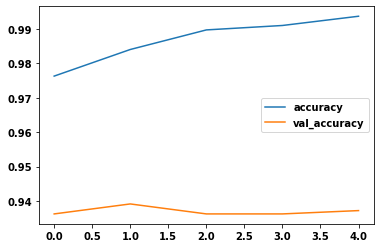

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

In [ ]:
model.save('/content/drive/MyDrive/dz/mod/model_raw_mfcc402.h5')
model.save_weights('/content/drive/MyDrive/dz/mod/model_raw_w_mfcc402.h5')

In [ ]:
model = load_model('/content/drive/MyDrive/dz/mod/model_raw_mfcc402.h5', compile = False)

In [ ]:
model.compile(optimizer=Adam(0.0001), loss='mean_squared_error') 

### how predicted xTrain correspond to true yTrain

In [ ]:
yPred = model.predict(train) # to predict of train data

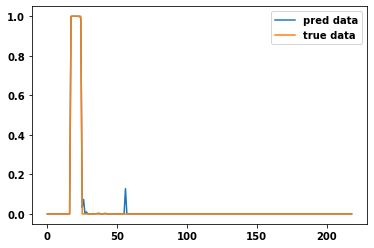

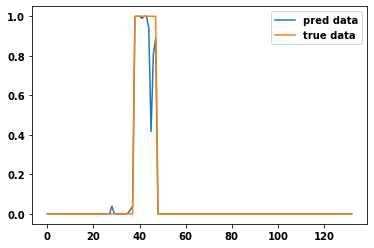

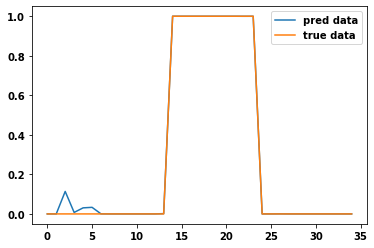

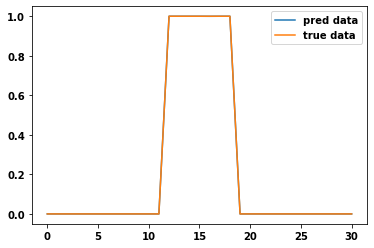

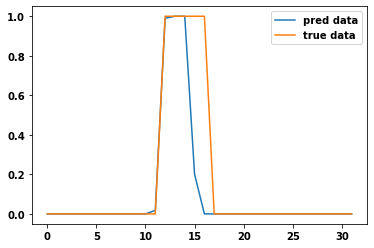

...

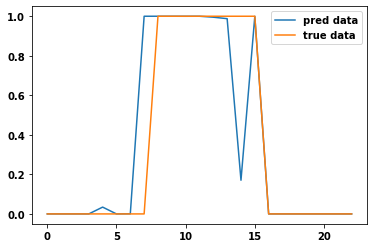

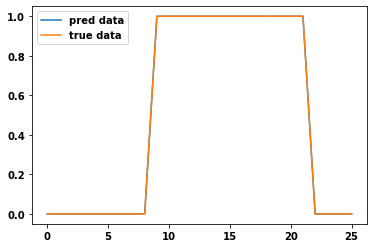

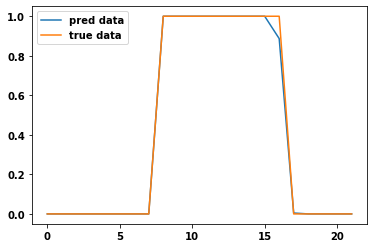

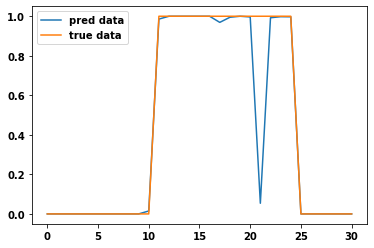

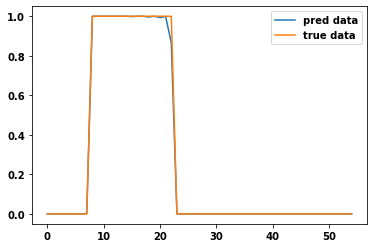

In [ ]:
plotCompare(yLittle, yPred, lstOfTime)

### how predicted xTest correspond to true yTest

In [ ]:
yPred = model.predict(test) # to predict of train data


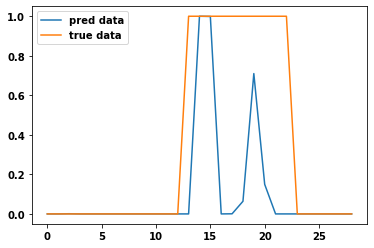

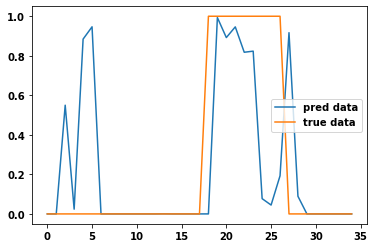

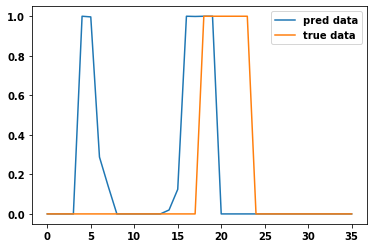

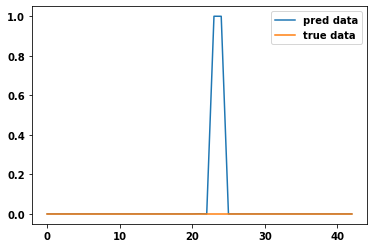

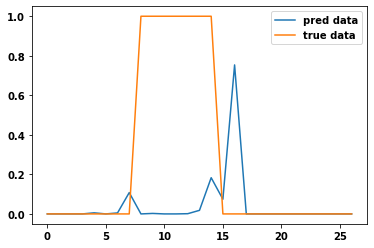

...

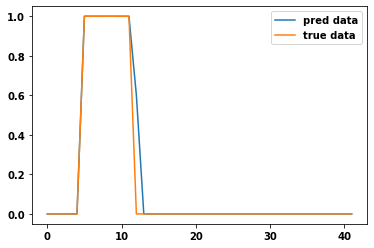

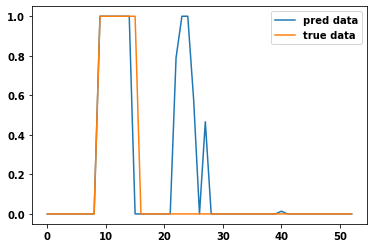

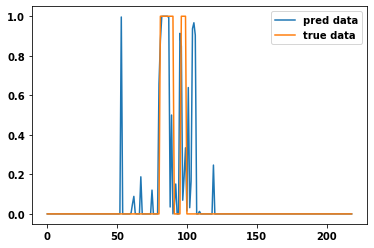

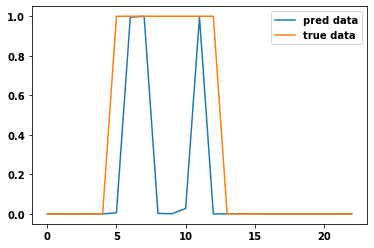

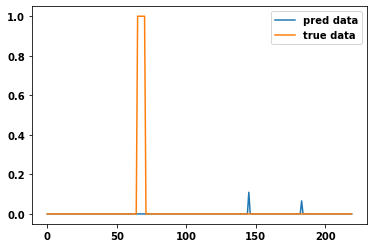

In [ ]:
plotCompare(yLittleTest, yPred, lstOfTime_test)

In [ ]:
model.evaluate(test, yLittleTest)

64/64 [==============================] - 0s 2ms/step - loss: 1.8275 - accuracy: 0.8842


[1.827467441558838, 0.8842208385467529]

# B. classification model Dense for mfcc based on MinMaxScaler

## simple Dense, mfcc 40

In [ ]:
model = Sequential()
model.add(Dense(256, activation='relu', input_shape=(x_train.shape[1],)))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))


In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               10496     
                                                                 
 dense_1 (Dense)             (None, 128)               32896     
                                                                 
 dense_2 (Dense)             (None, 64)                8256      
                                                                 
 dense_3 (Dense)             (None, 32)                2080      
                                                                 
 dense_4 (Dense)             (None, 1)                 33        
                                                                 
Total params: 53,761
Trainable params: 53,761
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#Компилируем сеть
model.compile(optimizer=Adam(lr=0.00001),
              loss='binary_crossentropy',
              metrics=['accuracy'])

Epoch 1/5
9315/9315 [==============================] - 25s 3ms/step - loss: 0.2276 - accuracy: 0.8984 - val_loss: 0.2055 - val_accuracy: 0.9092
Epoch 2/5
9315/9315 [==============================] - 20s 2ms/step - loss: 0.2000 - accuracy: 0.9052 - val_loss: 0.1805 - val_accuracy: 0.9082
Epoch 3/5
9315/9315 [==============================] - 20s 2ms/step - loss: 0.1939 - accuracy: 0.9080 - val_loss: 0.1910 - val_accuracy: 0.9034
Epoch 4/5
9315/9315 [==============================] - 19s 2ms/step - loss: 0.1932 - accuracy: 0.9122 - val_loss: 0.1931 - val_accuracy: 0.9140
Epoch 5/5
9315/9315 [==============================] - 19s 2ms/step - loss: 0.1891 - accuracy: 0.9091 - val_loss: 0.1748 - val_accuracy: 0.9208


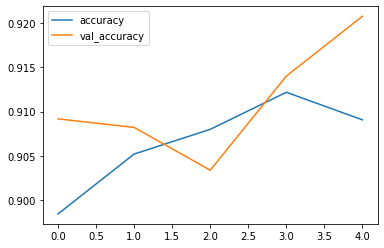

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

Epoch 1/5
9315/9315 [==============================] - 31s 3ms/step - loss: 0.1679 - accuracy: 0.9258 - val_loss: 0.1721 - val_accuracy: 0.9237
Epoch 2/5
9315/9315 [==============================] - 20s 2ms/step - loss: 0.1671 - accuracy: 0.9259 - val_loss: 0.1732 - val_accuracy: 0.9217
Epoch 3/5
9315/9315 [==============================] - 20s 2ms/step - loss: 0.1676 - accuracy: 0.9261 - val_loss: 0.1722 - val_accuracy: 0.9208
Epoch 4/5
9315/9315 [==============================] - 20s 2ms/step - loss: 0.1671 - accuracy: 0.9260 - val_loss: 0.1710 - val_accuracy: 0.9227
Epoch 5/5
9315/9315 [==============================] - 32s 3ms/step - loss: 0.1668 - accuracy: 0.9259 - val_loss: 0.1710 - val_accuracy: 0.9227


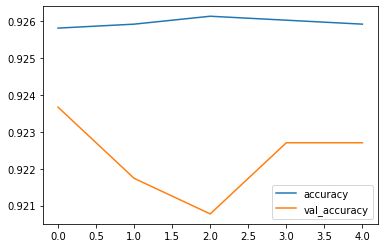

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

In [ ]:
model.save('/content/drive/MyDrive/dz/mod/model_raw_mfcc40.h5')
model.save_weights('/content/drive/MyDrive/dz/mod/model_raw_w_mfcc40.h5')

In [ ]:
model = load_model('/content/drive/MyDrive/dz/mod/model_raw_mfcc40.h5', compile = False)

In [ ]:
model.compile(optimizer=Adam(0.0001), loss='mean_squared_error') 

### how predicted xTrain correspond to true yTrain

In [ ]:
yPred = model.predict(train) # to predict of train data

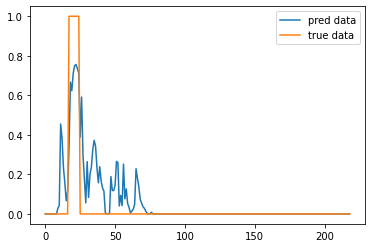

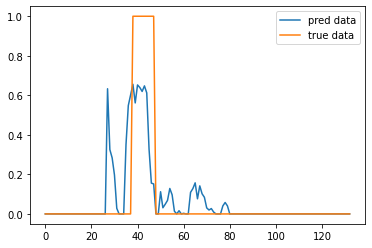

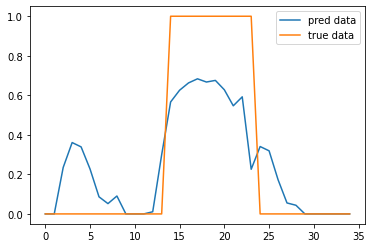

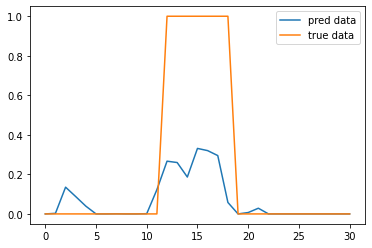

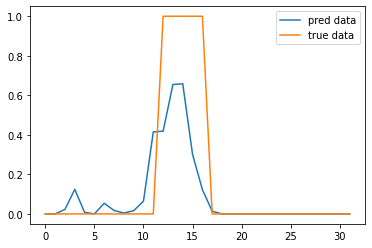

...

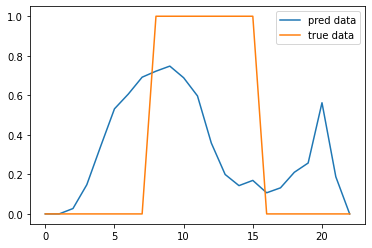

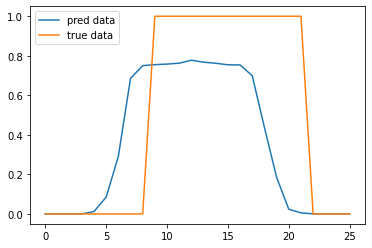

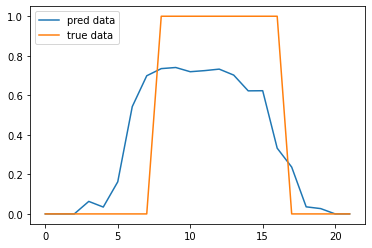

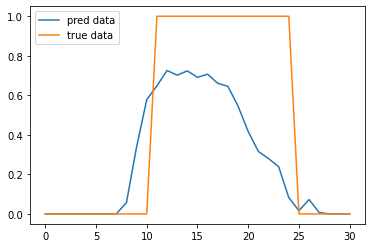

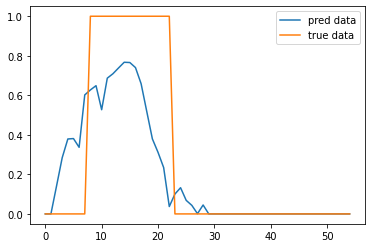

In [ ]:
plotCompare(yLittle, yPred, lstOfTime)

### how predicted xTest correspond to true yTest

In [ ]:
yPred = model.predict(test) # to predict of train data

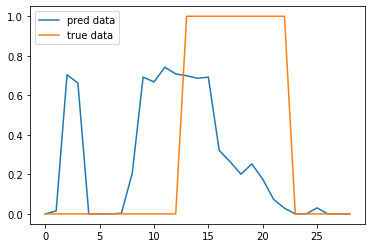

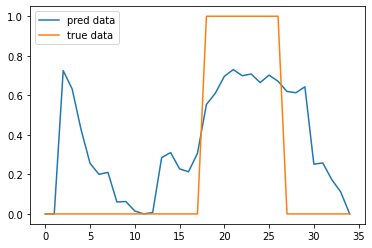

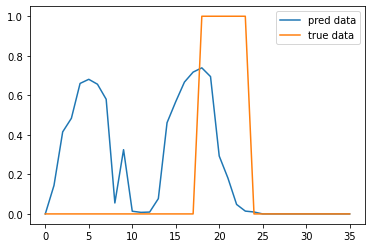

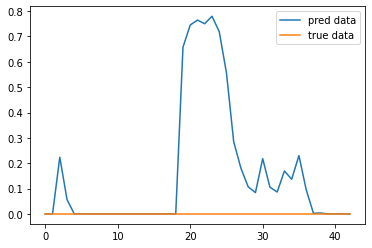

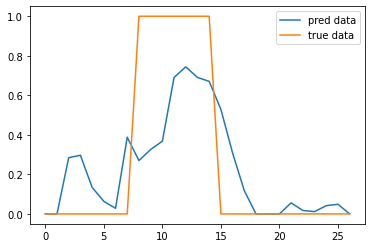

...

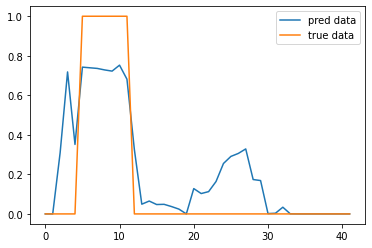

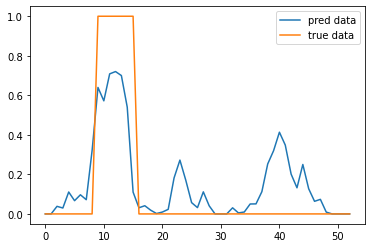

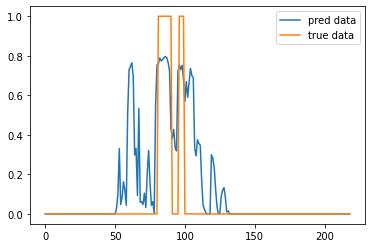

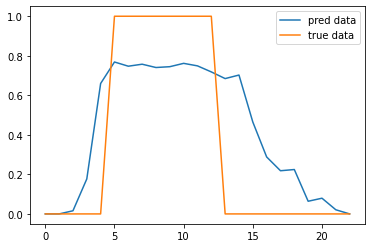

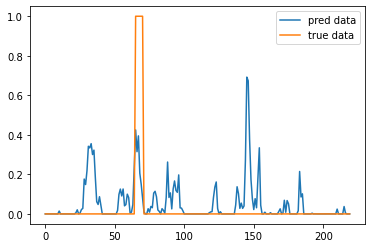

In [ ]:
plotCompare(yLittleTest, yPred, lstOfTime_test)

In [ ]:
model.evaluate(test, yLittleTest)

64/64 [==============================] - 0s 4ms/step - loss: 0.2521 - accuracy: 0.8857


[0.2521151006221771, 0.8856863975524902]

## train set that pretrained by autoencoder

In [ ]:
model_conv1d = load_model('/content/drive/MyDrive/dz/mod/conv1dmfcc.h5', compile = True)

In [ ]:
# to normalize a xTrain
train = scalMM(X_train_mfcc_i)

In [ ]:
trained = model_conv1d.predict(train)

In [ ]:
# splitting
x_train, x_test, y_train, y_test = train_test_split(trained, yLittle, test_size=0.1)
print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(9315, 40, 1)
(1035, 40, 1)
(9315,)
(1035,)


In [ ]:
model = Sequential()
model.add(Dense(256, activation='relu', input_shape=(x_train.shape[1],)))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))


In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               10496     
                                                                 
 dense_1 (Dense)             (None, 128)               32896     
                                                                 
 dense_2 (Dense)             (None, 64)                8256      
                                                                 
 dense_3 (Dense)             (None, 32)                2080      
                                                                 
 dense_4 (Dense)             (None, 1)                 33        
                                                                 
Total params: 53,761
Trainable params: 53,761
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#Компилируем сеть
model.compile(optimizer=Adam(lr=0.0001),
              loss='binary_crossentropy',
              metrics=['accuracy'])

Epoch 1/5
9315/9315 [==============================] - 29s 3ms/step - loss: 0.2387 - accuracy: 0.9002 - val_loss: 0.2383 - val_accuracy: 0.8899
Epoch 2/5
9315/9315 [==============================] - 28s 3ms/step - loss: 0.2095 - accuracy: 0.9090 - val_loss: 0.2218 - val_accuracy: 0.8937
Epoch 3/5
9315/9315 [==============================] - 30s 3ms/step - loss: 0.2070 - accuracy: 0.9095 - val_loss: 0.1803 - val_accuracy: 0.9237
Epoch 4/5
9315/9315 [==============================] - 25s 3ms/step - loss: 0.2032 - accuracy: 0.9101 - val_loss: 0.2277 - val_accuracy: 0.9285
Epoch 5/5
9315/9315 [==============================] - 27s 3ms/step - loss: 0.2005 - accuracy: 0.9125 - val_loss: 0.1981 - val_accuracy: 0.9169


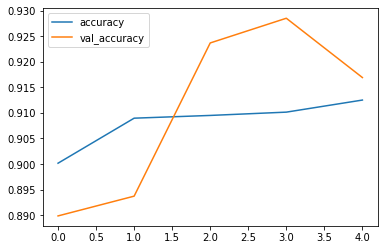

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

Epoch 1/5
9315/9315 [==============================] - 28s 3ms/step - loss: 0.1851 - accuracy: 0.9176 - val_loss: 0.1777 - val_accuracy: 0.9275
Epoch 2/5
9315/9315 [==============================] - 17s 2ms/step - loss: 0.1834 - accuracy: 0.9192 - val_loss: 0.1773 - val_accuracy: 0.9295
Epoch 3/5
9315/9315 [==============================] - 26s 3ms/step - loss: 0.1831 - accuracy: 0.9193 - val_loss: 0.1777 - val_accuracy: 0.9285
Epoch 4/5
9315/9315 [==============================] - 26s 3ms/step - loss: 0.1829 - accuracy: 0.9195 - val_loss: 0.1771 - val_accuracy: 0.9285
Epoch 5/5
9315/9315 [==============================] - 17s 2ms/step - loss: 0.1831 - accuracy: 0.9187 - val_loss: 0.1774 - val_accuracy: 0.9285


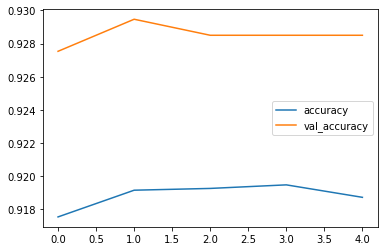

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

In [ ]:
model.save('/content/drive/MyDrive/dz/mod/model_raw_mfcc40_pretrain.h5')
model.save_weights('/content/drive/MyDrive/dz/mod/model_raw_w_mfcc40_pretrain.h5')

### how predicted xTest correspond to true yTest

In [ ]:
tested = model_conv1d.predict(test)

In [ ]:
yPred_at = model.predict(tested) # to predict of test data

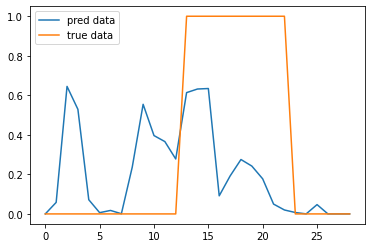

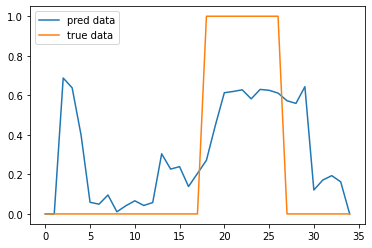

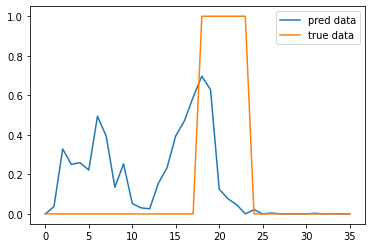

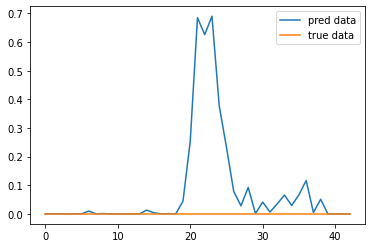

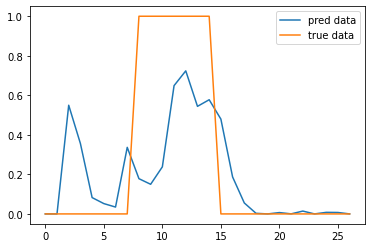

...

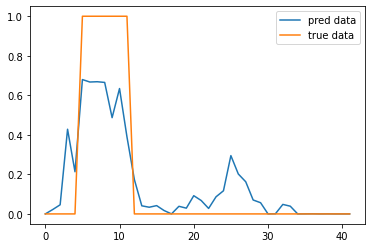

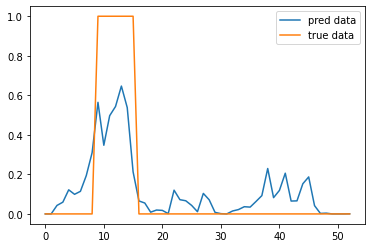

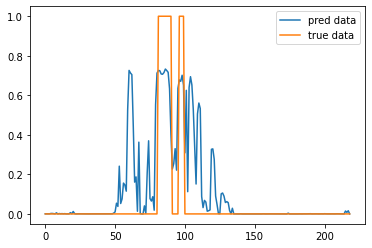

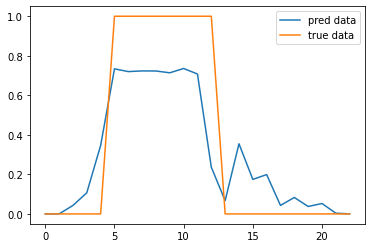

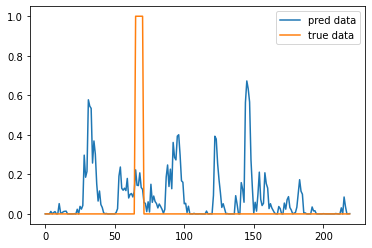

In [ ]:
plotCompare(yLittleTest, yPred_at, lstOfTime_test)

In [ ]:
model.evaluate(tested, yLittleTest)

64/64 [==============================] - 0s 2ms/step - loss: 0.2635 - accuracy: 0.8911


[0.2635090947151184, 0.8910601139068604]

# C. classification model Dense for mfcc based on MinMaxScaler, nfft 255

## simple Dense, mfcc 40

In [81]:
model = Sequential()
model.add(Dense(256, activation='relu', input_shape=(x_train.shape[1],)))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))


In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               10496     
                                                                 
 dense_1 (Dense)             (None, 128)               32896     
                                                                 
 dense_2 (Dense)             (None, 64)                8256      
                                                                 
 dense_3 (Dense)             (None, 32)                2080      
                                                                 
 dense_4 (Dense)             (None, 1)                 33        
                                                                 
Total params: 53,761
Trainable params: 53,761
Non-trainable params: 0
_________________________________________________________________


In [85]:
#Компилируем сеть
model.compile(optimizer=Adam(lr=0.0001),
              loss='binary_crossentropy',
              metrics=['accuracy'])

Epoch 1/5
18604/18604 [==============================] - 48s 3ms/step - loss: 0.2195 - accuracy: 0.9004 - val_loss: 0.1785 - val_accuracy: 0.9091
Epoch 2/5
18604/18604 [==============================] - 65s 3ms/step - loss: 0.2016 - accuracy: 0.9046 - val_loss: 0.1797 - val_accuracy: 0.9086
Epoch 3/5
18604/18604 [==============================] - 54s 3ms/step - loss: 0.1958 - accuracy: 0.9085 - val_loss: 0.1929 - val_accuracy: 0.9105
Epoch 4/5
18604/18604 [==============================] - 41s 2ms/step - loss: 0.1960 - accuracy: 0.9086 - val_loss: 0.2114 - val_accuracy: 0.9086
Epoch 5/5
18604/18604 [==============================] - 39s 2ms/step - loss: 0.1930 - accuracy: 0.9103 - val_loss: 0.1725 - val_accuracy: 0.9159


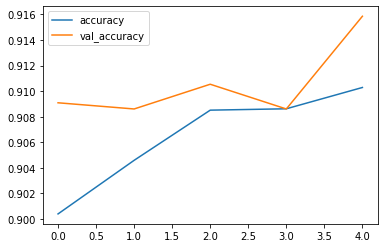

In [83]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

Epoch 1/5
18604/18604 [==============================] - 44s 2ms/step - loss: 0.1810 - accuracy: 0.9150 - val_loss: 0.1718 - val_accuracy: 0.9149
Epoch 2/5
18604/18604 [==============================] - 42s 2ms/step - loss: 0.1801 - accuracy: 0.9171 - val_loss: 0.1701 - val_accuracy: 0.9168
Epoch 3/5
18604/18604 [==============================] - 40s 2ms/step - loss: 0.1800 - accuracy: 0.9186 - val_loss: 0.1722 - val_accuracy: 0.9149
Epoch 4/5
18604/18604 [==============================] - 38s 2ms/step - loss: 0.1793 - accuracy: 0.9181 - val_loss: 0.1705 - val_accuracy: 0.9192
Epoch 5/5
18604/18604 [==============================] - 39s 2ms/step - loss: 0.1797 - accuracy: 0.9173 - val_loss: 0.1698 - val_accuracy: 0.9168


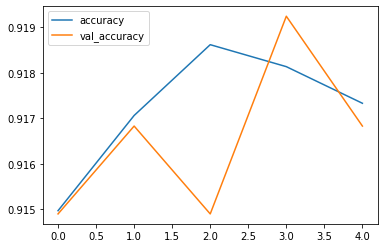

In [86]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

In [87]:
model.save('/content/drive/MyDrive/dz/mod/model_raw_mfcc40_255.h5')
model.save_weights('/content/drive/MyDrive/dz/mod/model_raw_w_mfcc40_255.h5')

### how predicted xTrain correspond to true yTrain

In [88]:
yPred = model.predict(train) # to predict of train data

In [89]:
plotCompare(yLittle, yPred, lstOfTime)

Output hidden; open in https://colab.research.google.com to view.

### how predicted xTest correspond to true yTest

In [90]:
yPred = model.predict(test) # to predict of train data

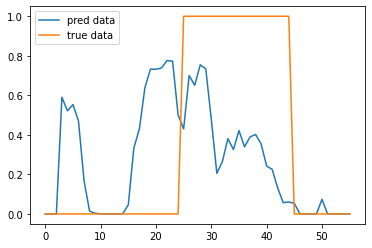

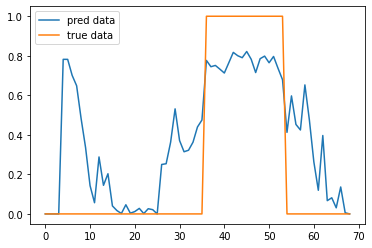

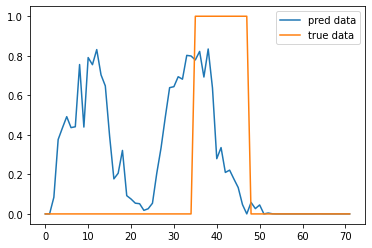

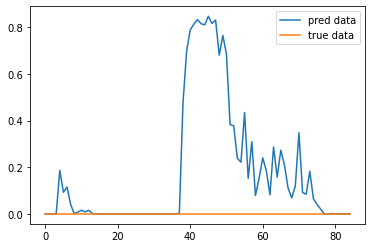

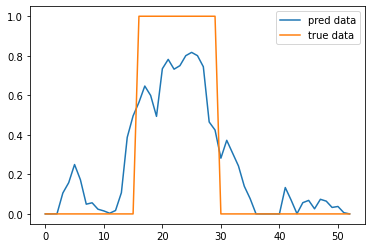

...

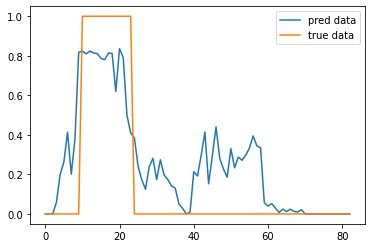

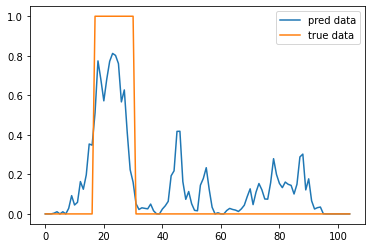

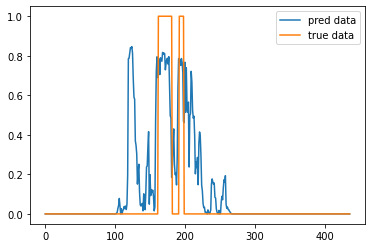

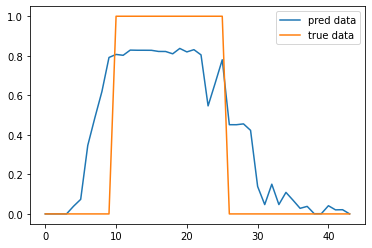

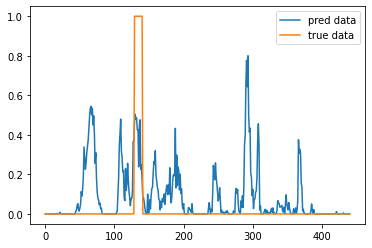

In [91]:
plotCompare(yLittleTest, yPred, lstOfTime_test)

In [93]:
model.evaluate(test, yLittleTest)

128/128 [==============================] - 0s 2ms/step - loss: 0.2378 - accuracy: 0.8914


[0.23784686625003815, 0.8914160132408142]

## train set that pretrained by autoencoder

In [ ]:
model_conv1d = load_model('/content/drive/MyDrive/dz/mod/conv1dmfcc.h5', compile = True)

In [ ]:
# to normalize a xTrain
train = scalMM(X_train_mfcc_i)

In [ ]:
trained = model_conv1d.predict(train)

In [ ]:
# splitting
x_train, x_test, y_train, y_test = train_test_split(trained, yLittle, test_size=0.1)
print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(9315, 40, 1)
(1035, 40, 1)
(9315,)
(1035,)


In [ ]:
model = Sequential()
model.add(Dense(256, activation='relu', input_shape=(x_train.shape[1],)))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))


In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               10496     
                                                                 
 dense_1 (Dense)             (None, 128)               32896     
                                                                 
 dense_2 (Dense)             (None, 64)                8256      
                                                                 
 dense_3 (Dense)             (None, 32)                2080      
                                                                 
 dense_4 (Dense)             (None, 1)                 33        
                                                                 
Total params: 53,761
Trainable params: 53,761
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#Компилируем сеть
model.compile(optimizer=Adam(lr=0.0001),
              loss='binary_crossentropy',
              metrics=['accuracy'])

Epoch 1/5
9315/9315 [==============================] - 29s 3ms/step - loss: 0.2387 - accuracy: 0.9002 - val_loss: 0.2383 - val_accuracy: 0.8899
Epoch 2/5
9315/9315 [==============================] - 28s 3ms/step - loss: 0.2095 - accuracy: 0.9090 - val_loss: 0.2218 - val_accuracy: 0.8937
Epoch 3/5
9315/9315 [==============================] - 30s 3ms/step - loss: 0.2070 - accuracy: 0.9095 - val_loss: 0.1803 - val_accuracy: 0.9237
Epoch 4/5
9315/9315 [==============================] - 25s 3ms/step - loss: 0.2032 - accuracy: 0.9101 - val_loss: 0.2277 - val_accuracy: 0.9285
Epoch 5/5
9315/9315 [==============================] - 27s 3ms/step - loss: 0.2005 - accuracy: 0.9125 - val_loss: 0.1981 - val_accuracy: 0.9169


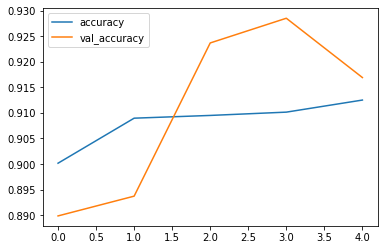

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

Epoch 1/5
9315/9315 [==============================] - 28s 3ms/step - loss: 0.1851 - accuracy: 0.9176 - val_loss: 0.1777 - val_accuracy: 0.9275
Epoch 2/5
9315/9315 [==============================] - 17s 2ms/step - loss: 0.1834 - accuracy: 0.9192 - val_loss: 0.1773 - val_accuracy: 0.9295
Epoch 3/5
9315/9315 [==============================] - 26s 3ms/step - loss: 0.1831 - accuracy: 0.9193 - val_loss: 0.1777 - val_accuracy: 0.9285
Epoch 4/5
9315/9315 [==============================] - 26s 3ms/step - loss: 0.1829 - accuracy: 0.9195 - val_loss: 0.1771 - val_accuracy: 0.9285
Epoch 5/5
9315/9315 [==============================] - 17s 2ms/step - loss: 0.1831 - accuracy: 0.9187 - val_loss: 0.1774 - val_accuracy: 0.9285


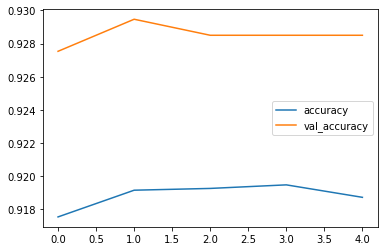

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

In [ ]:
model.save('/content/drive/MyDrive/dz/mod/model_raw_mfcc40_pretrain_255.h5')
model.save_weights('/content/drive/MyDrive/dz/mod/model_raw_w_mfcc40_pretrain_255.h5')

### how predicted xTest correspond to true yTest

In [ ]:
tested = model_conv1d.predict(test)

In [ ]:
yPred_at = model.predict(tested) # to predict of test data

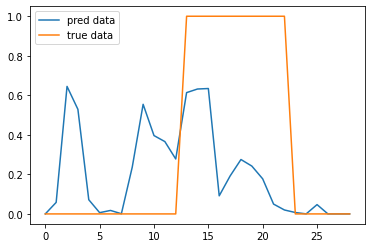

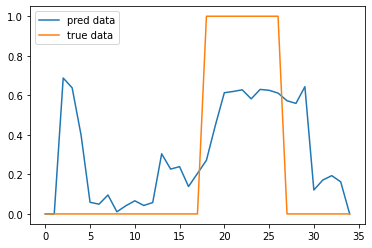

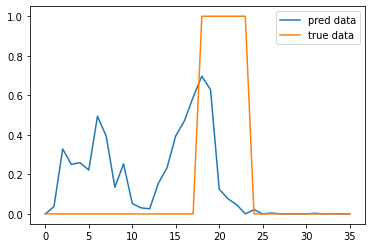

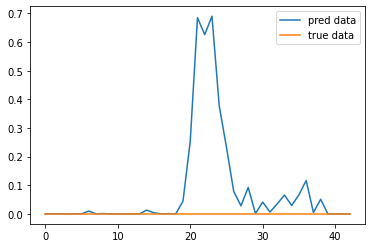

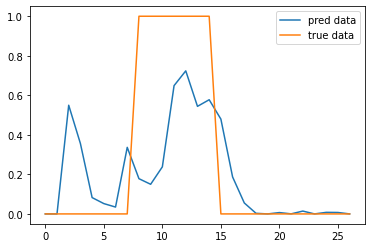

...

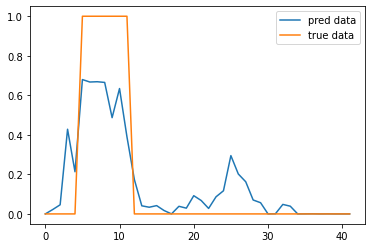

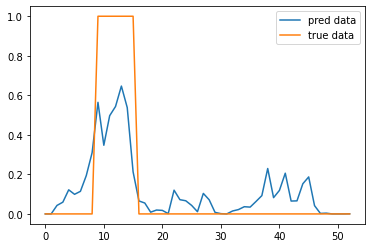

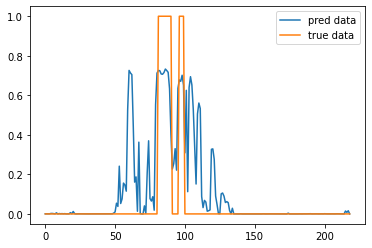

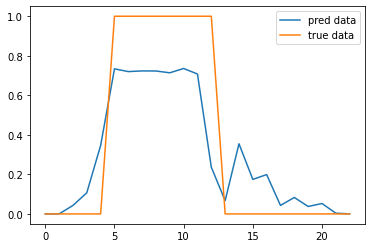

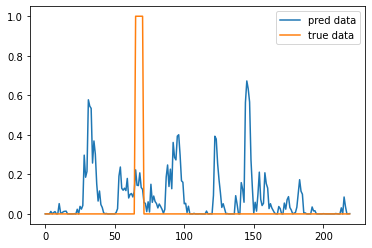

In [ ]:
plotCompare(yLittleTest, yPred_at, lstOfTime_test)

In [ ]:
model.evaluate(tested, yLittleTest)

64/64 [==============================] - 0s 2ms/step - loss: 0.2635 - accuracy: 0.8911


[0.2635090947151184, 0.8910601139068604]

# visualize recognized sounds and evaluate errors in a classificator based on StandartScaler

In [ ]:
model_conv1d = load_model('/content/drive/MyDrive/dz/mod/conv1dmfcc2.h5', compile = True)

In [ ]:
model = load_model('/content/drive/MyDrive/dz/mod/model_raw_mfcc402.h5', compile = True)

In [ ]:
#model.compile(optimizer=Adam(0.0001), loss='mean_squared_error') 

Получаем предсказание вероятностей, где расположены целевые звуки

In [ ]:
# to normalize a xTest
test = scal(X_test_mfcc_i)

In [ ]:
yPred = model.predict(test) # to predict of test data

In [ ]:
#np.save('/content/drive/MyDrive/dz/pronounce/yPred.npy', yPred)
#np.save('/content/drive/MyDrive/dz/pronounce/yPred_au.npy', yPred)

In [ ]:
yPred[:28]

array([[3.1920459e-18],
       [1.6446975e-08],
       [9.9388951e-01],
       [3.0563322e-01],
       [1.4626423e-07],
       [7.7620476e-05],
       [1.2318480e-07],
       [2.8066024e-06],
       [8.2492443e-06],
       [4.9969375e-02],
       [9.4806433e-01],
       [2.8497630e-01],
       [3.7939548e-03],
       [5.0747991e-03],
       [1.2870371e-01],
       [7.2129452e-01],
       [2.9557049e-01],
       [7.9445028e-01],
       [2.3096502e-03],
       [1.1991614e-01],
       [1.4173806e-05],
       [1.3913904e-05],
       [2.4236294e-06],
       [5.4042772e-08],
       [9.2254290e-08],
       [2.2955093e-07],
       [1.2618724e-09],
       [3.1920459e-18]], dtype=float32)

In [ ]:
# yPred without preparing
yPred = np.load('/content/drive/MyDrive/dz/pronounce/yPred.npy')

Создаём вектор, по которому будем отслеживать начало и конец распознанных звуков

In [ ]:
# take a 0-1 form from yPred and choose probability than merge true or false recognized sounds
merges = recognizeMerges(yPred, 0.2)

In [ ]:
#first track and recognized sounds when we see 1
merges[:28]

array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [1.],
       [1.],
       [0.],
       [0.],
       [0.],
       [1.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.]], dtype=float32)

In [ ]:
# correct of oneLst from recognizeMerges(yPred) (maybe only for a long sounds but not for [d], [t] etc)
oneLst = fillOnes(merges)

Смотрим ошибку распознавания звуков

In [ ]:
err, errL = summaError(yLittleTest, oneLst, lstOfTime_test)

realy true recognized sounds: 99
recognized like true, but is false sounds: 91
recognized like false, but is true sounds: 157
realy false recognized souns: 1700
Word Recognition Rate (to differ sounds by no-sounds): 87.88 %
Word Error Rate (to differ no-sounds by sounds): 12.12 %
Accuracy (how model find a sounds): 0.52
Fullness (how model find a no-sounds): 0.39
Harmonical mean: 0.44


In [ ]:
cm = confusion_matrix(yLittleTest, oneLst)
print(cm)

[[1700   91]
 [ 157   99]]


findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.
findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


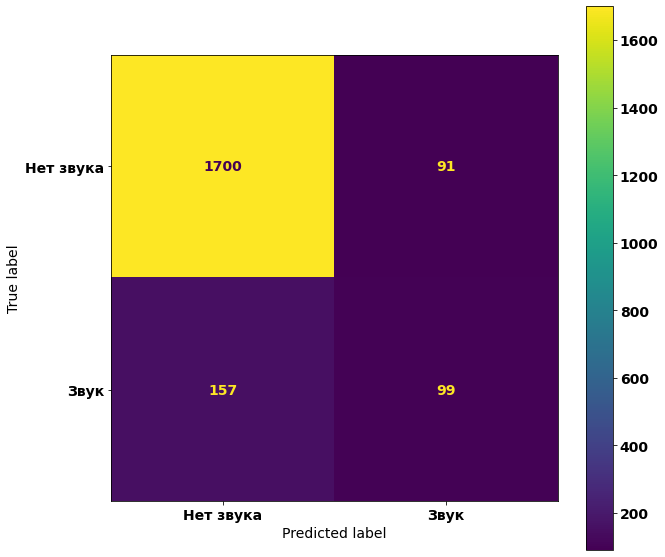

In [ ]:
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels = ['Нет звука', 'Звук'])
fig, ax = plt.subplots(figsize=(10,10))
disp.plot(ax = ax)
plt.rcParams.update({'font.size': 16})
plt.show()

Сопоставляем вероятности, начало и конец распознанных звуков относительно начала треков в тестовой выборке

In [ ]:
tracks = get_track(audio_test) # получаем номера треков

In [ ]:
kum_sum = kum_sum_range(lstOfTime_test) # получаем метки начала и конца треков относительно общей длины

In [ ]:
kum_sum

In [ ]:
# получаем вероятности, средние вероятности, границы выделенных звуков относительно начала трека и номера треков
prob_y, prob_mean_y, indexes_by_tracks, indexes_by_start, numbers, quantities = recognizeProb(yPred, oneLst, tracks, kum_sum)

отфильтровываем целевые звуки и посылаем их на обработку автоэнкодером для того, чтобы определить точность звуков. После отправляем снова на класификатор - чтобы получить вероятности.

In [ ]:
# пример границ предсказанного сетью звука
indexes_by_start[0]

array([1022, 1533])

In [ ]:
# take a fragments of xTest what net recognize as a goal-sounds for giving to autoencoder
testToCheck = toCheck(test, indexes_by_start)

In [ ]:
# получаем чистоту звука - посылаем xTest на автоэнкодер,
# а потом - чтобы получить вероятности - снова на классификатор
clarity_of_sounds = model.predict(model_conv1d.predict(testToCheck))

Суммируем вероятности относительно количества единиц 

In [ ]:
# получаем просуммированные по длине распознанных звуков вероятности после автоэнкодера
clarity_numbers = check_to_numbers(clarity_of_sounds, quantities)

представляем в виде таблицы

In [ ]:
db = pd.DataFrame()
db['Track'] = numbers
db['Start and Stop'] = indexes_by_tracks
db['Probability, %'] = np.around(prob_mean_y, 4) * 100
db['After au, %'] = np.around(scalMM(clarity_numbers), 2) * 100
db['Difference, %'] = (scalMM(clarity_numbers) - prob_mean_y) * 100
db['Mean, %'] = np.around((scalMM(clarity_numbers) + prob_mean_y)/2, 4) * 100

In [ ]:
db.head(20)

,Track,Start and Stop,"Probability, %","After au, %","Difference, %","Mean, %"
0,0,"[7154, 7665]",99.940002,1.0,-98.868988,50.510002
1,0,"[9709, 10220]",71.000000,9.0,-62.403858,39.789997
2,1,"[1022, 1533]",54.989998,0.0,-54.994320,27.500000
3,1,"[2044, 2555]",91.540001,0.0,-91.543907,45.770000
4,1,"[9709, 11753]",89.459999,0.0,-89.458626,44.730000
5,1,"[13797, 14308]",91.689995,0.0,-91.685257,45.840000
6,2,"[2044, 3066]",76.150002,1.0,-75.596451,38.350002
7,2,"[8176, 9709]",99.970001,1.0,-98.679695,50.629997
8,3,"[11753, 12264]",99.989998,0.0,-99.990181,50.000000
9,4,"[8176, 8687]",75.379997,0.0,-75.377213,37.689999


Смотрим, какие звуки распознала сеть и как именно

In [ ]:
# выбираем первый трек:
db[db['Track'] == 5]

,Track,Start and Stop,"Probability, %","After au, %","Difference, %","Mean, %"
13,5,"[1533, 2044]",31.779999,0.0,-31.784630,15.889999
14,5,"[4088, 9709]",55.779999,24.0,-31.292105,40.139999
15,5,"[10731, 11242]",27.559999,10.0,-17.742064,18.690001
16,5,"[12775, 13286]",31.380001,8.0,-23.506598,19.629999
17,5,"[13797, 14308]",45.739998,4.0,-41.768185,24.850000


In [ ]:
# enter number of the track
# enter start and end of recognized sound
getPlayer(7, 13000, 16000, audio_test)

In [ ]:
# 1 - автоэнкодер дал максимум, целевой звук именно здесь
# 7 - автоэнкодер не поддержал, классификатор распознал по максимуму. По среднему значению совпадает.
# 8 - типичный пример, когда классификатор распознал только одну из гласных дифтонга; здесь действительно нет целевого звука.
# 9 - классификатор распознал так себе, автоэнкодер не поддержал. Звук [аi] есть. Диктор прочла звук со странным призвуком в конце.
# 10 - классификатор распознал, автоэнкодер не поддержал. Диктор прочёл дифтонг напевно, растянул. Возможно, с этим связано
# 11,12 - явная ошибка, оба - за, а звук вообще не тот.
# 13 - классификатор определил правильно, но автокодировщик даёт "акцент"
# 14, 15 - один и тот же звук; наибольшая вероятность соответствовала целевому звуку; вероятность после автоэнкодера выше. В среднем оба выиграли.
# 18 - вероятность классификатора ниже, но вероятность автоэнкодера больше, и это целевой звук, хотя границы очень узкие. Плохое произношение?
# 19 - снова мужской голос, автоэнкодер показал 0
# 23 - показал максимум и вероятности классификатора, и автоэнкодера; женский голос
# 26 - звук обрезан, но показал небольшую вероятность автоэнкодер; женский голос; плохое произношение?
# 27 - максимум по классификатору, нет по автоэнкодеру. Женский голос; плохое произношение?
# 29 - второй максимум классификатора; явная ошибка. Автоэнкодер 0.
# 30 - максимум классификатора, но звук невнятный. Автоэнкодер молодец. Мужской голос.
# 32 - второй максимум классификатора. Автоэнкодер не поддержал. Правильно не поддержал. Мужской голос.
# 33 - идеальное распознавание. Автоэнкодер дал 4. Мужской голос.
# 37, 41 - максимумы классификатора. Это звук [а] и какая-то ерунда. Автоэнкодер не поддержал, молодец.
# 44 - не распознал звук ни классификатор, ни автоэнкодер.
# 46 - классификатор не распознал, а автоэнкодер дал максимум, и это как раз в точку. 
# 47 - классификатор распознал, автоэнкодер не поддержал. Плохое произношение?
# 49 - оба распознали, оба ошиблись.
# 50, 51 - распознали один и тот же звук
# 56 - не распознали звук
# 58 - не распознали звук
# 60, 61 - один и тот же звук; автоэнкодер дал небольшую вероятность
# 63, 64 - один и тот же звук; автоэнкодер дал вероятность
# 66 - классификатор распознал, автоэнкодер не поддержал. Звук звучит нечётко, глухо
# 67 - оба распознали, автоэнкодер говорит, что звук "не чистый"
# 68, 69 - один и тот же звук; автоэнкодер не поддержал. Голос мужской. 
# 70 - оба в точку; голос мужской
# 71, 72 - высокий автоэнкодер, низкий классификатор; ошибка распознания
# 73, 74 - один и тот же звук. Большая вероятность у автоэнкодера.
# 75 - вероятность кодировщика больше 0,5, вероятность автоэнкодера высокая. Правильный звук.
# 80 - классификатор распознал идеально, автоэнкодер не поддержал.
# 81 - распознали идеально, хорошая вероятность у автоэнкодера. 
# 82, 83 - оба распознали один и тот же звук; автоэнкодер дал хорошую вероятность.
# 86, 87 - один звук; классификатор распознал хорошо; автокодировщик не дал вероятность. Звук не такой звонкий, что ли.
# 91, 92 - один звук; оба распознали хорошо.

# автоэнкодер чаще поддерживает женский голос. Гипотиза: тестовая выборка выбиралась наугад; 
# возможно, в ней больше женских голосов.
# в целом, автоэнкодер отражает "чистоту" произношения. Звуки, которые подаются на автоэнкодер, 
# обрезаны при классификации. Возможно, следует изменить n_fft и задать больший плюс-минус в 500-1000 единиц. 

In [ ]:
db.to_csv('/content/drive/MyDrive/dz/pronounce/results_standart_scal.csv', index=False)

# MinMaxScaler

## visualize recognized sounds and evaluate errors in a classificator based on MinMaxScaler

In [ ]:
model_conv1d = load_model('/content/drive/MyDrive/dz/mod/conv1dmfcc.h5', compile = True)

In [ ]:
model = load_model('/content/drive/MyDrive/dz/mod/model_raw_mfcc40.h5', compile = True)

In [ ]:
#model.compile(optimizer=Adam(0.0001), loss='mean_squared_error') 

Получаем предсказание вероятностей, где расположены целевые звуки

In [ ]:
# to normalize a xTest
test = scalMM(X_test_mfcc_i)

In [ ]:
yPred = model.predict(test) # to predict of test data

In [ ]:
#np.save('/content/drive/MyDrive/dz/pronounce/yPred.npy', yPred)
#np.save('/content/drive/MyDrive/dz/pronounce/yPred_au.npy', yPred)

In [ ]:
yPred[:28]

array([[2.0011999e-18],
       [1.5570074e-02],
       [7.0397747e-01],
       [6.6210037e-01],
       [1.0821984e-06],
       [2.4053006e-06],
       [3.0991080e-07],
       [3.2930374e-03],
       [2.0579526e-01],
       [6.9213158e-01],
       [6.6779155e-01],
       [7.4209625e-01],
       [7.0814824e-01],
       [6.9896066e-01],
       [6.8620354e-01],
       [6.9204545e-01],
       [3.2075399e-01],
       [2.6410180e-01],
       [2.0105553e-01],
       [2.5292408e-01],
       [1.7606065e-01],
       [7.3870182e-02],
       [2.9009014e-02],
       [1.5764226e-06],
       [1.1735412e-07],
       [3.0555367e-02],
       [6.6660194e-10],
       [2.0011999e-18]], dtype=float32)

Создаём вектор, по которому будем отслеживать начало и конец распознанных звуков

In [ ]:
# take a 0-1 form from yPred and choose probability than merge true or false recognized sounds
merges = recognizeMerges(yPred, 0.2)

In [ ]:
#first track and recognized sounds when we see 1
merges[:28]

array([[0.],
       [0.],
       [1.],
       [1.],
       [0.],
       [0.],
       [0.],
       [0.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.]], dtype=float32)

In [ ]:
# correct of oneLst from recognizeMerges(yPred) (maybe only for a long sounds but not for [d], [t] etc)
oneLst = fillOnes(merges)

Смотрим ошибку распознавания звуков

In [ ]:
err, errL = summaError(yLittleTest, oneLst, lstOfTime_test)

realy true recognized sounds: 222
recognized like true, but is false sounds: 358
recognized like false, but is true sounds: 34
realy false recognized souns: 1433
Word Recognition Rate (to differ sounds by no-sounds): 80.85 %
Word Error Rate (to differ no-sounds by sounds): 19.15 %
Accuracy (how model find a sounds): 0.38
Fullness (how model find a no-sounds): 0.87
Harmonical mean: 0.53


In [ ]:
cm = confusion_matrix(yLittleTest, oneLst)
print(cm)

[[1433  358]
 [  34  222]]


findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.
findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


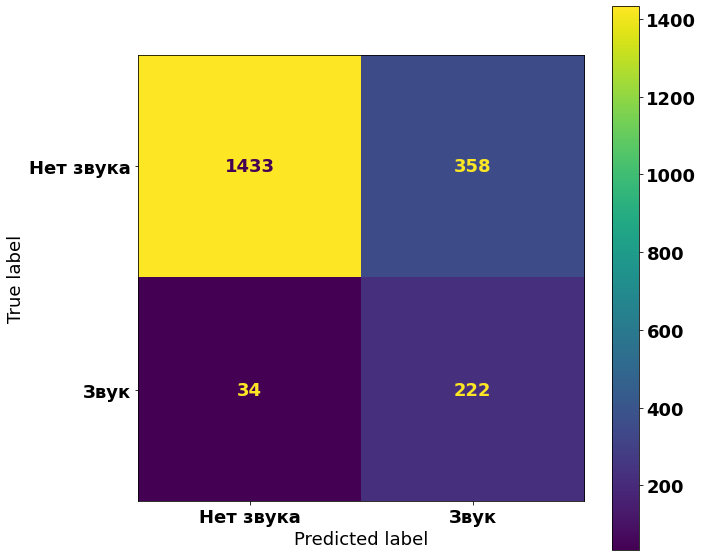

In [ ]:
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels = ['Нет звука', 'Звук'])
fig, ax = plt.subplots(figsize=(10,10))
disp.plot(ax = ax)
plt.rcParams.update({'font.size': 14})
plt.show()

Сопоставляем вероятности, начало и конец распознанных звуков относительно начала треков в тестовой выборке

In [ ]:
tracks = get_track(audio_test) # получаем номера треков

In [ ]:
kum_sum = kum_sum_range(lstOfTime_test) # получаем метки начала и конца треков относительно общей длины

In [ ]:
# получаем вероятности, средние вероятности, границы выделенных звуков относительно начала трека и номера треков
prob_y, prob_mean_y, indexes_by_tracks, indexes_by_start, numbers, quantities = recognizeProb(yPred, oneLst, tracks, kum_sum)

отфильтровываем целевые звуки и посылаем их на обработку автоэнкодером для того, чтобы определить точность звуков. После отправляем снова на класификатор - чтобы получить вероятности.

In [ ]:
# пример границ предсказанного сетью звука
indexes_by_start[0]

array([1022, 1533])

In [ ]:
# take a fragments of xTest what net recognize as a goal-sounds for giving to autoencoder
testToCheck = toCheck(test, indexes_by_start)

In [ ]:
# получаем чистоту звука - посылаем xTest на автоэнкодер,
# а потом - чтобы получить вероятности - снова на классификатор
clarity_of_sounds = model.predict(model_conv1d.predict(testToCheck))

Суммируем вероятности относительно количества единиц 

In [ ]:
# получаем просуммированные по длине распознанных звуков вероятности после автоэнкодера
clarity_numbers = check_to_numbers(clarity_of_sounds, quantities)

представляем в виде таблицы

In [ ]:
db = pd.DataFrame()
db['Track'] = numbers
db['Start and Stop'] = indexes_by_tracks
db['Probability, %'] = np.around(prob_mean_y, 4) * 100
db['After au, %'] = np.around(scalMM(clarity_numbers), 2) * 100
db['Difference, %'] = (scalMM(clarity_numbers) - prob_mean_y) * 100
db['Mean, %'] = np.around((scalMM(clarity_numbers) + prob_mean_y)/2, 4) * 100

In [ ]:
db.head(20)

,Track,Start and Stop,"Probability, %","After au, %","Difference, %","Mean, %"
0,0,"[1022, 1533]",68.300003,9.0,-59.092407,38.760002
1,0,"[4088, 9709]",51.099998,52.0,1.096058,51.650002
2,1,"[1022, 3577]",40.820000,10.0,-30.414602,25.610001
3,1,"[6643, 15841]",51.389999,94.0,42.911427,72.839996
4,2,"[1022, 3577]",57.930000,8.0,-50.185757,32.840000
5,2,"[4599, 5110]",32.500000,2.0,-30.300028,17.350000
6,2,"[7154, 10220]",59.140003,32.0,-27.560362,45.360001
7,3,"[1022, 1533]",22.340000,0.0,-22.339014,11.170000
8,3,"[9709, 13286]",65.720001,0.0,-65.575317,32.930000
9,3,"[15330, 15841]",21.799999,0.0,-21.802416,10.900000


Смотрим, какие звуки распознала сеть и как именно

In [ ]:
# выбираем первый трек:
db[db['Track'] == 9]

,Track,Start and Stop,"Probability, %","After au, %","Difference, %","Mean, %"
30,9,"[1022, 2555]",49.189999,2.000000,-46.751354,25.820000
31,9,"[6132, 12264]",50.660004,15.000001,-35.575424,32.880001
32,9,"[13286, 13797]",21.309999,3.000000,-18.324181,12.150000
33,9,"[14819, 15330]",22.470001,3.000000,-19.952892,12.490000


In [ ]:
# enter number of the track
# enter start and end of recognized sound
getPlayer(8, 6132, 12264, audio_test)

In [ ]:
# 1 - вообще чётко, целиком звук распознало.
# 3 - странно распознало, с соседними звуками
# 6 - идеально распознало.
# 7-10 - здесь и нет звука, всё верно сделал автоэнкодер.
# 12 - забраковал автоэнкодер, хотя распознано по максимуму верно.
# 14 - распознано верно, автоэнкодер даёт "акцент"
# 24 - распознано верно, голос более хриплый, даёт меньший процент на автоэнкодере и классификаторе.
# 25 - максимум, но оба явно ошиблись. 
# 26 - Второй звук распознан идеально.
# 28 - распознано идеально.
# 31 - идеально.

In [ ]:
# также возможная ошибка - выбраны односложные слова по сходной модели. Возможно, модель примерно угадывает, где должна быть буква?

In [ ]:
db.to_csv('/content/drive/MyDrive/dz/pronounce/results_minmax.csv', index=False)

## visualize recognized sounds and evaluate errors in a classificator based on MinMaxScaler. Datas pretrained by autoencoder.

In [ ]:
model_conv1d = load_model('/content/drive/MyDrive/dz/mod/conv1dmfcc_pretrain.h5', compile = True)

In [ ]:
model = load_model('/content/drive/MyDrive/dz/mod/model_raw_mfcc40_pretrain.h5', compile = True)

In [ ]:
#model.compile(optimizer=Adam(0.0001), loss='mean_squared_error') 

Получаем предсказание вероятностей, где расположены целевые звуки

In [ ]:
# to normalize a xTest
test = scalMM(X_test_mfcc_i)

In [ ]:
tested = model_conv1d.predict(test)

In [ ]:
yPred_at = model.predict(tested) # to predict of test data

In [ ]:
#yPred = model.predict(test) # to predict of test data

In [ ]:
#np.save('/content/drive/MyDrive/dz/pronounce/yPred.npy', yPred)
#np.save('/content/drive/MyDrive/dz/pronounce/yPred_au.npy', yPred)

In [ ]:
yPred_at[:28]

array([[3.0346072e-07],
       [5.8262438e-02],
       [6.4504629e-01],
       [5.2910197e-01],
       [7.1758062e-02],
       [6.3099861e-03],
       [1.7588288e-02],
       [9.0363622e-04],
       [2.3688594e-01],
       [5.5447298e-01],
       [3.9632347e-01],
       [3.6590359e-01],
       [2.7793118e-01],
       [6.1367047e-01],
       [6.3187307e-01],
       [6.3432044e-01],
       [9.1558754e-02],
       [1.9168040e-01],
       [2.7516997e-01],
       [2.4206337e-01],
       [1.7742455e-01],
       [4.9753547e-02],
       [1.9930810e-02],
       [7.1693957e-03],
       [2.2864342e-04],
       [4.7079146e-02],
       [4.6508085e-05],
       [3.0346072e-07]], dtype=float32)

Создаём вектор, по которому будем отслеживать начало и конец распознанных звуков

In [ ]:
# take a 0-1 form from yPred and choose probability than merge true or false recognized sounds
merges = recognizeMerges(yPred_at, 0.2)

In [ ]:
#first track and recognized sounds when we see 1
merges[:28]

array([[0.],
       [0.],
       [1.],
       [1.],
       [0.],
       [0.],
       [0.],
       [0.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [0.],
       [0.],
       [1.],
       [1.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.]], dtype=float32)

In [ ]:
# correct of oneLst from recognizeMerges(yPred) (maybe only for a long sounds but not for [d], [t] etc)
oneLst = fillOnes(merges)

Смотрим ошибку распознавания звуков

In [ ]:
err, errL = summaError(yLittleTest, oneLst, lstOfTime_test)

realy true recognized sounds: 184
recognized like true, but is false sounds: 277
recognized like false, but is true sounds: 72
realy false recognized souns: 1514
Word Recognition Rate (to differ sounds by no-sounds): 82.95 %
Word Error Rate (to differ no-sounds by sounds): 17.05 %
Accuracy (how model find a sounds): 0.40
Fullness (how model find a no-sounds): 0.72
Harmonical mean: 0.51


In [ ]:
cm = confusion_matrix(yLittleTest, oneLst)
print(cm)

[[1514  277]
 [  72  184]]


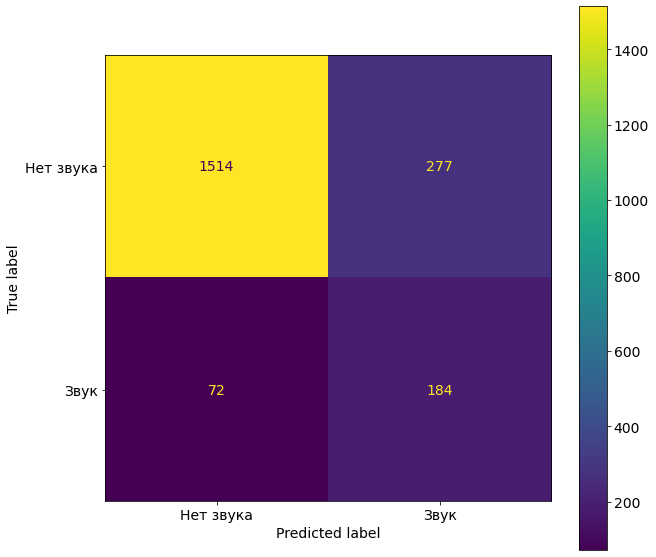

In [ ]:
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels = ['Нет звука', 'Звук'])
fig, ax = plt.subplots(figsize=(10,10))
disp.plot(ax = ax)
plt.rcParams.update({'font.size': 18})
plt.show()

Сопоставляем вероятности, начало и конец распознанных звуков относительно начала треков в тестовой выборке

In [ ]:
tracks = get_track(audio_test) # получаем номера треков

In [ ]:
kum_sum = kum_sum_range(lstOfTime_test) # получаем метки начала и конца треков относительно общей длины

In [ ]:
# получаем вероятности, средние вероятности, границы выделенных звуков относительно начала трека и номера треков
prob_y, prob_mean_y, indexes_by_tracks, indexes_by_start, numbers, quantities = recognizeProb(yPred, oneLst, tracks, kum_sum)

отфильтровываем целевые звуки и посылаем их на обработку автоэнкодером для того, чтобы определить точность звуков. После отправляем снова на класификатор - чтобы получить вероятности.

In [ ]:
# пример границ предсказанного сетью звука
indexes_by_start[0]

array([2, 3])

In [ ]:
# take a fragments of xTest what net recognize as a goal-sounds for giving to autoencoder
testToCheck = toCheck(test, indexes_by_start)

In [ ]:
# получаем чистоту звука - посылаем xTest на автоэнкодер,
# а потом - чтобы получить вероятности - снова на классификатор
clarity_of_sounds = model.predict(model_conv1d.predict(testToCheck))

Суммируем вероятности относительно количества единиц 

In [ ]:
# получаем просуммированные по длине распознанных звуков вероятности после автоэнкодера
clarity_numbers = check_to_numbers(clarity_of_sounds, quantities)

представляем в виде таблицы

In [ ]:
db = pd.DataFrame()
db['Track'] = numbers
db['Start and Stop'] = indexes_by_tracks
db['Probability, %'] = np.around(prob_mean_y, 4) * 100
db['After au, %'] = np.around(scalMM(clarity_numbers), 2) * 100
db['Difference, %'] = (scalMM(clarity_numbers) - prob_mean_y) * 100
db['Mean, %'] = np.around((scalMM(clarity_numbers) + prob_mean_y)/2, 4) * 100

In [ ]:
db.head(20)

,Track,Start and Stop,"Probability, %","After au, %","Difference, %","Mean, %"
0,0,"[1022, 1533]",68.300003,9.0,-59.053593,38.780003
1,0,"[4088, 7665]",63.660004,40.0,-23.778883,51.779999
2,0,"[9198, 9709]",22.700001,10.0,-12.818729,16.290001
3,1,"[1022, 2044]",59.429996,7.0,-52.057774,33.399998
4,1,"[6643, 7665]",27.450001,18.0,-9.814422,22.540001
5,1,"[8687, 14819]",63.209999,63.0,-0.113946,63.160004
6,2,"[1022, 3577]",57.930000,9.0,-48.570370,33.649998
7,2,"[4599, 5110]",32.500000,5.0,-27.554926,18.719999
8,2,"[7154, 9709]",64.120003,23.0,-41.421337,43.410000
9,3,"[10220, 12775]",71.919998,0.0,-71.636345,36.099998


Смотрим, какие звуки распознала сеть и как именно

In [ ]:
db_st = pd.read_csv('/content/drive/MyDrive/dz/pronounce/results_standart_scal.csv')

In [ ]:
db_au = pd.read_csv('/content/drive/MyDrive/dz/pronounce/results_minmax.csv')

In [ ]:
db_st[db_st['Track'] == 12]

,Track,Start and Stop,Probability,Probability after au,Difference,Mean
26,12,"[19418, 19929]",1.000000,0.99928,-0.000722,0.999639
27,12,"[24017, 24528]",0.360842,1.99878,1.637942,1.179813
28,12,"[35259, 35770]",0.997703,0.00000,-0.997703,0.498852
29,12,"[40369, 40880]",0.999204,0.00000,-0.999204,0.499602
30,12,"[42413, 42924]",0.999999,0.00000,-0.999999,0.499999
31,12,"[61831, 62342]",1.000000,0.00000,-1.000000,0.500000
32,12,"[65408, 65919]",0.882996,0.00000,-0.882996,0.441498
33,12,"[69496, 70007]",0.985901,0.00000,-0.985901,0.492951
34,12,"[72051, 72562]",0.998401,0.00000,-0.998401,0.499201
35,12,"[78694, 79716]",0.997746,0.00000,-0.997746,0.498873


In [ ]:
db_au[db_au['Track'] == 9]

,Track,Start and Stop,"Probability, %","After au, %","Difference, %","Mean, %"
30,9,"[1022, 2555]",49.190000,2.000000,-46.751354,25.82
31,9,"[6132, 12264]",50.660004,15.000001,-35.575424,32.88
32,9,"[13286, 13797]",21.310000,3.000000,-18.324180,12.15
33,9,"[14819, 15330]",22.470001,3.000000,-19.952892,12.49


In [ ]:
# выбираем первый трек:
db[db['Track'] == 9]

,Track,Start and Stop,"Probability, %","After au, %","Difference, %","Mean, %"
31,9,"[1022, 2555]",49.189999,14.0,-35.557522,31.41
32,9,"[6643, 11753]",55.930000,2.0,-53.559441,29.15


In [ ]:
# enter number of the track
# enter start and end of recognized sound
getPlayer(12, 77161, 79716, audio_test)

In [ ]:
# 1 - захватило соседний звук.
# 5 - захватило соседние звуки.
# 8 - отлично распознал.
# 9 - ложный звук, автоэнкодер не поддержал
# 12 - забраковал автоэнкодер, хотя распознано по максимуму верно.
# 14 - распознано верно, автоэнкодер даёт "акцент"
# 21 - ошибка
# 23, 24 - слиты два звука; распознано верно, голос более хриплый, даёт максимум на классификаторе и ничто на автоэнкодере.
# 27 - идеально.
# 28 - захватил соседний звук
# 31, 32 - распознал оба звука в слове.
# 35 - захватил соседний звук. По сравнению с "чистым" автоэнкодером дал "лишний" звук. Но дал большую точность автоэнкодером.
# 37 - чётко распознал, как и чистый автоэнкодер. 
# 39 - ложный звук и в чистом, и в предобработанном автоэнкодере. 
# 49 - наконец, угадали. 

Модели тренировались преимущественно на одно-двух-трёхсложных словах. Длинные предложения увеличивают погрешность. 

In [ ]:
db.to_csv('/content/drive/MyDrive/dz/pronounce/results_minmax_pretrained.csv', index=False)

# MinMaxScaler + 255 nfft

## visualize recognized sounds and evaluate errors in a classificator based on MinMaxScaler

In [ ]:
model_conv1d = load_model('/content/drive/MyDrive/dz/mod/conv1dmfcc.h5', compile = True)

In [ ]:
model = load_model('/content/drive/MyDrive/dz/mod/model_raw_mfcc40.h5', compile = True)

In [ ]:
#model.compile(optimizer=Adam(0.0001), loss='mean_squared_error') 

Получаем предсказание вероятностей, где расположены целевые звуки

In [ ]:
# to normalize a xTest
test = scalMM(X_test_mfcc_i)

In [94]:
yPred = model.predict(test) # to predict of test data

In [ ]:
#np.save('/content/drive/MyDrive/dz/pronounce/yPred.npy', yPred)
#np.save('/content/drive/MyDrive/dz/pronounce/yPred_au.npy', yPred)

Создаём вектор, по которому будем отслеживать начало и конец распознанных звуков

In [95]:
# take a 0-1 form from yPred and choose probability than merge true or false recognized sounds
merges = recognizeMerges(yPred, 0.2)

In [96]:
#first track and recognized sounds when we see 1
merges[:28]

array([[0.],
       [0.],
       [0.],
       [1.],
       [1.],
       [1.],
       [1.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.]], dtype=float32)

In [97]:
# correct of oneLst from recognizeMerges(yPred) (maybe only for a long sounds but not for [d], [t] etc)
oneLst = fillOnes(merges)

Смотрим ошибку распознавания звуков

In [98]:
err, errL = summaError(yLittleTest, oneLst, lstOfTime_test)

realy true recognized sounds: 460
recognized like true, but is false sounds: 707
recognized like false, but is true sounds: 54
realy false recognized souns: 2868
Word Recognition Rate (to differ sounds by no-sounds): 81.39 %
Word Error Rate (to differ no-sounds by sounds): 18.61 %
Accuracy (how model find a sounds): 0.39
Fullness (how model find a no-sounds): 0.89
Harmonical mean: 0.55


In [ ]:
cm = confusion_matrix(yLittleTest, oneLst)
print(cm)

[[1433  358]
 [  34  222]]


In [99]:
cm = confusion_matrix(yLittleTest, oneLst)
print(cm)

[[2868  707]
 [  54  460]]


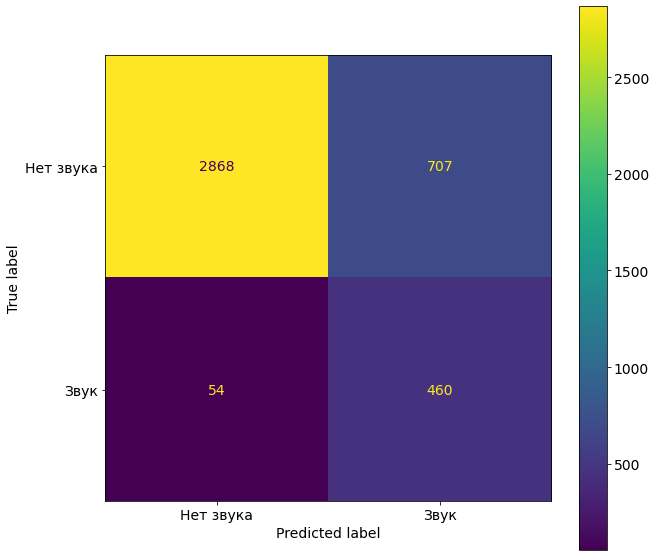

In [101]:
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels = ['Нет звука', 'Звук'])
fig, ax = plt.subplots(figsize=(10,10))
disp.plot(ax = ax)
plt.rcParams.update({'font.size': 18})
plt.show()

Сопоставляем вероятности, начало и конец распознанных звуков относительно начала треков в тестовой выборке

In [102]:
tracks = get_track(audio_test) # получаем номера треков

In [103]:
kum_sum = kum_sum_range(lstOfTime_test) # получаем метки начала и конца треков относительно общей длины

In [104]:
# получаем вероятности, средние вероятности, границы выделенных звуков относительно начала трека и номера треков
prob_y, prob_mean_y, indexes_by_tracks, indexes_by_start, numbers, quantities = recognizeProb(yPred, oneLst, tracks, kum_sum)

отфильтровываем целевые звуки и посылаем их на обработку автоэнкодером для того, чтобы определить точность звуков. После отправляем снова на класификатор - чтобы получить вероятности.

In [105]:
# пример границ предсказанного сетью звука
indexes_by_start[0]

array([3, 6])

In [106]:
# take a fragments of xTest what net recognize as a goal-sounds for giving to autoencoder
testToCheck = toCheck(test, indexes_by_start)

In [107]:
# получаем чистоту звука - посылаем xTest на автоэнкодер,
# а потом - чтобы получить вероятности - снова на классификатор
clarity_of_sounds = model.predict(model_conv1d.predict(testToCheck))

Суммируем вероятности относительно количества единиц 

In [108]:
# получаем просуммированные по длине распознанных звуков вероятности после автоэнкодера
clarity_numbers = check_to_numbers(clarity_of_sounds, quantities)

представляем в виде таблицы

In [ ]:
db = pd.DataFrame()
db['Track'] = numbers
db['Start and Stop'] = indexes_by_tracks
db['Probability, %'] = np.around(prob_mean_y, 4) * 100
db['After au, %'] = np.around(scalMM(clarity_numbers), 2) * 100
db['Difference, %'] = (scalMM(clarity_numbers) - prob_mean_y) * 100
db['Mean, %'] = np.around((scalMM(clarity_numbers) + prob_mean_y)/2, 4) * 100

In [ ]:
db.head(20)

,Track,Start and Stop,"Probability, %","After au, %","Difference, %","Mean, %"
0,0,"[1022, 1533]",68.300003,9.0,-59.092407,38.760002
1,0,"[4088, 9709]",51.099998,52.0,1.096058,51.650002
2,1,"[1022, 3577]",40.820000,10.0,-30.414602,25.610001
3,1,"[6643, 15841]",51.389999,94.0,42.911427,72.839996
4,2,"[1022, 3577]",57.930000,8.0,-50.185757,32.840000
5,2,"[4599, 5110]",32.500000,2.0,-30.300028,17.350000
6,2,"[7154, 10220]",59.140003,32.0,-27.560362,45.360001
7,3,"[1022, 1533]",22.340000,0.0,-22.339014,11.170000
8,3,"[9709, 13286]",65.720001,0.0,-65.575317,32.930000
9,3,"[15330, 15841]",21.799999,0.0,-21.802416,10.900000


Смотрим, какие звуки распознала сеть и как именно

In [ ]:
# выбираем первый трек:
db[db['Track'] == 9]

,Track,Start and Stop,"Probability, %","After au, %","Difference, %","Mean, %"
30,9,"[1022, 2555]",49.189999,2.000000,-46.751354,25.820000
31,9,"[6132, 12264]",50.660004,15.000001,-35.575424,32.880001
32,9,"[13286, 13797]",21.309999,3.000000,-18.324181,12.150000
33,9,"[14819, 15330]",22.470001,3.000000,-19.952892,12.490000


In [ ]:
# enter number of the track
# enter start and end of recognized sound
getPlayer(8, 6132, 12264, audio_test)

In [ ]:
# 1 - вообще чётко, целиком звук распознало.
# 3 - странно распознало, с соседними звуками
# 6 - идеально распознало.
# 7-10 - здесь и нет звука, всё верно сделал автоэнкодер.
# 12 - забраковал автоэнкодер, хотя распознано по максимуму верно.
# 14 - распознано верно, автоэнкодер даёт "акцент"
# 24 - распознано верно, голос более хриплый, даёт меньший процент на автоэнкодере и классификаторе.
# 25 - максимум, но оба явно ошиблись. 
# 26 - Второй звук распознан идеально.
# 28 - распознано идеально.
# 31 - идеально.

In [ ]:
# также возможная ошибка - выбраны односложные слова по сходной модели. Возможно, модель примерно угадывает, где должна быть буква?

In [ ]:
db.to_csv('/content/drive/MyDrive/dz/pronounce/results_minmax.csv', index=False)

## visualize recognized sounds and evaluate errors in a classificator based on MinMaxScaler. Datas pretrained by autoencoder.

In [ ]:
model_conv1d = load_model('/content/drive/MyDrive/dz/mod/conv1dmfcc_pretrain.h5', compile = True)

In [ ]:
model = load_model('/content/drive/MyDrive/dz/mod/model_raw_mfcc40_pretrain.h5', compile = True)

In [ ]:
#model.compile(optimizer=Adam(0.0001), loss='mean_squared_error') 

Получаем предсказание вероятностей, где расположены целевые звуки

In [ ]:
# to normalize a xTest
test = scalMM(X_test_mfcc_i)

In [ ]:
tested = model_conv1d.predict(test)

In [ ]:
yPred_at = model.predict(tested) # to predict of test data

In [ ]:
#yPred = model.predict(test) # to predict of test data

In [ ]:
#np.save('/content/drive/MyDrive/dz/pronounce/yPred.npy', yPred)
#np.save('/content/drive/MyDrive/dz/pronounce/yPred_au.npy', yPred)

In [ ]:
yPred_at[:28]

array([[3.0346072e-07],
       [5.8262438e-02],
       [6.4504629e-01],
       [5.2910197e-01],
       [7.1758062e-02],
       [6.3099861e-03],
       [1.7588288e-02],
       [9.0363622e-04],
       [2.3688594e-01],
       [5.5447298e-01],
       [3.9632347e-01],
       [3.6590359e-01],
       [2.7793118e-01],
       [6.1367047e-01],
       [6.3187307e-01],
       [6.3432044e-01],
       [9.1558754e-02],
       [1.9168040e-01],
       [2.7516997e-01],
       [2.4206337e-01],
       [1.7742455e-01],
       [4.9753547e-02],
       [1.9930810e-02],
       [7.1693957e-03],
       [2.2864342e-04],
       [4.7079146e-02],
       [4.6508085e-05],
       [3.0346072e-07]], dtype=float32)

Создаём вектор, по которому будем отслеживать начало и конец распознанных звуков

In [ ]:
# take a 0-1 form from yPred and choose probability than merge true or false recognized sounds
merges = recognizeMerges(yPred_at, 0.2)

In [ ]:
#first track and recognized sounds when we see 1
merges[:28]

array([[0.],
       [0.],
       [1.],
       [1.],
       [0.],
       [0.],
       [0.],
       [0.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [0.],
       [0.],
       [1.],
       [1.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.]], dtype=float32)

In [ ]:
# correct of oneLst from recognizeMerges(yPred) (maybe only for a long sounds but not for [d], [t] etc)
oneLst = fillOnes(merges)

Смотрим ошибку распознавания звуков

In [ ]:
err, errL = summaError(yLittleTest, oneLst, lstOfTime_test)

realy true recognized sounds: 184
recognized like true, but is false sounds: 277
recognized like false, but is true sounds: 72
realy false recognized souns: 1514
Word Recognition Rate (to differ sounds by no-sounds): 82.95 %
Word Error Rate (to differ no-sounds by sounds): 17.05 %
Accuracy (how model find a sounds): 0.40
Fullness (how model find a no-sounds): 0.72
Harmonical mean: 0.51


In [ ]:
cm = confusion_matrix(yLittleTest, oneLst)
print(cm)

[[1514  277]
 [  72  184]]


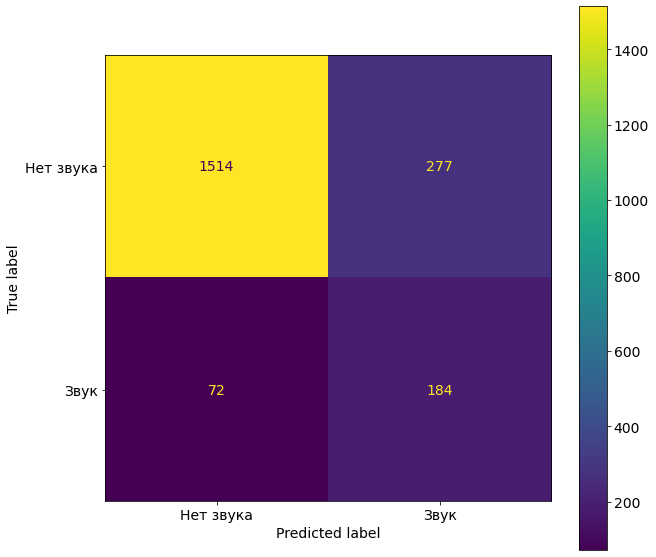

In [ ]:
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels = ['Нет звука', 'Звук'])
fig, ax = plt.subplots(figsize=(10,10))
disp.plot(ax = ax)
plt.rcParams.update({'font.size': 18})
plt.show()

Сопоставляем вероятности, начало и конец распознанных звуков относительно начала треков в тестовой выборке

In [ ]:
tracks = get_track(audio_test) # получаем номера треков

In [ ]:
kum_sum = kum_sum_range(lstOfTime_test) # получаем метки начала и конца треков относительно общей длины

In [ ]:
# получаем вероятности, средние вероятности, границы выделенных звуков относительно начала трека и номера треков
prob_y, prob_mean_y, indexes_by_tracks, indexes_by_start, numbers, quantities = recognizeProb(yPred, oneLst, tracks, kum_sum)

отфильтровываем целевые звуки и посылаем их на обработку автоэнкодером для того, чтобы определить точность звуков. После отправляем снова на класификатор - чтобы получить вероятности.

In [ ]:
# пример границ предсказанного сетью звука
indexes_by_start[0]

array([2, 3])

In [ ]:
# take a fragments of xTest what net recognize as a goal-sounds for giving to autoencoder
testToCheck = toCheck(test, indexes_by_start)

In [ ]:
# получаем чистоту звука - посылаем xTest на автоэнкодер,
# а потом - чтобы получить вероятности - снова на классификатор
clarity_of_sounds = model.predict(model_conv1d.predict(testToCheck))

Суммируем вероятности относительно количества единиц 

In [ ]:
# получаем просуммированные по длине распознанных звуков вероятности после автоэнкодера
clarity_numbers = check_to_numbers(clarity_of_sounds, quantities)

представляем в виде таблицы

In [ ]:
db = pd.DataFrame()
db['Track'] = numbers
db['Start and Stop'] = indexes_by_tracks
db['Probability, %'] = np.around(prob_mean_y, 4) * 100
db['After au, %'] = np.around(scalMM(clarity_numbers), 2) * 100
db['Difference, %'] = (scalMM(clarity_numbers) - prob_mean_y) * 100
db['Mean, %'] = np.around((scalMM(clarity_numbers) + prob_mean_y)/2, 4) * 100

In [ ]:
db.head(20)

,Track,Start and Stop,"Probability, %","After au, %","Difference, %","Mean, %"
0,0,"[1022, 1533]",68.300003,9.0,-59.053593,38.780003
1,0,"[4088, 7665]",63.660004,40.0,-23.778883,51.779999
2,0,"[9198, 9709]",22.700001,10.0,-12.818729,16.290001
3,1,"[1022, 2044]",59.429996,7.0,-52.057774,33.399998
4,1,"[6643, 7665]",27.450001,18.0,-9.814422,22.540001
5,1,"[8687, 14819]",63.209999,63.0,-0.113946,63.160004
6,2,"[1022, 3577]",57.930000,9.0,-48.570370,33.649998
7,2,"[4599, 5110]",32.500000,5.0,-27.554926,18.719999
8,2,"[7154, 9709]",64.120003,23.0,-41.421337,43.410000
9,3,"[10220, 12775]",71.919998,0.0,-71.636345,36.099998


Смотрим, какие звуки распознала сеть и как именно

In [ ]:
db_st = pd.read_csv('/content/drive/MyDrive/dz/pronounce/results_standart_scal.csv')

In [ ]:
db_au = pd.read_csv('/content/drive/MyDrive/dz/pronounce/results_minmax.csv')

In [ ]:
db_st[db_st['Track'] == 12]

,Track,Start and Stop,Probability,Probability after au,Difference,Mean
26,12,"[19418, 19929]",1.000000,0.99928,-0.000722,0.999639
27,12,"[24017, 24528]",0.360842,1.99878,1.637942,1.179813
28,12,"[35259, 35770]",0.997703,0.00000,-0.997703,0.498852
29,12,"[40369, 40880]",0.999204,0.00000,-0.999204,0.499602
30,12,"[42413, 42924]",0.999999,0.00000,-0.999999,0.499999
31,12,"[61831, 62342]",1.000000,0.00000,-1.000000,0.500000
32,12,"[65408, 65919]",0.882996,0.00000,-0.882996,0.441498
33,12,"[69496, 70007]",0.985901,0.00000,-0.985901,0.492951
34,12,"[72051, 72562]",0.998401,0.00000,-0.998401,0.499201
35,12,"[78694, 79716]",0.997746,0.00000,-0.997746,0.498873


In [ ]:
db_au[db_au['Track'] == 9]

,Track,Start and Stop,"Probability, %","After au, %","Difference, %","Mean, %"
30,9,"[1022, 2555]",49.190000,2.000000,-46.751354,25.82
31,9,"[6132, 12264]",50.660004,15.000001,-35.575424,32.88
32,9,"[13286, 13797]",21.310000,3.000000,-18.324180,12.15
33,9,"[14819, 15330]",22.470001,3.000000,-19.952892,12.49


In [ ]:
# выбираем первый трек:
db[db['Track'] == 9]

,Track,Start and Stop,"Probability, %","After au, %","Difference, %","Mean, %"
31,9,"[1022, 2555]",49.189999,14.0,-35.557522,31.41
32,9,"[6643, 11753]",55.930000,2.0,-53.559441,29.15


In [ ]:
# enter number of the track
# enter start and end of recognized sound
getPlayer(12, 77161, 79716, audio_test)

In [ ]:
# 1 - захватило соседний звук.
# 5 - захватило соседние звуки.
# 8 - отлично распознал.
# 9 - ложный звук, автоэнкодер не поддержал
# 12 - забраковал автоэнкодер, хотя распознано по максимуму верно.
# 14 - распознано верно, автоэнкодер даёт "акцент"
# 21 - ошибка
# 23, 24 - слиты два звука; распознано верно, голос более хриплый, даёт максимум на классификаторе и ничто на автоэнкодере.
# 27 - идеально.
# 28 - захватил соседний звук
# 31, 32 - распознал оба звука в слове.
# 35 - захватил соседний звук. По сравнению с "чистым" автоэнкодером дал "лишний" звук. Но дал большую точность автоэнкодером.
# 37 - чётко распознал, как и чистый автоэнкодер. 
# 39 - ложный звук и в чистом, и в предобработанном автоэнкодере. 
# 49 - наконец, угадали. 

Модели тренировались преимущественно на одно-двух-трёхсложных словах. Длинные предложения увеличивают погрешность. 

In [ ]:
db.to_csv('/content/drive/MyDrive/dz/pronounce/results_minmax_pretrained.csv', index=False)

# Тест с микрофона

### функции

In [3]:
!pip install ffmpeg-python
import ffmpeg # кроссплатформенная open-source библиотека для обработки видео- и аудиофайлов

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [4]:
AUDIO_HTML = """
<script>  // создаем тег <script>, сообщающий браузеру о том, что внутри находится исполняемый код JavaScript
var my_div = document.createElement("DIV");  // создаем новый элемент DIV(тег-контейнер для логического выделения блока документа)
var my_p = document.createElement("P");  // создаем новый элемент P(параграф для логической группировки текста)
var my_btn = document.createElement("BUTTON");  // создаем новый элемент(кнопку) BUTTON
var t = document.createTextNode("Press to start recording");  // создаем текстовое содержимое для кнопки

my_btn.appendChild(t);  // добавляем текстовое содержимое элементу BUTTON
my_div.appendChild(my_btn);  // кнопку с текстом BUTTON добавляем в блок DIV
document.body.appendChild(my_div);  // добавляем наш блок в элемент <body>("тело", для хранения содержимого веб-страницы)

var base64data = 0;  // будем использовать для аудиоданных метод кодирования информации в 64-разрядный код
var reader;  // создаем переменную для чтения файла
var recorder, gumStream; // объявляем переменные для записи данных/потока
var recordButton = my_btn; //  создаем переменную для кнопки записи аудио с микрофона

var handleSuccess = function(stream) {  // объявляем функцию для работы с потоками данных
  gumStream = stream;  // создаем переменную для потока
  var options = {
    mimeType : 'audio/webm;codecs=opus' // в опциях задаем медиа тип с аудиоформатом и кодеками
  };            
  recorder = new MediaRecorder(stream); // создаем новый объект MediaRecorder, получающий медиапоток для записи.
  // MediaRecorder - интерфейс MediaStream Recording API представляющий функциональность для простой записи медиа. Создается..
  // ..с использованием MediaRecorder() конструктора.
  recorder.ondataavailable = function(e) {  // вызываем обработчик dataavailable события, запускаемое по окончанию записи          
    var url = URL.createObjectURL(e.data); // этим методом создаем DOMString(UTF-16 String), содержащий URL с указанием на объект e.data
    var preview = document.createElement('audio'); // создаем элемент-тег аудио
    preview.controls = true; // активизируем элементы управления
    preview.src = url; // берем в кач-ве исходных данных файл, содержащийся в записанной ранее URL
    document.body.appendChild(preview); //добавляем элемент аудио в <body>("тело", для хранения содержимого веб-страницы)

    reader = new FileReader();  // создаем объект класса FileReader для чтения разных источников данных
    reader.readAsDataURL(e.data);  // читаем содержимое указанного файла
    reader.onloadend = function() {  // обработчик события, запускаемого после передачи данных
      base64data = reader.result; // записываем прочитанное содержимое в base64data
    }
  };
  recorder.start();  // начало записи медиа
  };

recordButton.innerText = "Идёт запись... нажмите для остановки"; // такой текст будет на кнопке BUTTON во время записи аудио

// запрос разрешения пользователя на доступ к устройству захвата аудио(микрофон), указываем True
navigator.mediaDevices.getUserMedia({audio: true}).then(handleSuccess);


function toggleRecording() {  // функция опишет действия по завершению записи (после клика мышкой по кнопке "Recording... press to stop")
  if (recorder && recorder.state == "recording") {  // если рекордер находится в процессе записи 
      recorder.stop();  // рекордер прерывается
      gumStream.getAudioTracks()[0].stop();  // отключается запись и доступ к микрофону
      recordButton.innerText = "Saving the recording... pls wait!" // эта надпись(сохранение записи) отобразится на кнопке BUTTON 
  }
}

// https://stackoverflow.com/a/951057
function sleep(ms) {  // создаем функцию с задержкой вызова
  return new Promise(resolve => setTimeout(resolve, ms));  
  // new Promise - конструкция для отложенных вычислений
  // setTimeout позволяет вызвать функцию один раз через определённый интервал времени
}

var data = new Promise(resolve=>{
recordButton.onclick = ()=>{  // при нажатии левой кнопкой мыши на кнопку "Recording... press to stop"
toggleRecording()  // вызывается функция завершения аудиозаписи

sleep(2000).then(() => {  // и после задержки 2000мс(2 сек)
  resolve(base64data.toString())  // полученные данные из формата base64 преобразовываем в строку

});

}
});
      
</script>
"""

def get_audio(): # объявляем функцию извлечения аудио, записанного через микрофон в ноутбуке
  display(HTML(AUDIO_HTML)) # c помощью модулей библиотеки IPython отображаем результат выполнения записанного выше скрипта AUDIO_HTML
  data = eval_js("data") # данные на выходе запишем в data как результат выполнения javascript кода
  # data сейчас в таком виде: 'data:audio/webm;codecs=opus;base64,GkXfo59ChoEBQveBAULygQRC84EIQoKEd2VibUKHgQRChYE...mpZpkq1'
  binary = b64decode(data.split(',')[1]) #отсекаем информацию "data:audio/webm;codecs=opus;base64", оставляем только данные и декодируем
  # b'\x1aE\xdf\xa3\x9fB\x86\x81\x01B\xf7\x81\x01B\xf2

  process = (ffmpeg
    .input('pipe:0') # поток стандартного ввода
    .output('pipe:1', format='wav') # стандартного вывода в формате wav 
    .run_async(pipe_stdin=True, pipe_stdout=True, pipe_stderr=True, quiet=True, overwrite_output=True)) # асинхронное выполнение командной строки FFmpeg
  # binary преобразовываем в wav, с типичным для медиафайлов форматом RIFF(ResourceInterchangeFileFormat - формат файла для обмена ресурсами)
  output, err = process.communicate(input=binary)
  # output - b'RIFF\xff\xff\xff\xffWAVEfmt \x10\x00\x00\x00\x01\x00\x01\x00\x80\xbb\x00\x00\...\x01\x00\x01\x00\x01\x0\xff'
  # err - b"ffmpeg version 3.4.6-0ubuntu0.18.04.1 Copyright (c) 2000-2019 the FFmpeg developers\n...headers:0kB muxing overhead: 0.046695%\n"


  # Cодержимое файла группируется из отдельных секций (chunks) - формат выборок аудиоданных. Секция имеет свой заголовок и данные секции.
  # Размер заголовка секции RIFF - 8 байт, их ниже уберём из определения размера секции RIFF
  riff_chunk_size = len(output) - 8 
  # Разбиваем размер секции на четыре байта, которые запишем далее в b.
  q = riff_chunk_size
  b = [] 
  for i in range(4):
      q, r = divmod(q, 256) # возьмем размер секции и вернем частное и остаток от деления на 256, и так 4 раза 
      b.append(r) # каждый из остатков добавим в список

  # Меняем байты c 4го по 7й вкл-но('\xff\xff\xff\xff') в output на b (типа '\xc62\x02\x00')
  riff = output[:4] + bytes(b) + output[8:]

  # класс io.BytesIO позволит работать с последовательностью байтов как с файловым объектом, а далее прочитаем как wav файл
  sr, audio = wav_read(io.BytesIO(riff)) # извлечём частоту дискретизации и полученный сигнал

  return audio, sr # функция вернет полученный сигнал и частоту дискретизации

### распознавание

In [5]:
audio_mic, sr = get_audio() # запишем аудио через микрофон

IndexError: ignored

In [ ]:
# Сохраним запись в формате wav
scipy.io.wavfile.write('recording1.wav', sr, audio)

In [ ]:
word = toTakeRawAudio(directory = r'/content/')

In [ ]:
word_stft, word_mfcc, word_chr, time_of = toTakeRawSounds(word)

In [ ]:
# to normalize an parameters
snd = scal(word_mfcc)

In [ ]:
model_conv1d = load_model('/content/drive/MyDrive/dz/mod/conv1dmfcc.h5', compile = True)

In [ ]:
model = load_model('/content/drive/MyDrive/dz/mod/model_raw_mfcc40.h5', compile = True)

In [ ]:
yPred = model.predict(snd) # to predict of test data

In [ ]:
# take a 0-1 form from yPred and choose probability than merge true or false recognized sounds
merges = recognizeMerges(yPred, 0.2)
# correct of oneLst from recognizeMerges(yPred) (maybe only for a long sounds but not for [d], [t] etc)
oneLst = fillOnes(merges)

In [ ]:
tracks = get_track(audio) # получаем номера треков

In [ ]:
kum_sum = kum_sum_range(time_of) # получаем метки начала и конца треков относительно общей длины

In [ ]:
# получаем вероятности, средние вероятности, границы выделенных звуков относительно начала трека и номера треков
prob_y, prob_mean_y, indexes_by_tracks, indexes_by_start, numbers, quantities = recognizeProb(yPred, oneLst, tracks, kum_sum)

In [ ]:
# take a fragments of xTest what net recognize as a goal-sounds for giving to autoencoder
testToCheck = toCheck(snd, indexes_by_start)

In [ ]:
# получаем чистоту звука - посылаем xTest на автоэнкодер,
# а потом - чтобы получить вероятности - снова на классификатор
clarity_of_sounds = model.predict(model_conv1d.predict(testToCheck))

In [ ]:
# получаем просуммированные по длине распознанных звуков вероятности после автоэнкодера
clarity_numbers = check_to_numbers(clarity_of_sounds, quantities)

In [ ]:
db = pd.DataFrame()

In [ ]:
db['Track'] = numbers
db['Start and Stop'] = indexes_by_tracks
db['Probability'] = prob_mean_y
db['Probability after au'] = np.around(clarity_numbers, 5)
db['Difference'] = clarity_numbers - prob_mean_y
db['Mean'] = (clarity_numbers + prob_mean_y)/2

In [ ]:
db[db['Track'] == 0]

,Track,Start and Stop,Probability,Probability after au,Difference,Mean
0,0,"[1022, 1533]",0.649761,0.00000,-0.649761,0.324881
1,0,"[5110, 5621]",0.616520,0.00002,-0.616504,0.308268
2,0,"[7665, 8687]",0.603772,1.57298,0.969212,1.088378


In [ ]:
# enter number of sound which recognized in the track
# enter start and end of recognized sound
getPlayer(0, 5621, 7154, audio_mic)

# tests of different parameters

## classification model Dense for chroma stft

In [ ]:
model = Sequential()
model.add(Dense(256, activation='relu', input_shape=(x_train.shape[1],)))
#model.add(BatchNormalization())
model.add(Dropout(0.2))
model.add(Dense(128, activation='relu'))
#model.add(BatchNormalization())
model.add(Dropout(0.2))

model.add(Dense(64, activation='relu'))
#model.add(BatchNormalization())
model.add(Dropout(0.2))

model.add(Dense(32, activation='relu'))
#model.add(BatchNormalization())
model.add(Dropout(0.2))

model.add(Dense(1, activation='sigmoid'))


In [ ]:
model.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_20 (Dense)            (None, 256)               3328      
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_21 (Dense)            (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_22 (Dense)            (None, 64)                8256      
                                                                 
 dropout_3 (Dropout)         (None, 64)                0         
                                                                 
 dense_23 (Dense)            (None, 32)               

In [ ]:
#Компилируем сеть
model.compile(optimizer=Adam(lr=0.0001),
              loss='binary_crossentropy',
              metrics=['accuracy'])

Epoch 1/5
9310/9310 [==============================] - 21s 2ms/step - loss: 0.3092 - accuracy: 0.9009 - val_loss: 0.2913 - val_accuracy: 0.8986
Epoch 2/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2978 - accuracy: 0.9009 - val_loss: 0.2897 - val_accuracy: 0.8986
Epoch 3/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2961 - accuracy: 0.9009 - val_loss: 0.2921 - val_accuracy: 0.8986
Epoch 4/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2903 - accuracy: 0.9009 - val_loss: 0.2970 - val_accuracy: 0.8986
Epoch 5/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2902 - accuracy: 0.9009 - val_loss: 0.2950 - val_accuracy: 0.8986


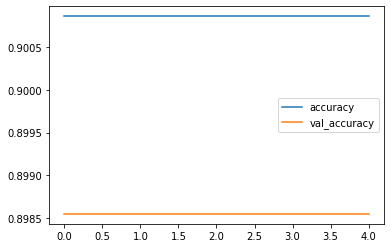

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

Epoch 1/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2513 - accuracy: 0.9071 - val_loss: 0.2789 - val_accuracy: 0.8995
Epoch 2/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2460 - accuracy: 0.9093 - val_loss: 0.2856 - val_accuracy: 0.8947
Epoch 3/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2422 - accuracy: 0.9104 - val_loss: 0.2831 - val_accuracy: 0.8908
Epoch 4/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2407 - accuracy: 0.9096 - val_loss: 0.2853 - val_accuracy: 0.8870
Epoch 5/5
9310/9310 [==============================] - 33s 4ms/step - loss: 0.2358 - accuracy: 0.9107 - val_loss: 0.2901 - val_accuracy: 0.8889


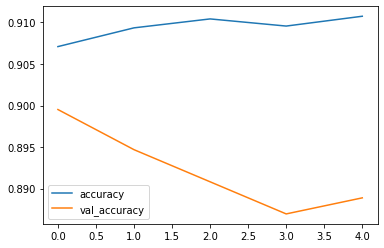

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

In [ ]:
model.save('/content/drive/MyDrive/dz/mod/model_raw_chroma.h5')
model.save_weights('/content/drive/MyDrive/dz/mod/model_raw_w_chroma.h5')

### Predict data and analyzis

In [ ]:
lstOfTime_test

array([ 28,  34,  35,  42,  26,  31,  79,  35,  38,  42,  31,  86, 218,
        31,  31, 215,  60,  62,  30,  58,  29,  77,  53,  92,  31,  41,
        52, 218,  22, 220])

In [ ]:
yLittleTest[:28] # example of first word in yTest; 1 is a sound [ai]

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       1., 1., 1., 1., 1., 1., 1., 1., 0., 0., 0.], dtype=float32)

In [ ]:
yLittleTest.shape

(2047,)

### how predicted xTrain correspond to true yTrain

In [ ]:
yPred = model.predict(train) # to predict of train data

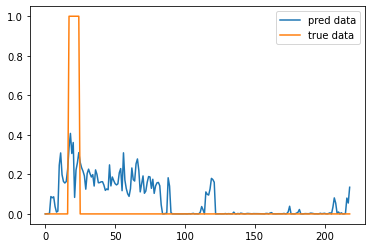

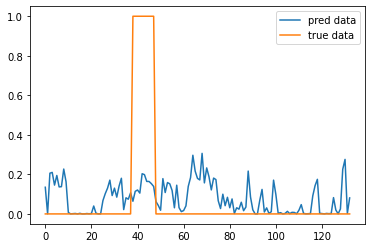

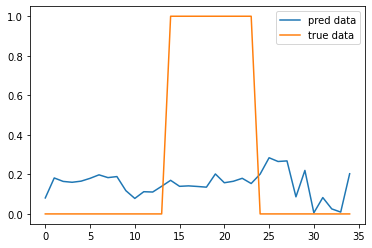

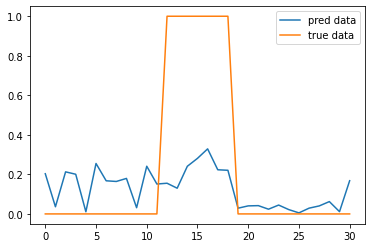

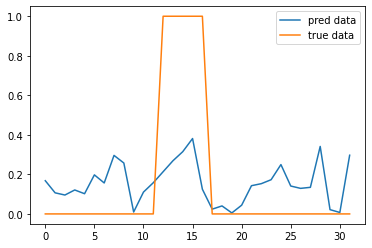

...

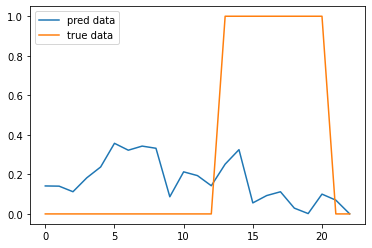

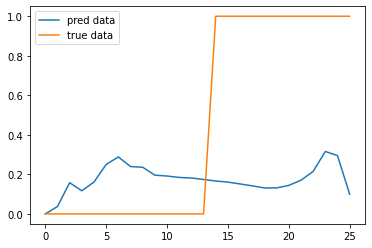

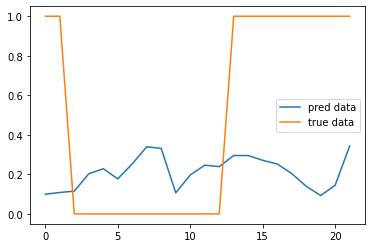

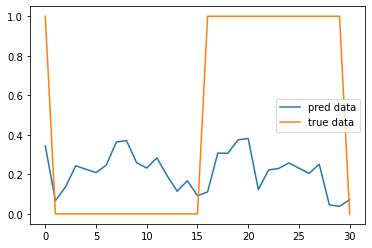

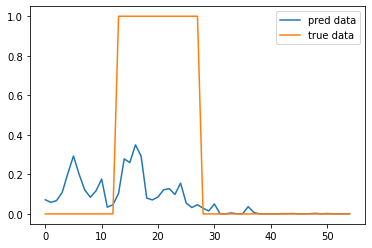

In [ ]:
plotCompare(yLittle2, yPred, lstOfTime)

In [ ]:
lstOfTime

### how predicted xTest correspond to true yTest

In [ ]:
yPred = model.predict(test) # to predict of test data

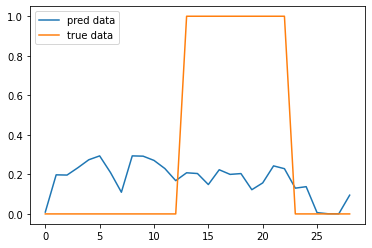

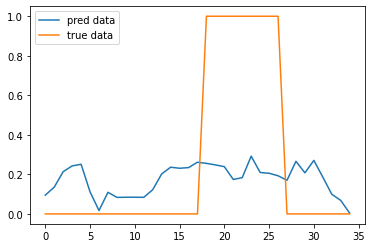

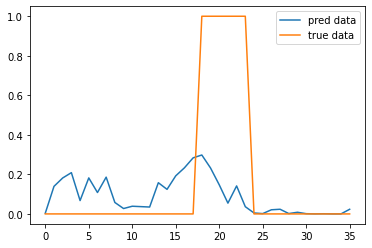

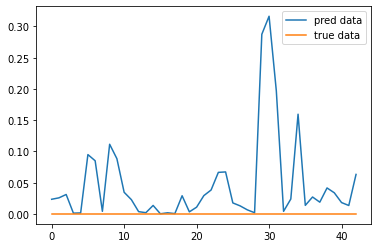

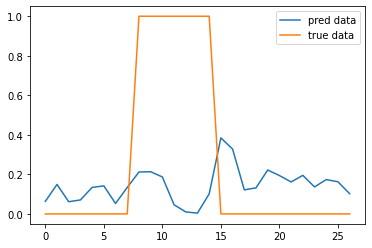

...

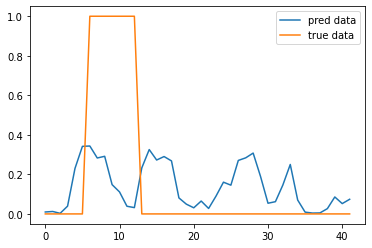

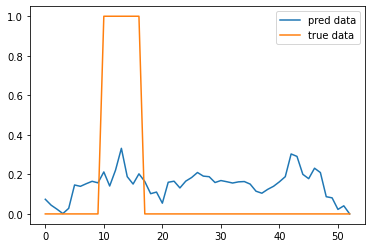

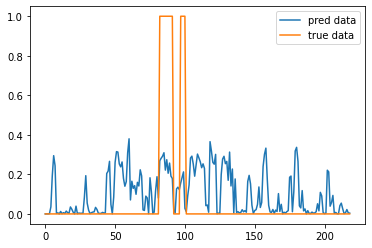

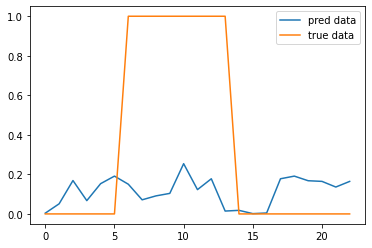

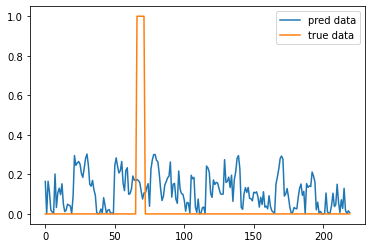

In [ ]:
plotCompare(yLittleTest2, yPred, lstOfTime_test)

In [ ]:
model.evaluate(test, yLittleTest2)

64/64 [==============================] - 1s 3ms/step - loss: 0.3709 - accuracy: 0.8749


[0.37085407972335815, 0.8748778104782104]

### Вывод

Мы видим, что на обучающей выборке точность неплохая. На тестовой выборке мы имеем точность ниже. 

Визуально видно, что на обоих выборках распознавание нужных звуков никак не выделяется. Если в stft, mfcc для yTrain, yTest были соответствия - то здесь, если и есть, то случайные.  



## classification model Dense for chromagram

In [ ]:
model = Sequential()
model.add(Dense(256, activation='relu', input_shape=(x_train.shape[1],)))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))


In [ ]:
model.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_25 (Dense)            (None, 256)               3328      
                                                                 
 dense_26 (Dense)            (None, 128)               32896     
                                                                 
 dense_27 (Dense)            (None, 64)                8256      
                                                                 
 dense_28 (Dense)            (None, 32)                2080      
                                                                 
 dense_29 (Dense)            (None, 1)                 33        
                                                                 
Total params: 46,593
Trainable params: 46,593
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#Компилируем сеть
model.compile(optimizer=Adam(lr=0.00001),
              loss='binary_crossentropy',
              metrics=['accuracy'])

Epoch 1/5
9310/9310 [==============================] - 25s 3ms/step - loss: 0.3052 - accuracy: 0.8989 - val_loss: 0.2932 - val_accuracy: 0.8995
Epoch 2/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2879 - accuracy: 0.9005 - val_loss: 0.2901 - val_accuracy: 0.8995
Epoch 3/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2808 - accuracy: 0.9004 - val_loss: 0.2813 - val_accuracy: 0.8995
Epoch 4/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2730 - accuracy: 0.9013 - val_loss: 0.2841 - val_accuracy: 0.8986
Epoch 5/5
9310/9310 [==============================] - 21s 2ms/step - loss: 0.2655 - accuracy: 0.9027 - val_loss: 0.2703 - val_accuracy: 0.9005


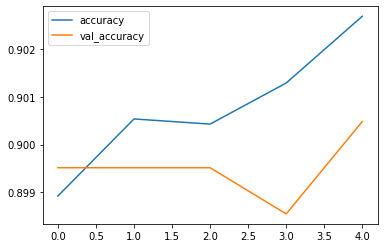

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

Epoch 1/5
9310/9310 [==============================] - 21s 2ms/step - loss: 0.2520 - accuracy: 0.9044 - val_loss: 0.2667 - val_accuracy: 0.9014
Epoch 2/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2474 - accuracy: 0.9046 - val_loss: 0.2660 - val_accuracy: 0.9024
Epoch 3/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2454 - accuracy: 0.9054 - val_loss: 0.2648 - val_accuracy: 0.9014
Epoch 4/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2434 - accuracy: 0.9062 - val_loss: 0.2634 - val_accuracy: 0.9014
Epoch 5/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2416 - accuracy: 0.9056 - val_loss: 0.2637 - val_accuracy: 0.9014


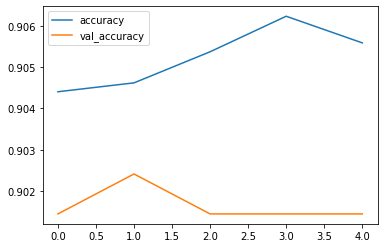

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

In [ ]:
model.save('/content/drive/MyDrive/dz/mod/model_raw_chromagram.h5')
model.save_weights('/content/drive/MyDrive/dz/mod/model_raw_w_chromagram.h5')

### Predict data and analyzis

In [ ]:
lstOfTime_test

array([ 28,  34,  35,  42,  26,  31,  79,  35,  38,  42,  31,  86, 218,
        31,  31, 215,  60,  62,  30,  58,  29,  77,  53,  92,  31,  41,
        52, 218,  22, 220])

In [ ]:
yLittleTest[:28] # example of first word in yTest; 1 is a sound [ai]

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       1., 1., 1., 1., 1., 1., 1., 1., 0., 0., 0.], dtype=float32)

In [ ]:
yLittleTest.shape

(2047,)

### how predicted xTrain correspond to true yTrain

In [ ]:
yPred = model.predict(train) # to predict of train data

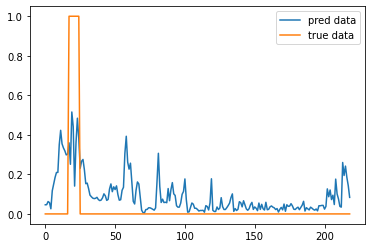

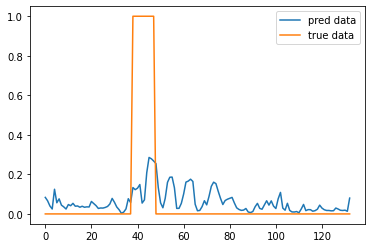

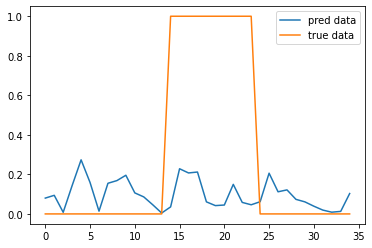

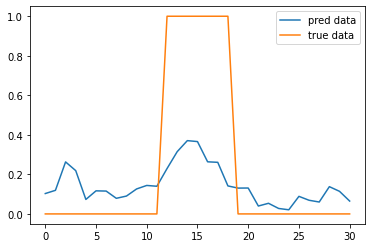

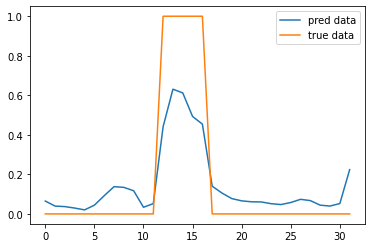

...

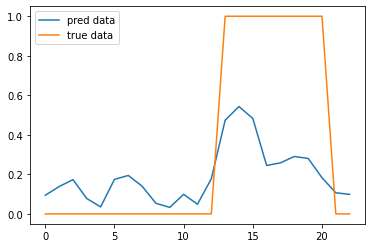

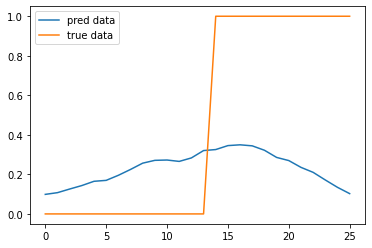

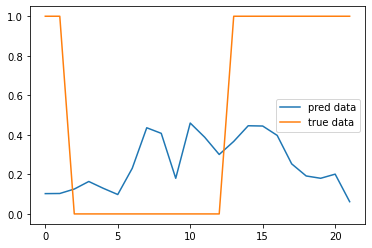

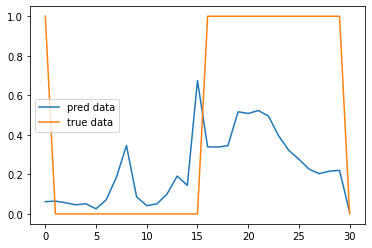

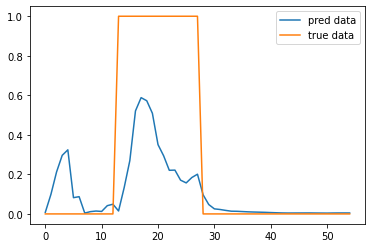

In [ ]:
plotCompare(yLittle2, yPred, lstOfTime)

In [ ]:
lstOfTime

### how predicted xTest correspond to true yTest

In [ ]:
yPred = model.predict(test) # to predict of test data

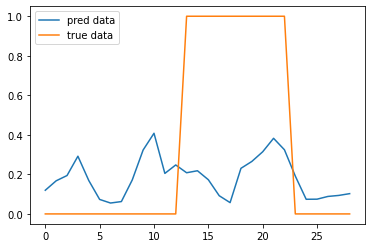

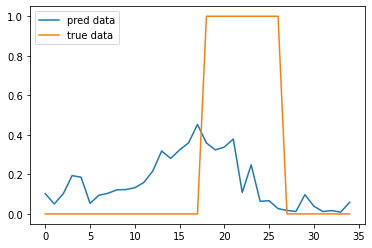

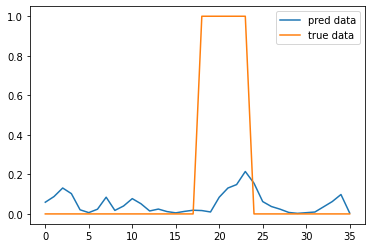

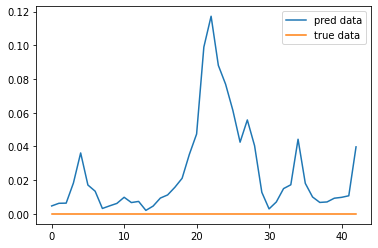

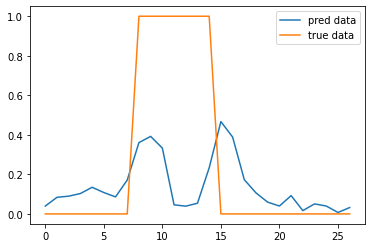

...

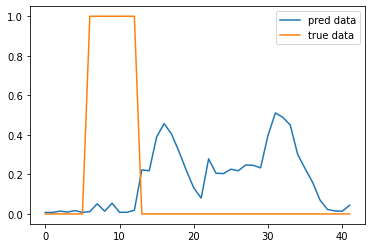

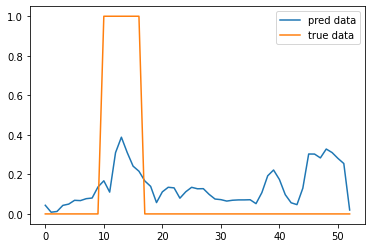

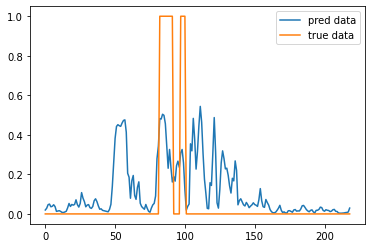

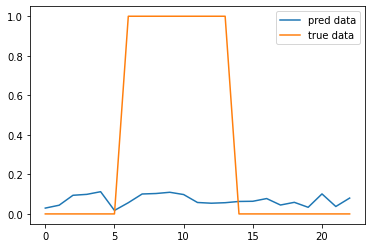

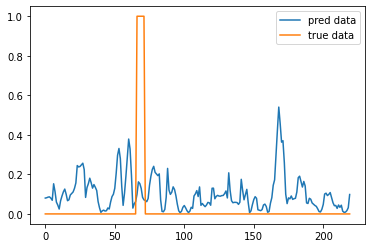

In [ ]:
plotCompare(yLittleTest2, yPred, lstOfTime_test)

In [ ]:
model.evaluate(test, yLittleTest2)

64/64 [==============================] - 0s 3ms/step - loss: 0.3800 - accuracy: 0.8700


[0.3799642324447632, 0.8699902296066284]

### Вывод

Chomatogram показала себя лучше, чем chroma_stft. На предсказанной обучающей выборке видно в большинстве случаев соответствие yTrue, yPred. 

На тестовой выборке такие совпадения редки. 



## classification model Dense for rmse

In [ ]:
model = Sequential()
model.add(Dense(256, activation='relu', input_shape=(x_train.shape[1],)))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))


In [ ]:
model.summary()

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_35 (Dense)            (None, 256)               512       
                                                                 
 dense_36 (Dense)            (None, 128)               32896     
                                                                 
 dense_37 (Dense)            (None, 64)                8256      
                                                                 
 dense_38 (Dense)            (None, 32)                2080      
                                                                 
 dense_39 (Dense)            (None, 1)                 33        
                                                                 
Total params: 43,777
Trainable params: 43,777
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#Компилируем сеть
model.compile(optimizer=Adam(lr=0.00001),
              loss='binary_crossentropy',
              metrics=['accuracy'])

Epoch 1/5
9310/9310 [==============================] - 21s 2ms/step - loss: 0.2865 - accuracy: 0.9013 - val_loss: 0.2865 - val_accuracy: 0.8937
Epoch 2/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2735 - accuracy: 0.9014 - val_loss: 0.2796 - val_accuracy: 0.8937
Epoch 3/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2710 - accuracy: 0.9014 - val_loss: 0.2816 - val_accuracy: 0.8937
Epoch 4/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2694 - accuracy: 0.9014 - val_loss: 0.2778 - val_accuracy: 0.8937
Epoch 5/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2689 - accuracy: 0.9014 - val_loss: 0.2748 - val_accuracy: 0.8937


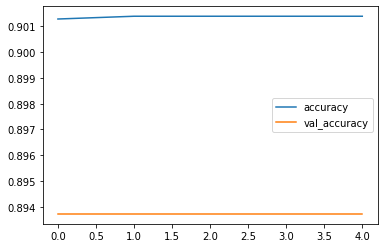

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

Epoch 1/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2666 - accuracy: 0.9014 - val_loss: 0.2748 - val_accuracy: 0.8937
Epoch 2/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2664 - accuracy: 0.9014 - val_loss: 0.2749 - val_accuracy: 0.8937
Epoch 3/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2663 - accuracy: 0.9014 - val_loss: 0.2749 - val_accuracy: 0.8937
Epoch 4/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2662 - accuracy: 0.9014 - val_loss: 0.2754 - val_accuracy: 0.8937
Epoch 5/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2663 - accuracy: 0.9014 - val_loss: 0.2747 - val_accuracy: 0.8937


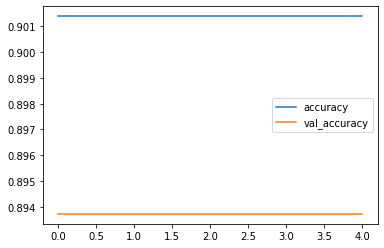

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

In [ ]:
model.save('/content/drive/MyDrive/dz/mod/model_raw_chromagram.h5')
model.save_weights('/content/drive/MyDrive/dz/mod/model_raw_w_chromagram.h5')

### Predict data and analyzis

### how predicted xTrain correspond to true yTrain

In [ ]:
yPred = model.predict(train) # to predict of train data

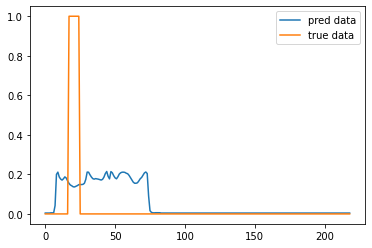

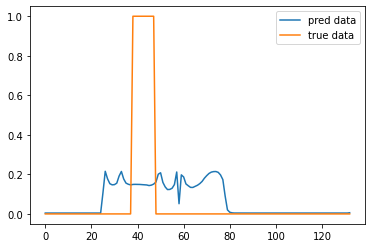

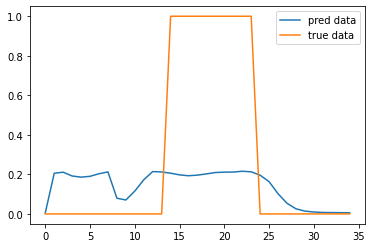

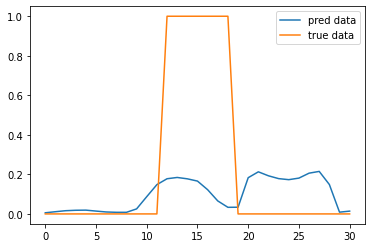

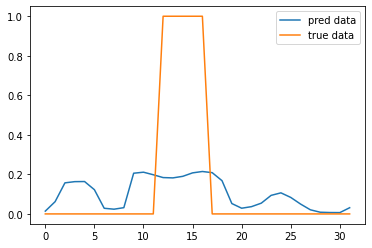

...

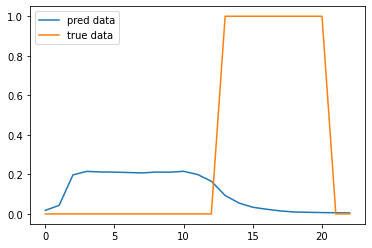

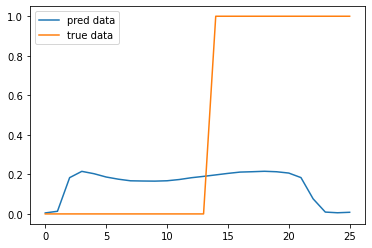

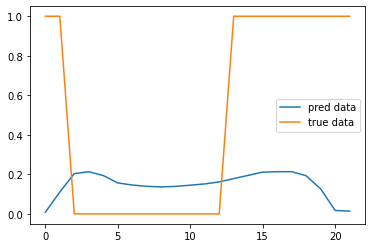

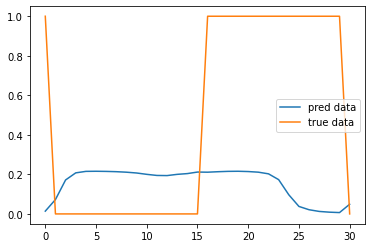

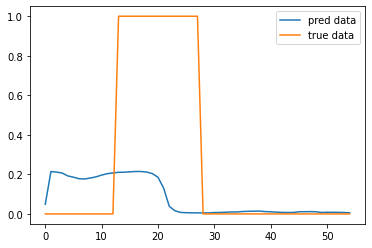

In [ ]:
plotCompare(yLittle2, yPred, lstOfTime)

### how predicted xTest correspond to true yTest

In [ ]:
yPred = model.predict(test) # to predict of test data

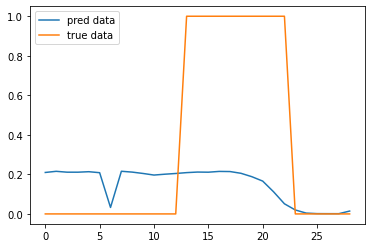

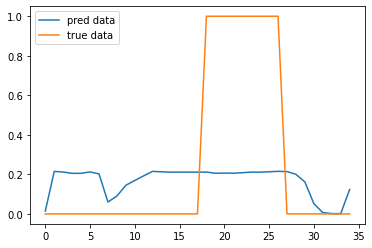

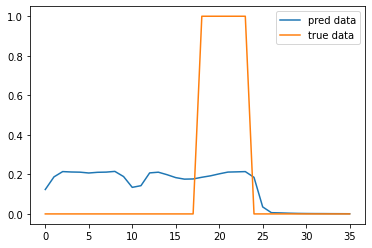

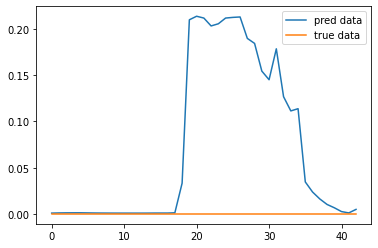

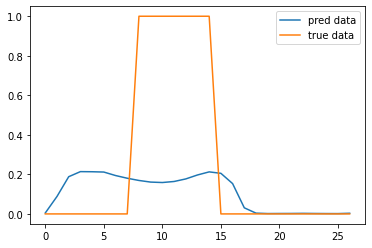

...

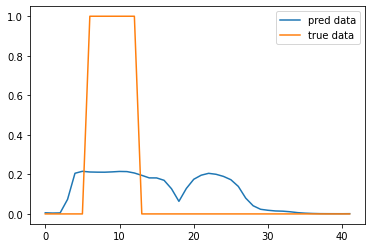

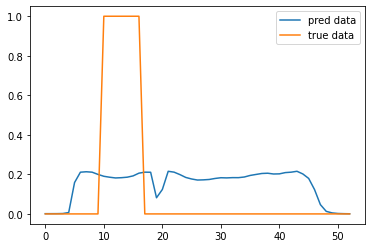

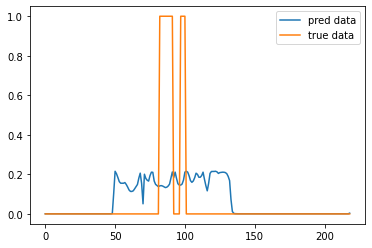

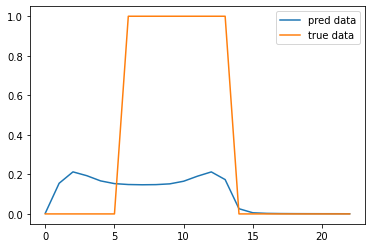

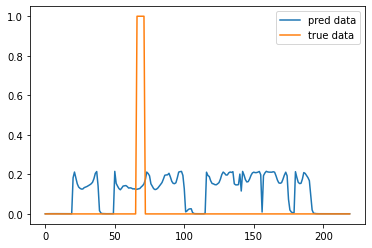

In [ ]:
plotCompare(yLittleTest2, yPred, lstOfTime_test)

In [ ]:
model.evaluate(test, yLittleTest2)

64/64 [==============================] - 0s 2ms/step - loss: 0.3216 - accuracy: 0.8749


[0.3215848505496979, 0.8748778104782104]

### Вывод

Chomatogram показала себя лучше, чем chroma_stft. На предсказанной обучающей выборке видно в большинстве случаев соответствие yTrue, yPred. 

На тестовой выборке такие совпадения редки. 



## classification model Dense for spec cent

In [ ]:
model = Sequential()
model.add(Dense(256, activation='relu', input_shape=(x_train.shape[1],)))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))


In [ ]:
model.summary()

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_40 (Dense)            (None, 256)               512       
                                                                 
 dense_41 (Dense)            (None, 128)               32896     
                                                                 
 dense_42 (Dense)            (None, 64)                8256      
                                                                 
 dense_43 (Dense)            (None, 32)                2080      
                                                                 
 dense_44 (Dense)            (None, 1)                 33        
                                                                 
Total params: 43,777
Trainable params: 43,777
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#Компилируем сеть
model.compile(optimizer=Adam(lr=0.0001),
              loss='binary_crossentropy',
              metrics=['accuracy'])

Epoch 1/5
9310/9310 [==============================] - 22s 2ms/step - loss: 0.3148 - accuracy: 0.9017 - val_loss: 0.3273 - val_accuracy: 0.8860
Epoch 2/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2981 - accuracy: 0.9023 - val_loss: 0.3249 - val_accuracy: 0.8860
Epoch 3/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2968 - accuracy: 0.9023 - val_loss: 0.3228 - val_accuracy: 0.8860
Epoch 4/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2952 - accuracy: 0.9023 - val_loss: 0.3229 - val_accuracy: 0.8860
Epoch 5/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2946 - accuracy: 0.9023 - val_loss: 0.3352 - val_accuracy: 0.8860


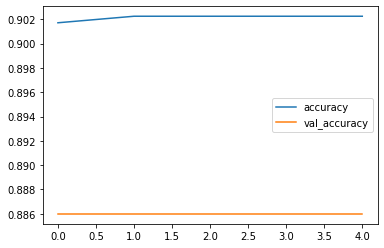

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

Epoch 1/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2666 - accuracy: 0.9014 - val_loss: 0.2748 - val_accuracy: 0.8937
Epoch 2/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2664 - accuracy: 0.9014 - val_loss: 0.2749 - val_accuracy: 0.8937
Epoch 3/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2663 - accuracy: 0.9014 - val_loss: 0.2749 - val_accuracy: 0.8937
Epoch 4/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2662 - accuracy: 0.9014 - val_loss: 0.2754 - val_accuracy: 0.8937
Epoch 5/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2663 - accuracy: 0.9014 - val_loss: 0.2747 - val_accuracy: 0.8937


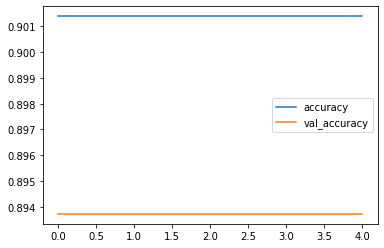

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

In [ ]:
model.save('/content/drive/MyDrive/dz/mod/model_raw_chromagram.h5')
model.save_weights('/content/drive/MyDrive/dz/mod/model_raw_w_chromagram.h5')

### Predict data and analyzis

### how predicted xTrain correspond to true yTrain

In [ ]:
yPred = model.predict(train) # to predict of train data

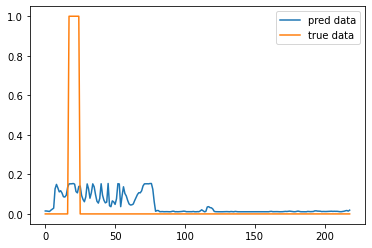

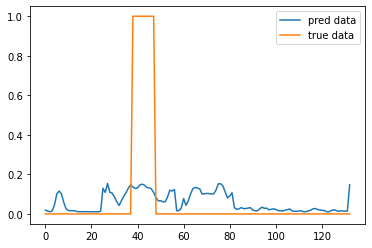

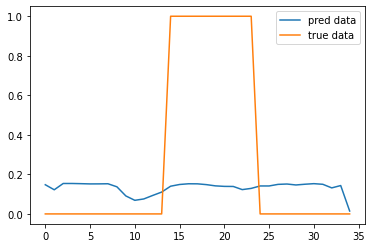

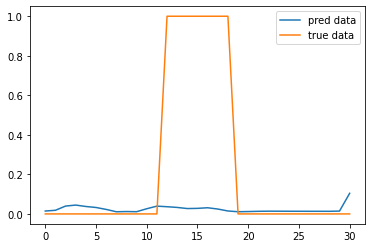

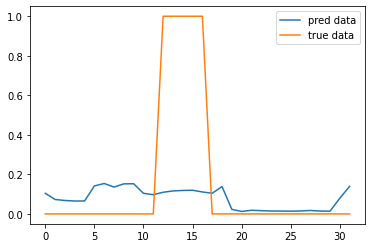

...

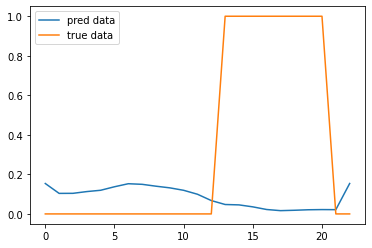

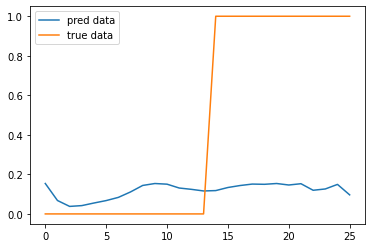

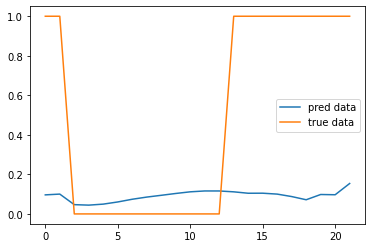

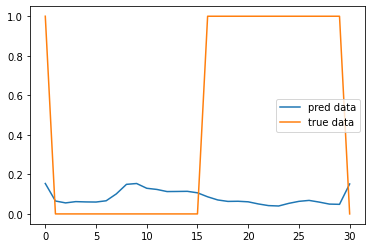

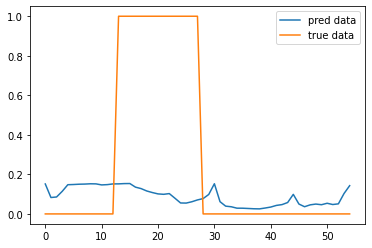

In [ ]:
plotCompare(yLittle2, yPred, lstOfTime)

### how predicted xTest correspond to true yTest

In [ ]:
yPred = model.predict(test) # to predict of test data

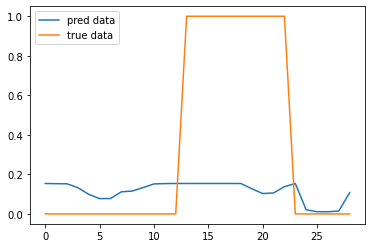

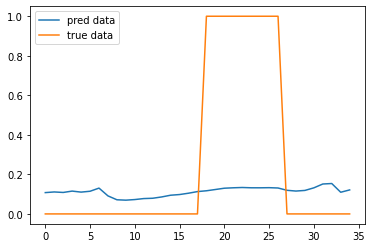

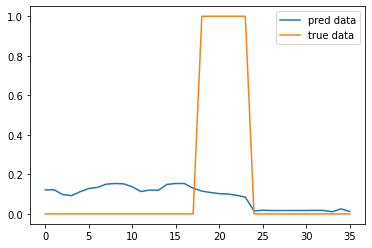

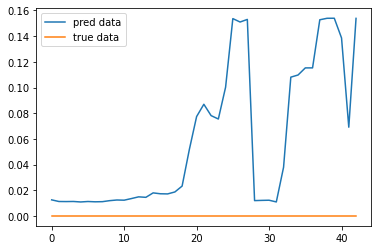

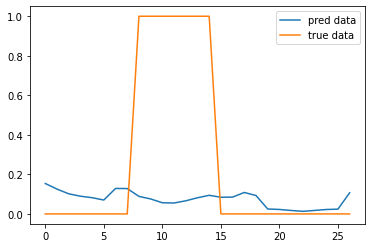

...

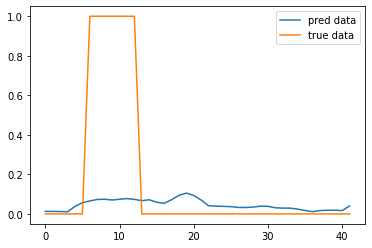

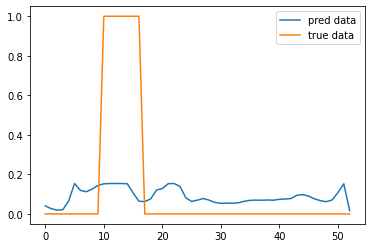

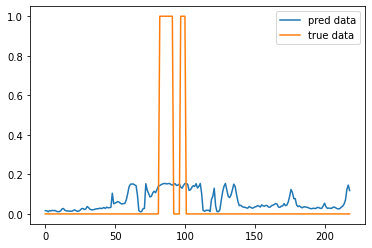

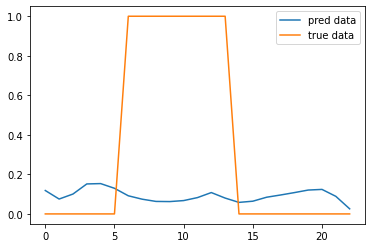

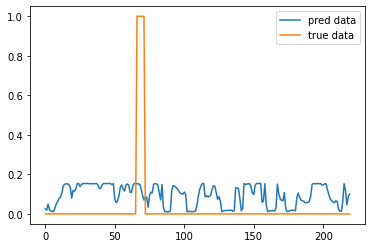

In [ ]:
plotCompare(yLittleTest2, yPred, lstOfTime_test)

In [ ]:
model.evaluate(test, yLittleTest2)

64/64 [==============================] - 0s 2ms/step - loss: 0.3532 - accuracy: 0.8749


[0.35323259234428406, 0.8748778104782104]

### Вывод

Spec cent не показал видимых отличий yPred, yTrue



## classification model Dense for roll off

In [ ]:
model = Sequential()
model.add(Dense(256, activation='relu', input_shape=(x_train.shape[1],)))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))


In [ ]:
model.summary()

Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_45 (Dense)            (None, 256)               512       
                                                                 
 dense_46 (Dense)            (None, 128)               32896     
                                                                 
 dense_47 (Dense)            (None, 64)                8256      
                                                                 
 dense_48 (Dense)            (None, 32)                2080      
                                                                 
 dense_49 (Dense)            (None, 1)                 33        
                                                                 
Total params: 43,777
Trainable params: 43,777
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#Компилируем сеть
model.compile(optimizer=Adam(lr=0.0001),
              loss='binary_crossentropy',
              metrics=['accuracy'])

Epoch 1/5
9310/9310 [==============================] - 24s 3ms/step - loss: 0.2996 - accuracy: 0.9013 - val_loss: 0.3306 - val_accuracy: 0.8889
Epoch 2/5
9310/9310 [==============================] - 26s 3ms/step - loss: 0.2893 - accuracy: 0.9019 - val_loss: 0.3172 - val_accuracy: 0.8889
Epoch 3/5
9310/9310 [==============================] - 23s 3ms/step - loss: 0.2871 - accuracy: 0.9019 - val_loss: 0.3166 - val_accuracy: 0.8889
Epoch 4/5
9310/9310 [==============================] - 21s 2ms/step - loss: 0.2854 - accuracy: 0.9019 - val_loss: 0.3247 - val_accuracy: 0.8889
Epoch 5/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2855 - accuracy: 0.9019 - val_loss: 0.3208 - val_accuracy: 0.8889


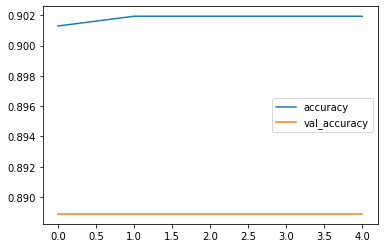

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

Epoch 1/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2666 - accuracy: 0.9014 - val_loss: 0.2748 - val_accuracy: 0.8937
Epoch 2/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2664 - accuracy: 0.9014 - val_loss: 0.2749 - val_accuracy: 0.8937
Epoch 3/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2663 - accuracy: 0.9014 - val_loss: 0.2749 - val_accuracy: 0.8937
Epoch 4/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2662 - accuracy: 0.9014 - val_loss: 0.2754 - val_accuracy: 0.8937
Epoch 5/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2663 - accuracy: 0.9014 - val_loss: 0.2747 - val_accuracy: 0.8937


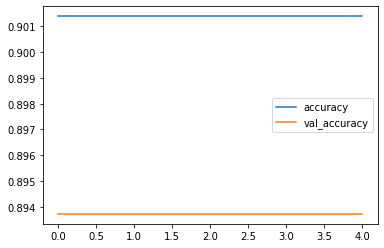

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

In [ ]:
model.save('/content/drive/MyDrive/dz/mod/model_raw_chromagram.h5')
model.save_weights('/content/drive/MyDrive/dz/mod/model_raw_w_chromagram.h5')

### Predict data and analyzis

### how predicted xTrain correspond to true yTrain

In [ ]:
yPred = model.predict(train) # to predict of train data

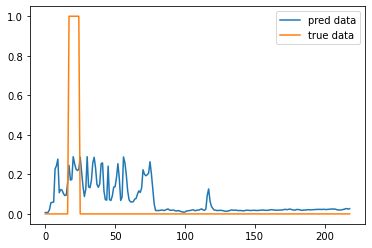

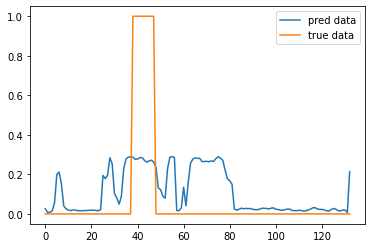

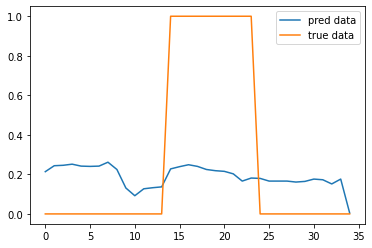

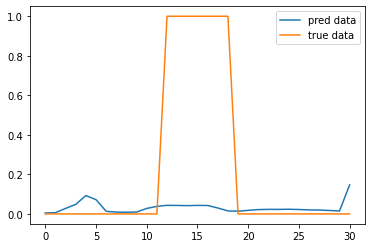

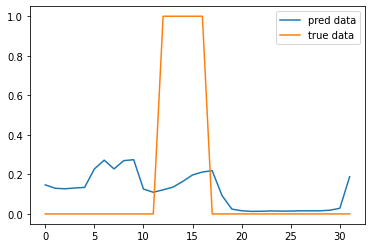

...

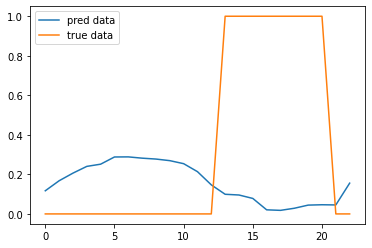

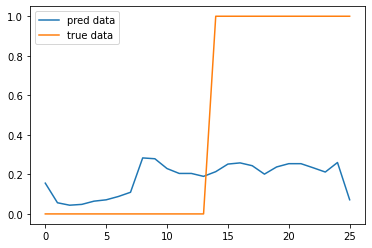

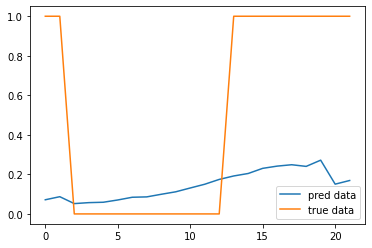

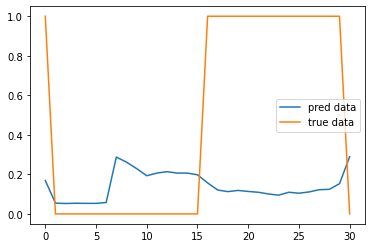

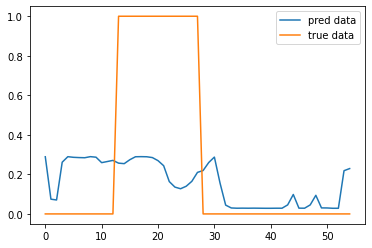

In [ ]:
plotCompare(yLittle2, yPred, lstOfTime)

### how predicted xTest correspond to true yTest

In [ ]:
yPred = model.predict(test) # to predict of test data

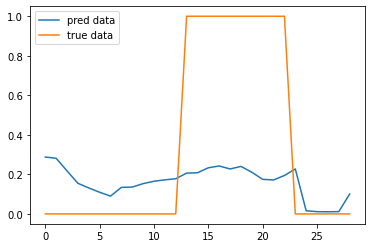

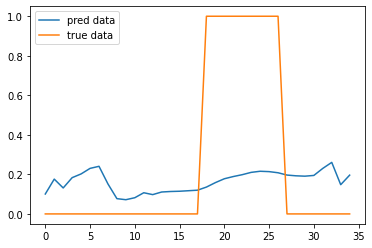

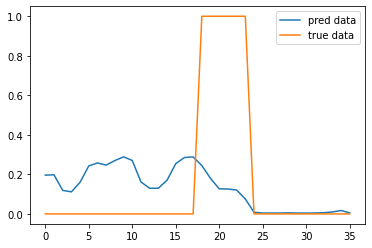

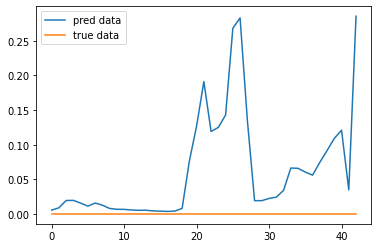

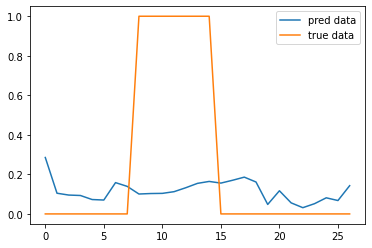

...

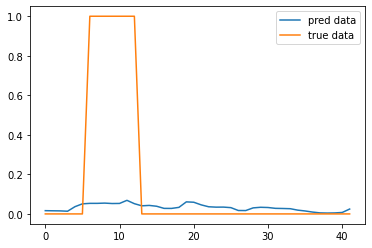

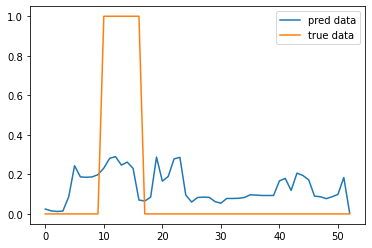

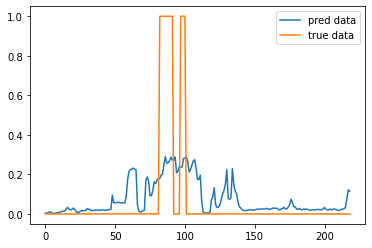

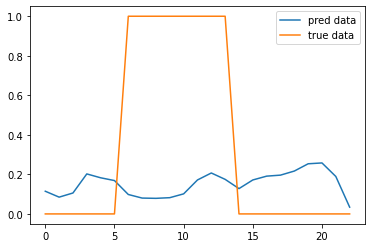

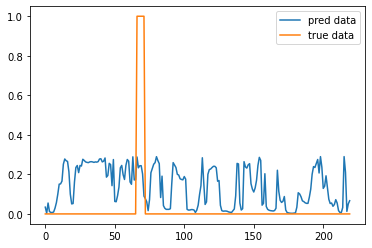

In [ ]:
plotCompare(yLittleTest2, yPred, lstOfTime_test)

In [ ]:
model.evaluate(test, yLittleTest2)

64/64 [==============================] - 0s 2ms/step - loss: 0.3301 - accuracy: 0.8749


[0.3300706446170807, 0.8748778104782104]

### Вывод

Видимых совпадений yTrue, yPred нет



## classification model Dense for rmse, spec cent, roll off

In [ ]:
model = Sequential()
model.add(Dense(256, activation='relu', input_shape=(x_train.shape[1],)))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))


In [ ]:
model.summary()

Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_50 (Dense)            (None, 256)               1024      
                                                                 
 dense_51 (Dense)            (None, 128)               32896     
                                                                 
 dense_52 (Dense)            (None, 64)                8256      
                                                                 
 dense_53 (Dense)            (None, 32)                2080      
                                                                 
 dense_54 (Dense)            (None, 1)                 33        
                                                                 
Total params: 44,289
Trainable params: 44,289
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#Компилируем сеть
model.compile(optimizer=Adam(lr=0.0001),
              loss='binary_crossentropy',
              metrics=['accuracy'])

Epoch 1/5
9310/9310 [==============================] - 21s 2ms/step - loss: 0.2784 - accuracy: 0.8987 - val_loss: 0.2532 - val_accuracy: 0.9130
Epoch 2/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2654 - accuracy: 0.8992 - val_loss: 0.2441 - val_accuracy: 0.9130
Epoch 3/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2606 - accuracy: 0.8992 - val_loss: 0.2381 - val_accuracy: 0.9130
Epoch 4/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2550 - accuracy: 0.8992 - val_loss: 0.2333 - val_accuracy: 0.9130
Epoch 5/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2531 - accuracy: 0.8992 - val_loss: 0.2388 - val_accuracy: 0.9130


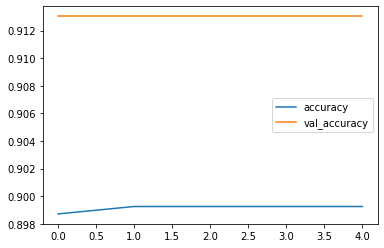

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

Epoch 1/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2666 - accuracy: 0.9014 - val_loss: 0.2748 - val_accuracy: 0.8937
Epoch 2/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2664 - accuracy: 0.9014 - val_loss: 0.2749 - val_accuracy: 0.8937
Epoch 3/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2663 - accuracy: 0.9014 - val_loss: 0.2749 - val_accuracy: 0.8937
Epoch 4/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2662 - accuracy: 0.9014 - val_loss: 0.2754 - val_accuracy: 0.8937
Epoch 5/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2663 - accuracy: 0.9014 - val_loss: 0.2747 - val_accuracy: 0.8937


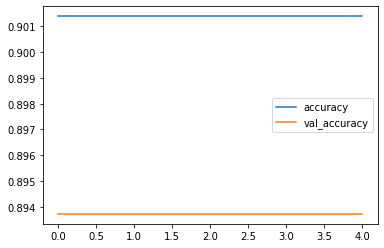

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

In [ ]:
model.save('/content/drive/MyDrive/dz/mod/model_raw_chromagram.h5')
model.save_weights('/content/drive/MyDrive/dz/mod/model_raw_w_chromagram.h5')

### Predict data and analyzis

### how predicted xTrain correspond to true yTrain

In [ ]:
yPred = model.predict(train) # to predict of train data

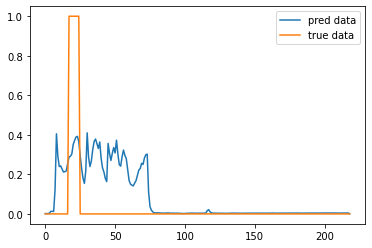

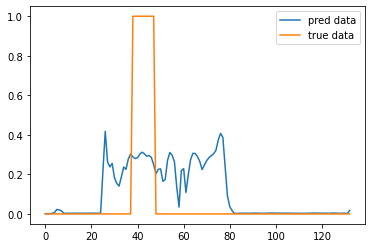

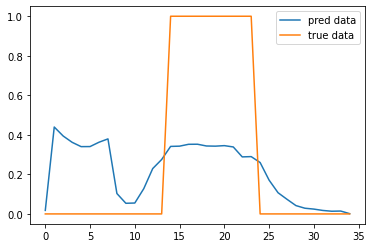

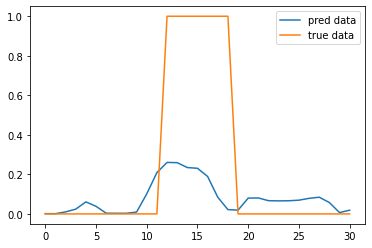

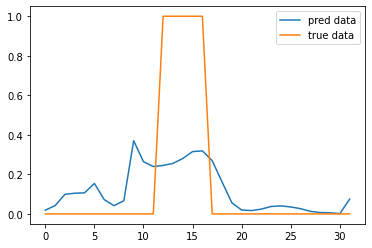

...

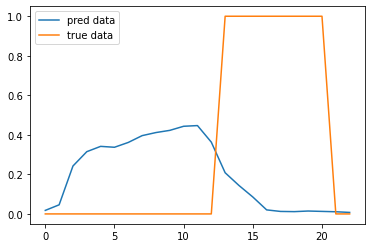

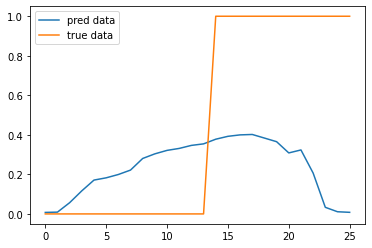

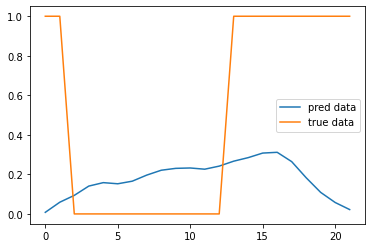

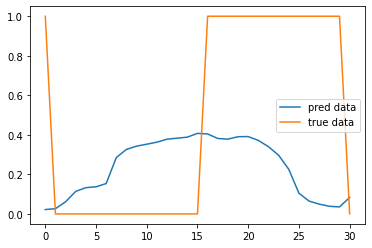

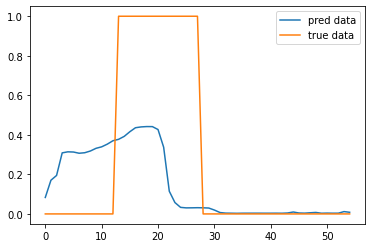

In [ ]:
plotCompare(yLittle2, yPred, lstOfTime)

### how predicted xTest correspond to true yTest

In [ ]:
yPred = model.predict(test) # to predict of test data

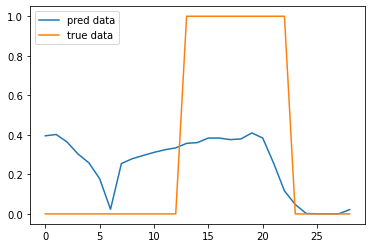

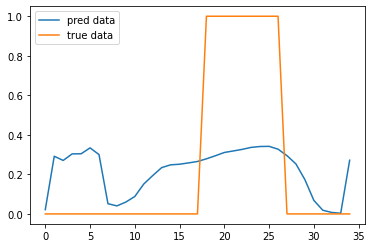

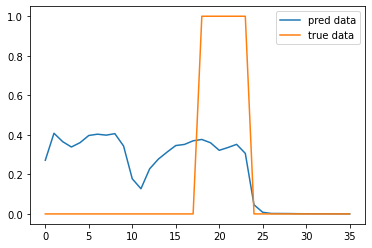

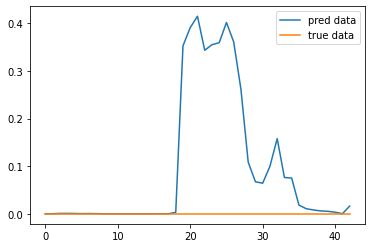

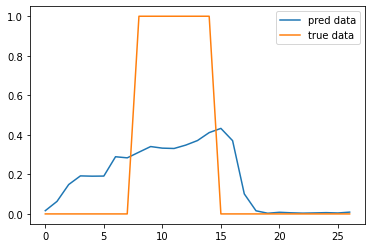

...

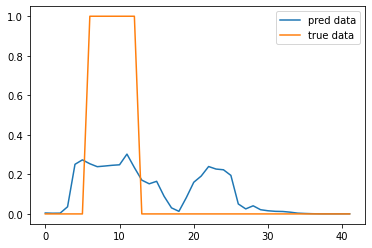

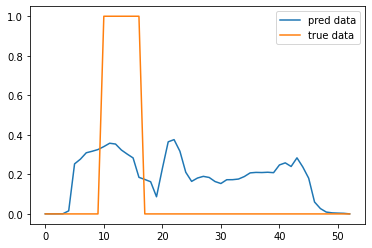

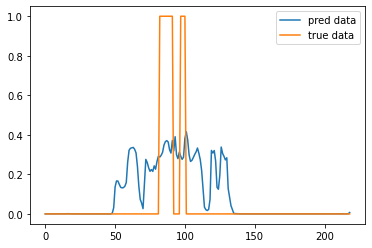

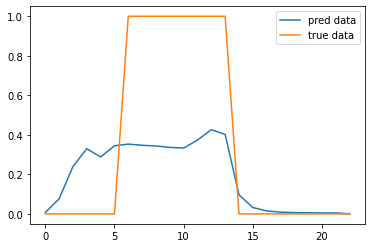

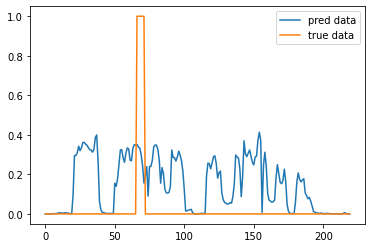

In [ ]:
plotCompare(yLittleTest2, yPred, lstOfTime_test)

In [ ]:
model.evaluate(test, yLittleTest2)

64/64 [==============================] - 0s 2ms/step - loss: 0.2860 - accuracy: 0.8749


[0.28603416681289673, 0.8748778104782104]

### Вывод

Видимых совпадений yTrue, yPred нет



## classification model Dense for croma stft, chromagram, rmse, spec cent, roll off

In [ ]:
model = Sequential()
model.add(Dense(256, activation='relu', input_shape=(x_train.shape[1],)))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))


In [ ]:
model.summary()

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_55 (Dense)            (None, 256)               7168      
                                                                 
 dense_56 (Dense)            (None, 128)               32896     
                                                                 
 dense_57 (Dense)            (None, 64)                8256      
                                                                 
 dense_58 (Dense)            (None, 32)                2080      
                                                                 
 dense_59 (Dense)            (None, 1)                 33        
                                                                 
Total params: 50,433
Trainable params: 50,433
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#Компилируем сеть
model.compile(optimizer=Adam(lr=0.00001),
              loss='binary_crossentropy',
              metrics=['accuracy'])

Epoch 1/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2775 - accuracy: 0.8975 - val_loss: 0.2497 - val_accuracy: 0.9121
Epoch 2/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.2426 - accuracy: 0.9002 - val_loss: 0.2391 - val_accuracy: 0.9092
Epoch 3/5
9310/9310 [==============================] - 19s 2ms/step - loss: 0.2237 - accuracy: 0.9045 - val_loss: 0.2271 - val_accuracy: 0.9111
Epoch 4/5
9310/9310 [==============================] - 21s 2ms/step - loss: 0.2049 - accuracy: 0.9139 - val_loss: 0.2386 - val_accuracy: 0.9063
Epoch 5/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.1929 - accuracy: 0.9182 - val_loss: 0.2277 - val_accuracy: 0.9072


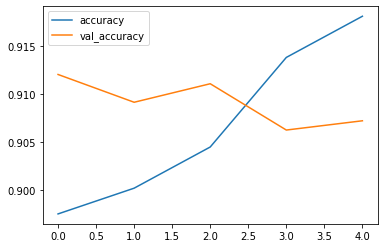

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

Epoch 1/5
9310/9310 [==============================] - 21s 2ms/step - loss: 0.1634 - accuracy: 0.9303 - val_loss: 0.2161 - val_accuracy: 0.9217
Epoch 2/5
9310/9310 [==============================] - 21s 2ms/step - loss: 0.1559 - accuracy: 0.9347 - val_loss: 0.2189 - val_accuracy: 0.9198
Epoch 3/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.1518 - accuracy: 0.9378 - val_loss: 0.2134 - val_accuracy: 0.9217
Epoch 4/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.1480 - accuracy: 0.9405 - val_loss: 0.2186 - val_accuracy: 0.9237
Epoch 5/5
9310/9310 [==============================] - 20s 2ms/step - loss: 0.1447 - accuracy: 0.9411 - val_loss: 0.2111 - val_accuracy: 0.9217


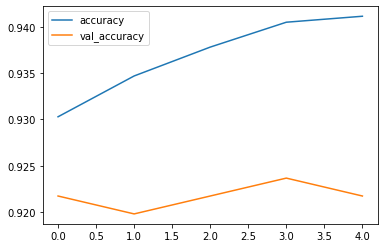

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

In [ ]:
model.save('/content/drive/MyDrive/dz/mod/model_raw_all.h5')
model.save_weights('/content/drive/MyDrive/dz/mod/model_raw_w_all.h5')

### Predict data and analyzis

### how predicted xTrain correspond to true yTrain

In [ ]:
yPred = model.predict(train) # to predict of train data

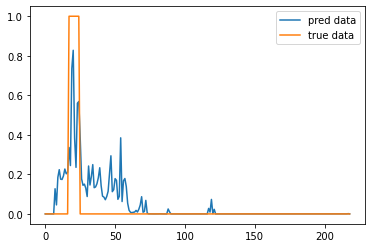

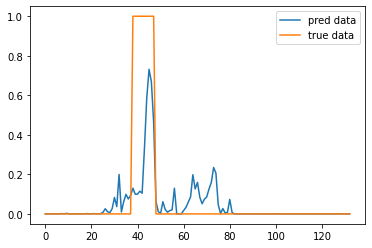

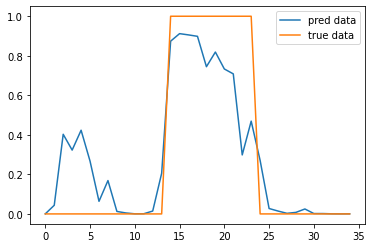

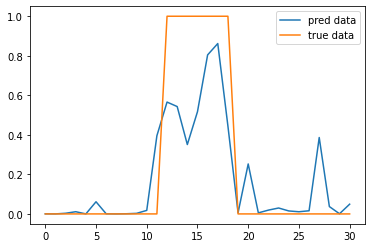

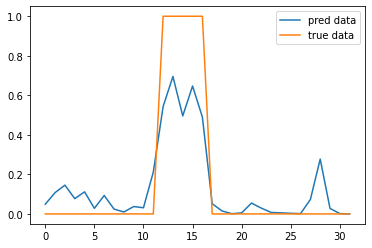

...

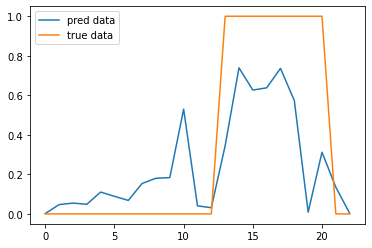

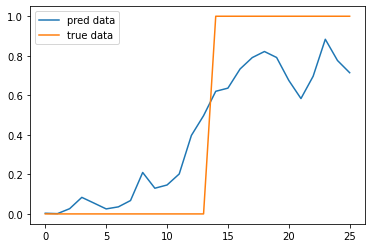

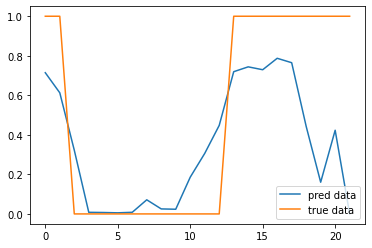

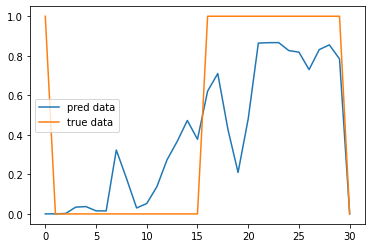

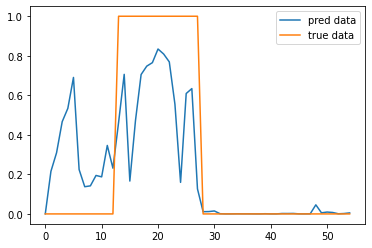

In [ ]:
plotCompare(yLittle2, yPred, lstOfTime)

### how predicted xTest correspond to true yTest

In [ ]:
yPred = model.predict(test) # to predict of test data

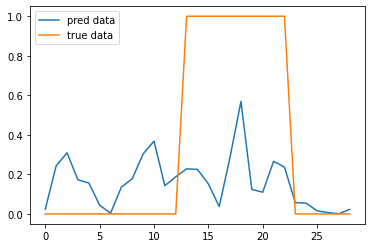

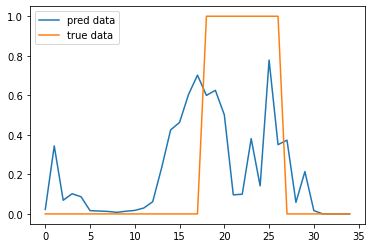

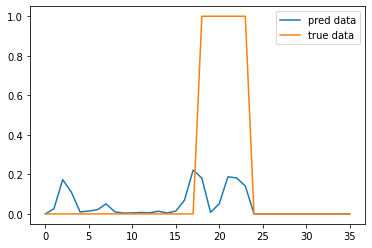

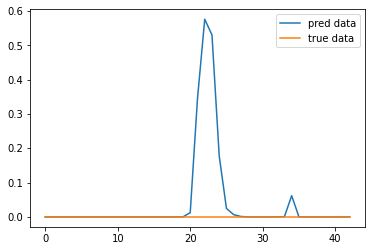

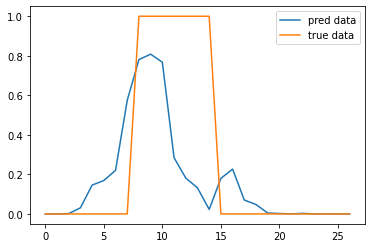

...

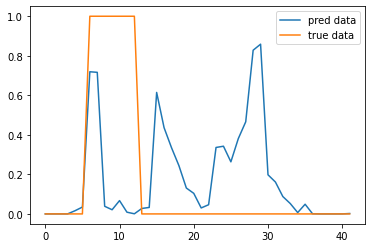

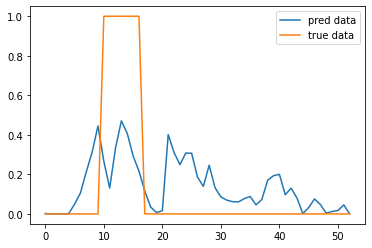

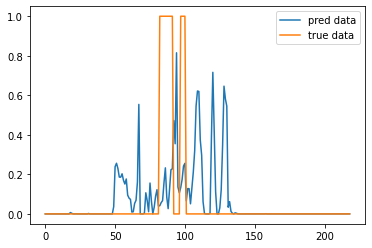

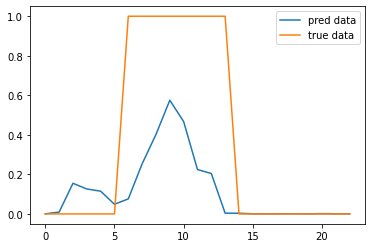

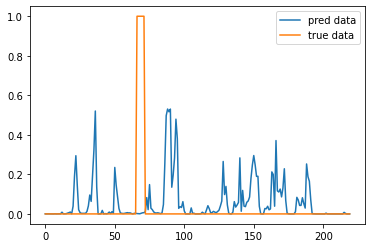

In [ ]:
plotCompare(yLittleTest2, yPred, lstOfTime_test)

In [ ]:
model.evaluate(test, yLittleTest2)

64/64 [==============================] - 0s 2ms/step - loss: 0.3693 - accuracy: 0.8675


[0.36927491426467896, 0.8675464391708374]

### Вывод

Блок из показателей даёт лучшие результаты по предсказанию и видимые различия между yPred, yTest



## classification model Dense for zero crossing rate

In [ ]:
model = Sequential()
model.add(Dense(256, activation='relu', input_shape=(x_train.shape[1],)))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))


In [ ]:
model.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_30 (Dense)            (None, 256)               512       
                                                                 
 dense_31 (Dense)            (None, 128)               32896     
                                                                 
 dense_32 (Dense)            (None, 64)                8256      
                                                                 
 dense_33 (Dense)            (None, 32)                2080      
                                                                 
 dense_34 (Dense)            (None, 1)                 33        
                                                                 
Total params: 43,777
Trainable params: 43,777
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#Компилируем сеть
model.compile(optimizer=Adam(lr=0.00001),
              loss='binary_crossentropy',
              metrics=['accuracy'])

Epoch 1/5
4733/4733 [==============================] - 56s 12ms/step - loss: 0.3237 - accuracy: 0.8995 - val_loss: 0.3237 - val_accuracy: 0.8995
Epoch 2/5
4733/4733 [==============================] - 54s 11ms/step - loss: 0.3237 - accuracy: 0.8995 - val_loss: 0.3237 - val_accuracy: 0.8995
Epoch 3/5
4733/4733 [==============================] - 55s 12ms/step - loss: 0.3237 - accuracy: 0.8995 - val_loss: 0.3238 - val_accuracy: 0.8995
Epoch 4/5
4733/4733 [==============================] - 54s 11ms/step - loss: 0.3237 - accuracy: 0.8995 - val_loss: 0.3238 - val_accuracy: 0.8995
Epoch 5/5
4733/4733 [==============================] - 54s 11ms/step - loss: 0.3237 - accuracy: 0.8995 - val_loss: 0.3237 - val_accuracy: 0.8995


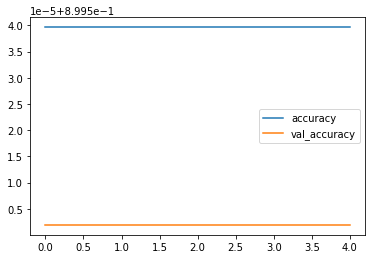

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1000,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

Epoch 1/5
4733/4733 [==============================] - 56s 12ms/step - loss: 0.3238 - accuracy: 0.8995 - val_loss: 0.3237 - val_accuracy: 0.8995
Epoch 2/5
4733/4733 [==============================] - 55s 12ms/step - loss: 0.3236 - accuracy: 0.8995 - val_loss: 0.3237 - val_accuracy: 0.8995
Epoch 3/5
4733/4733 [==============================] - 55s 12ms/step - loss: 0.3236 - accuracy: 0.8995 - val_loss: 0.3237 - val_accuracy: 0.8995
Epoch 4/5
4733/4733 [==============================] - 54s 11ms/step - loss: 0.3236 - accuracy: 0.8995 - val_loss: 0.3237 - val_accuracy: 0.8995
Epoch 5/5
4733/4733 [==============================] - 73s 15ms/step - loss: 0.3236 - accuracy: 0.8995 - val_loss: 0.3237 - val_accuracy: 0.8995


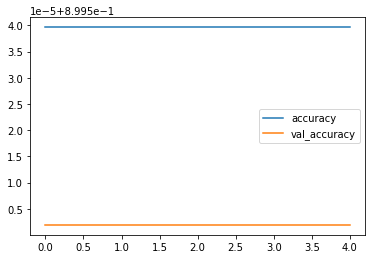

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1000,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

In [ ]:
model.save('/content/drive/MyDrive/dz/mod/model_raw_chromagram.h5')
model.save_weights('/content/drive/MyDrive/dz/mod/model_raw_w_chromagram.h5')

### Predict data and analyzis

### how predicted xTrain correspond to true yTrain

In [ ]:
yPred = model.predict(X_train_zero_crossings_i2) # to predict of train data

In [ ]:
yPred.shape

(5258304, 1)

In [ ]:
np.argwhere(z == 1)

array([[   8599],
       [   8600],
       [   8601],
       ...,
       [5241898],
       [5241899],
       [5241900]])

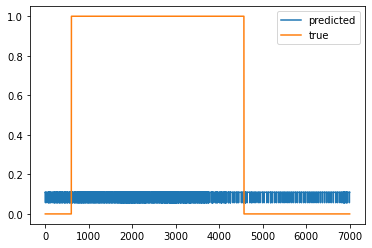

In [ ]:
plt.plot(yPred[8000:15000], label = 'predicted')
plt.plot(z[8000:15000], label = 'true')
plt.legend()
plt.show()

### Вывод

ZeroCrossRating показала точность 89,95

При этом видимых отличий на графиках yPred, yTrue нет



## Dense autoencoder

### Stft-spectors

### Autoencoder based on Dense layers for stft-spectors: 30 sounds

In [ ]:
input = Input(shape = (snd.shape[1],))
# encoder
x = Dense(256, activation="relu")(input)
x = Dense(128, activation="relu")(x)
x = Dense(64, activation="relu")(x)
x = Dense(32, activation="relu")(x)
x = Dense(16, activation="relu")(x)
x = Dense(8, activation="relu")(x)
x = Dense(4, activation="relu")(x)
x = Dense(2, activation="relu")(x)
# decoder
x = Dense(4, activation="relu")(x)
x = Dense(8, activation="relu")(x)
x = Dense(16, activation="relu")(x)
x = Dense(32, activation="relu")(x)
x = Dense(64, activation="relu")(x)
x = Dense(128, activation="relu")(x)
x = Dense(256, activation="relu")(x)

model_dense_stft = Model(input, x)

In [ ]:
model_dense_stft.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 256)]             0         
                                                                 
 dense_15 (Dense)            (None, 256)               65792     
                                                                 
 dense_16 (Dense)            (None, 128)               32896     
                                                                 
 dense_17 (Dense)            (None, 64)                8256      
                                                                 
 dense_18 (Dense)            (None, 32)                2080      
                                                                 
 dense_19 (Dense)            (None, 16)                528       
                                                                 
 dense_20 (Dense)            (None, 8)                 136 

In [ ]:
model_dense_stft.compile(optimizer=Adam(0.000001),
                  loss='mean_squared_error') # компилируем модель с оптимайзером Адам и среднеквадратичной ошибкой

Epoch 1/10
202/202 [==============================] - 2s 4ms/step - loss: 1.0058 - val_loss: 0.9598
Epoch 2/10
202/202 [==============================] - 1s 3ms/step - loss: 1.0058 - val_loss: 0.9598
Epoch 3/10
202/202 [==============================] - 1s 3ms/step - loss: 1.0058 - val_loss: 0.9598
Epoch 4/10
202/202 [==============================] - 1s 3ms/step - loss: 1.0058 - val_loss: 0.9598
Epoch 5/10
202/202 [==============================] - 1s 3ms/step - loss: 1.0058 - val_loss: 0.9598
Epoch 6/10
202/202 [==============================] - 1s 3ms/step - loss: 1.0058 - val_loss: 0.9598
Epoch 7/10
202/202 [==============================] - 1s 3ms/step - loss: 1.0058 - val_loss: 0.9598
Epoch 8/10
202/202 [==============================] - 1s 3ms/step - loss: 1.0058 - val_loss: 0.9598
Epoch 9/10
202/202 [==============================] - 1s 3ms/step - loss: 1.0058 - val_loss: 0.9598
Epoch 10/10
202/202 [==============================] - 1s 3ms/step - loss: 1.0058 - val_loss: 0.9598

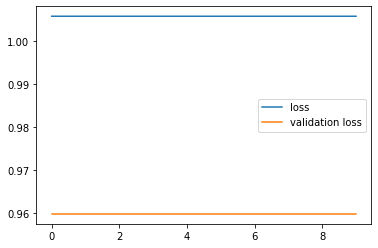

In [ ]:
history = model_dense_stft.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=10,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

Epoch 1/30
202/202 [==============================] - 3s 8ms/step - loss: 1.0058 - val_loss: 0.9598
Epoch 2/30
202/202 [==============================] - 1s 6ms/step - loss: 1.0058 - val_loss: 0.9598
Epoch 3/30
202/202 [==============================] - 1s 3ms/step - loss: 1.0058 - val_loss: 0.9598
Epoch 4/30
202/202 [==============================] - 1s 4ms/step - loss: 1.0058 - val_loss: 0.9598
Epoch 5/30
202/202 [==============================] - 1s 3ms/step - loss: 1.0058 - val_loss: 0.9598
Epoch 6/30
202/202 [==============================] - 1s 4ms/step - loss: 1.0058 - val_loss: 0.9598
Epoch 7/30
202/202 [==============================] - 1s 4ms/step - loss: 1.0058 - val_loss: 0.9598
Epoch 8/30
202/202 [==============================] - 1s 3ms/step - loss: 1.0058 - val_loss: 0.9598
Epoch 9/30
202/202 [==============================] - 1s 3ms/step - loss: 1.0058 - val_loss: 0.9598
Epoch 10/30
202/202 [==============================] - 1s 4ms/step - loss: 1.0058 - val_loss: 0.9598

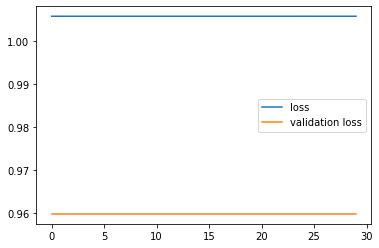

In [ ]:
history = model_dense_stft.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=30,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

In [ ]:
model_dense_stft.save('/content/drive/MyDrive/dz/mod/denseStft.h5')
model_dense_stft.save_weights('/content/drive/MyDrive/dz/mod/denseStftW.h5')

In [ ]:
predict_stft = model_dense_stft(train)

### Autoencoder based on Dense layers for stft-spectors: 120 sounds

In [ ]:
input = Input(shape = (snd.shape[1],))
# encoder
x = Dense(256, activation="relu")(input)
x = Dense(128, activation="relu")(x)
x = Dense(64, activation="relu")(x)
x = Dense(32, activation="relu")(x)
x = Dense(16, activation="relu")(x)
x = Dense(8, activation="relu")(x)
x = Dense(4, activation="relu")(x)
x = Dense(2, activation="relu")(x)
# decoder
x = Dense(4, activation="relu")(x)
x = Dense(8, activation="relu")(x)
x = Dense(16, activation="relu")(x)
x = Dense(32, activation="relu")(x)
x = Dense(64, activation="relu")(x)
x = Dense(128, activation="relu")(x)
x = Dense(256, activation="relu")(x)

model_dense_stft = Model(input, x)

In [ ]:
model_dense_stft.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 256)]             0         
                                                                 
 dense_30 (Dense)            (None, 256)               65792     
                                                                 
 dense_31 (Dense)            (None, 128)               32896     
                                                                 
 dense_32 (Dense)            (None, 64)                8256      
                                                                 
 dense_33 (Dense)            (None, 32)                2080      
                                                                 
 dense_34 (Dense)            (None, 16)                528       
                                                                 
 dense_35 (Dense)            (None, 8)                 136 

In [ ]:
model_dense_stft.compile(optimizer=Adam(0.000001),
                  loss='mean_squared_error') # компилируем модель с оптимайзером Адам и среднеквадратичной ошибкой

Epoch 1/10
968/968 [==============================] - 4s 4ms/step - loss: 1.0070 - val_loss: 0.9354
Epoch 2/10
968/968 [==============================] - 3s 3ms/step - loss: 1.0070 - val_loss: 0.9354
Epoch 3/10
968/968 [==============================] - 3s 3ms/step - loss: 1.0070 - val_loss: 0.9354
Epoch 4/10
968/968 [==============================] - 3s 3ms/step - loss: 1.0070 - val_loss: 0.9355
Epoch 5/10
968/968 [==============================] - 3s 3ms/step - loss: 1.0070 - val_loss: 0.9354
Epoch 6/10
968/968 [==============================] - 3s 3ms/step - loss: 1.0067 - val_loss: 0.9351
Epoch 7/10
968/968 [==============================] - 3s 3ms/step - loss: 1.0056 - val_loss: 0.9339
Epoch 8/10
968/968 [==============================] - 3s 3ms/step - loss: 1.0032 - val_loss: 0.9314
Epoch 9/10
968/968 [==============================] - 3s 3ms/step - loss: 0.9985 - val_loss: 0.9274
Epoch 10/10
968/968 [==============================] - 3s 3ms/step - loss: 0.9916 - val_loss: 0.9221

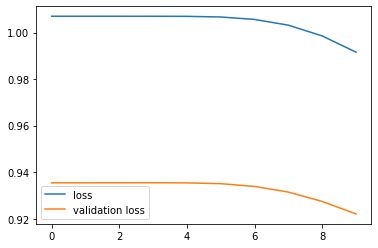

In [ ]:
history = model_dense_stft.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=10,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

Epoch 1/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9825 - val_loss: 0.9156
Epoch 2/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9721 - val_loss: 0.9087
Epoch 3/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9620 - val_loss: 0.9026
Epoch 4/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9529 - val_loss: 0.8976
Epoch 5/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9454 - val_loss: 0.8939
Epoch 6/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9393 - val_loss: 0.8909
Epoch 7/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9346 - val_loss: 0.8889
Epoch 8/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9312 - val_loss: 0.8878
Epoch 9/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9283 - val_loss: 0.8872
Epoch 10/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9263 - val_loss: 0.8870

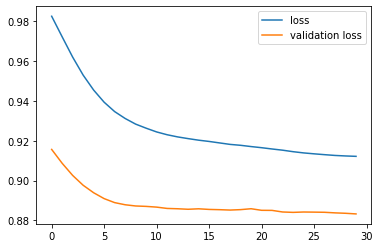

In [ ]:
history = model_dense_stft.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=30,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

Epoch 1/30
968/968 [==============================] - 4s 4ms/step - loss: 0.9117 - val_loss: 0.8833
Epoch 2/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9116 - val_loss: 0.8833
Epoch 3/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9116 - val_loss: 0.8833
Epoch 4/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9115 - val_loss: 0.8833
Epoch 5/30
968/968 [==============================] - 3s 4ms/step - loss: 0.9115 - val_loss: 0.8833
Epoch 6/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9115 - val_loss: 0.8833
Epoch 7/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9114 - val_loss: 0.8833
Epoch 8/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9114 - val_loss: 0.8833
Epoch 9/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9114 - val_loss: 0.8833
Epoch 10/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9113 - val_loss: 0.8833

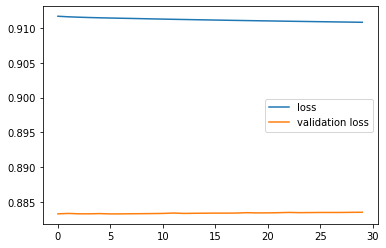

In [ ]:
history = model_dense_stft.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=30,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

In [ ]:
model_dense_stft.save('/content/drive/MyDrive/dz/mod/denseStft2.h5')
model_dense_stft.save_weights('/content/drive/MyDrive/dz/mod/denseStftW2.h5')

In [ ]:
predict_stft = model_dense_stft(train)

### Autoencoder based on Dense layers for stft-spectors: 150 sounds

In [ ]:
input = Input(shape = (snd.shape[1],))
# encoder
x = Dense(256, activation="relu")(input)
x = Dense(128, activation="relu")(x)
x = Dense(64, activation="relu")(x)
x = Dense(32, activation="relu")(x)
x = Dense(16, activation="relu")(x)
x = Dense(8, activation="relu")(x)
x = Dense(4, activation="relu")(x)
x = Dense(2, activation="relu")(x)
# decoder
x = Dense(4, activation="relu")(x)
x = Dense(8, activation="relu")(x)
x = Dense(16, activation="relu")(x)
x = Dense(32, activation="relu")(x)
x = Dense(64, activation="relu")(x)
x = Dense(128, activation="relu")(x)
x = Dense(256, activation="relu")(x)

model_dense_stft = Model(input, x)

In [ ]:
model_dense_stft.summary()

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 256)]             0         
                                                                 
 dense_45 (Dense)            (None, 256)               65792     
                                                                 
 dense_46 (Dense)            (None, 128)               32896     
                                                                 
 dense_47 (Dense)            (None, 64)                8256      
                                                                 
 dense_48 (Dense)            (None, 32)                2080      
                                                                 
 dense_49 (Dense)            (None, 16)                528       
                                                                 
 dense_50 (Dense)            (None, 8)                 136 

In [ ]:
model_dense_stft.compile(optimizer=Adam(0.000001),
                  loss='mean_squared_error') # компилируем модель с оптимайзером Адам и среднеквадратичной ошибкой

Epoch 1/10
1186/1186 [==============================] - 5s 4ms/step - loss: 0.9911 - val_loss: 1.0251
Epoch 2/10
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9535 - val_loss: 0.9895
Epoch 3/10
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9393 - val_loss: 0.9858
Epoch 4/10
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9370 - val_loss: 0.9842
Epoch 5/10
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9361 - val_loss: 0.9833
Epoch 6/10
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9356 - val_loss: 0.9828
Epoch 7/10
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9353 - val_loss: 0.9824
Epoch 8/10
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9352 - val_loss: 0.9822
Epoch 9/10
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9351 - val_loss: 0.9820
Epoch 10/10
1186/1186 [==============================] - 4s 3ms/step - loss: 0.935

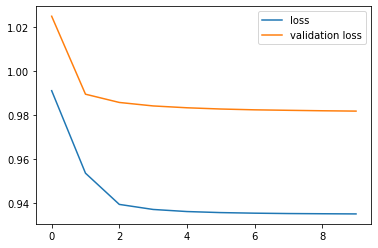

In [ ]:
history = model_dense_stft.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=10,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

Epoch 1/30
1186/1186 [==============================] - 5s 3ms/step - loss: 0.9348 - val_loss: 0.9818
Epoch 2/30
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9348 - val_loss: 0.9818
Epoch 3/30
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9348 - val_loss: 0.9818
Epoch 4/30
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9347 - val_loss: 0.9818
Epoch 5/30
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9347 - val_loss: 0.9818
Epoch 6/30
1186/1186 [==============================] - 3s 3ms/step - loss: 0.9347 - val_loss: 0.9817
Epoch 7/30
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9347 - val_loss: 0.9817
Epoch 8/30
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9347 - val_loss: 0.9817
Epoch 9/30
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9347 - val_loss: 0.9817
Epoch 10/30
1186/1186 [==============================] - 4s 3ms/step - loss: 0.934

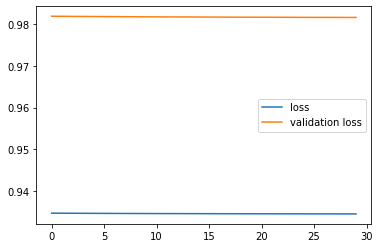

In [ ]:
history = model_dense_stft.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=30,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

Epoch 1/30
968/968 [==============================] - 4s 4ms/step - loss: 0.9117 - val_loss: 0.8833
Epoch 2/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9116 - val_loss: 0.8833
Epoch 3/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9116 - val_loss: 0.8833
Epoch 4/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9115 - val_loss: 0.8833
Epoch 5/30
968/968 [==============================] - 3s 4ms/step - loss: 0.9115 - val_loss: 0.8833
Epoch 6/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9115 - val_loss: 0.8833
Epoch 7/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9114 - val_loss: 0.8833
Epoch 8/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9114 - val_loss: 0.8833
Epoch 9/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9114 - val_loss: 0.8833
Epoch 10/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9113 - val_loss: 0.8833

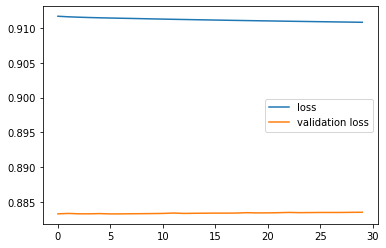

In [ ]:
history = model_dense_stft.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=30,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

In [ ]:
model_dense_stft.save('/content/drive/MyDrive/dz/mod/denseStft3.h5')
model_dense_stft.save_weights('/content/drive/MyDrive/dz/mod/denseStftW3.h5')

In [ ]:
predict_stft = model_dense_stft(train)

### Mfcc-spectors

### Autoencoder based on Dense layers for mfcc-spectors: 30 sounds

In [ ]:
input = Input(shape = (snd.shape[1],))
# encoder

x = Dense(32, activation="relu")(input)
x = Dense(16, activation="relu")(x)
x = Dense(8, activation="relu")(x)
x = Dense(4, activation="relu")(x)
x = Dense(2, activation="relu")(x)
# decoder
x = Dense(4, activation="relu")(x)
x = Dense(8, activation="relu")(x)
x = Dense(16, activation="relu")(x)
x = Dense(32, activation="relu")(x)


model_dense_mfcc = Model(input, x)

In [ ]:
model_dense_mfcc.summary()

Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 32)]              0         
                                                                 
 dense_54 (Dense)            (None, 32)                1056      
                                                                 
 dense_55 (Dense)            (None, 16)                528       
                                                                 
 dense_56 (Dense)            (None, 8)                 136       
                                                                 
 dense_57 (Dense)            (None, 4)                 36        
                                                                 
 dense_58 (Dense)            (None, 2)                 10        
                                                                 
 dense_59 (Dense)            (None, 4)                 12  

In [ ]:
model_dense_mfcc.compile(optimizer=Adam(0.00001),
                  loss='mean_squared_error') # компилируем модель с оптимайзером Адам и среднеквадратичной ошибкой

Epoch 1/10
208/208 [==============================] - 1s 4ms/step - loss: 1.0059 - val_loss: 0.9470
Epoch 2/10
208/208 [==============================] - 1s 3ms/step - loss: 1.0058 - val_loss: 0.9470
Epoch 3/10
208/208 [==============================] - 1s 3ms/step - loss: 1.0058 - val_loss: 0.9470
Epoch 4/10
208/208 [==============================] - 1s 3ms/step - loss: 1.0058 - val_loss: 0.9470
Epoch 5/10
208/208 [==============================] - 1s 3ms/step - loss: 1.0057 - val_loss: 0.9470
Epoch 6/10
208/208 [==============================] - 1s 3ms/step - loss: 1.0055 - val_loss: 0.9468
Epoch 7/10
208/208 [==============================] - 1s 3ms/step - loss: 1.0051 - val_loss: 0.9463
Epoch 8/10
208/208 [==============================] - 1s 3ms/step - loss: 1.0043 - val_loss: 0.9457
Epoch 9/10
208/208 [==============================] - 1s 3ms/step - loss: 1.0028 - val_loss: 0.9450
Epoch 10/10
208/208 [==============================] - 1s 3ms/step - loss: 1.0006 - val_loss: 0.9440

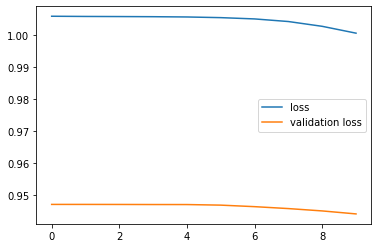

In [ ]:
history = model_dense_mfcc.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=10,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

Epoch 1/30
208/208 [==============================] - 1s 3ms/step - loss: 0.9977 - val_loss: 0.9429
Epoch 2/30
208/208 [==============================] - 1s 2ms/step - loss: 0.9943 - val_loss: 0.9418
Epoch 3/30
208/208 [==============================] - 1s 3ms/step - loss: 0.9907 - val_loss: 0.9403
Epoch 4/30
208/208 [==============================] - 1s 3ms/step - loss: 0.9874 - val_loss: 0.9391
Epoch 5/30
208/208 [==============================] - 1s 3ms/step - loss: 0.9848 - val_loss: 0.9385
Epoch 6/30
208/208 [==============================] - 1s 3ms/step - loss: 0.9827 - val_loss: 0.9380
Epoch 7/30
208/208 [==============================] - 1s 3ms/step - loss: 0.9810 - val_loss: 0.9377
Epoch 8/30
208/208 [==============================] - 1s 3ms/step - loss: 0.9798 - val_loss: 0.9375
Epoch 9/30
208/208 [==============================] - 1s 3ms/step - loss: 0.9787 - val_loss: 0.9370
Epoch 10/30
208/208 [==============================] - 1s 3ms/step - loss: 0.9778 - val_loss: 0.9366

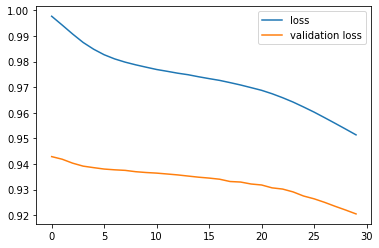

In [ ]:
history = model_dense_mfcc.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=30,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

Epoch 1/100
208/208 [==============================] - 1s 3ms/step - loss: 0.8663 - val_loss: 0.8291
Epoch 2/100
208/208 [==============================] - 1s 3ms/step - loss: 0.8660 - val_loss: 0.8284
Epoch 3/100
208/208 [==============================] - 1s 3ms/step - loss: 0.8657 - val_loss: 0.8285
Epoch 4/100
208/208 [==============================] - 1s 3ms/step - loss: 0.8654 - val_loss: 0.8273
Epoch 5/100
208/208 [==============================] - 1s 3ms/step - loss: 0.8651 - val_loss: 0.8274
Epoch 6/100
208/208 [==============================] - 1s 3ms/step - loss: 0.8648 - val_loss: 0.8272
Epoch 7/100
208/208 [==============================] - 1s 3ms/step - loss: 0.8647 - val_loss: 0.8273
Epoch 8/100
208/208 [==============================] - 1s 3ms/step - loss: 0.8643 - val_loss: 0.8269
Epoch 9/100
208/208 [==============================] - 1s 3ms/step - loss: 0.8640 - val_loss: 0.8266
Epoch 10/100
208/208 [==============================] - 1s 3ms/step - loss: 0.8636 - val_lo

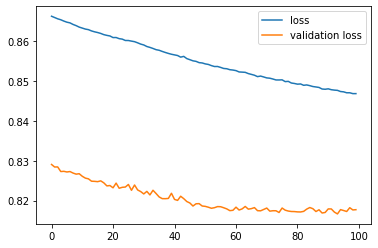

In [ ]:
history = model_dense_mfcc.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=100,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

Epoch 1/100
208/208 [==============================] - 2s 6ms/step - loss: 0.8460 - val_loss: 0.8178
Epoch 2/100
208/208 [==============================] - 1s 4ms/step - loss: 0.8458 - val_loss: 0.8179
Epoch 3/100
208/208 [==============================] - 1s 4ms/step - loss: 0.8457 - val_loss: 0.8179
Epoch 4/100
208/208 [==============================] - 1s 5ms/step - loss: 0.8456 - val_loss: 0.8180
Epoch 5/100
208/208 [==============================] - 1s 5ms/step - loss: 0.8455 - val_loss: 0.8179
Epoch 6/100
208/208 [==============================] - 1s 5ms/step - loss: 0.8455 - val_loss: 0.8179
Epoch 7/100
208/208 [==============================] - 1s 5ms/step - loss: 0.8454 - val_loss: 0.8178
Epoch 8/100
208/208 [==============================] - 1s 5ms/step - loss: 0.8454 - val_loss: 0.8179
Epoch 9/100
208/208 [==============================] - 1s 3ms/step - loss: 0.8453 - val_loss: 0.8178
Epoch 10/100
208/208 [==============================] - 1s 2ms/step - loss: 0.8453 - val_lo

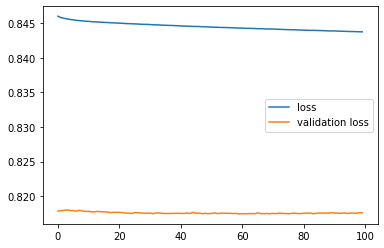

In [ ]:
history = model_dense_mfcc.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=100,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

In [ ]:
model_dense_mfcc.save('/content/drive/MyDrive/dz/mod/denseMfcc.h5')
model_dense_mfcc.save_weights('/content/drive/MyDrive/dz/mod/denseMfccW.h5')

In [ ]:
predict_mfcc = model_dense_mfcc(train)

### Autoencoder based on Dense layers for stft-spectors: 120 sounds

In [ ]:
input = Input(shape = (snd.shape[1],))
# encoder
x = Dense(40, activation="relu")(input)
x = Dense(32, activation="relu")(x)
x = Dense(16, activation="relu")(x)
x = Dense(8, activation="relu")(x)
x = Dense(4, activation="relu")(x)
x = Dense(2, activation="relu")(x)
# decoder
x = Dense(4, activation="relu")(x)
x = Dense(8, activation="relu")(x)
x = Dense(16, activation="relu")(x)
x = Dense(32, activation="relu")(x)
x = Dense(40, activation="linear")(x)

model_dense_mfcc = Model(input, x)

In [ ]:
model_dense_mfcc.summary()

In [ ]:
model_dense_mfcc.compile(optimizer=Adam(0.0001),
                  loss='mean_squared_error') # компилируем модель с оптимайзером Адам и среднеквадратичной ошибкой

In [ ]:
history = model_dense_mfcc.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=10,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

Epoch 1/50
960/960 [==============================] - 4s 4ms/step - loss: 0.9420 - val_loss: 0.9237
Epoch 2/50
960/960 [==============================] - 4s 4ms/step - loss: 0.9394 - val_loss: 0.9213
Epoch 3/50
960/960 [==============================] - 4s 4ms/step - loss: 0.9370 - val_loss: 0.9190
Epoch 4/50
960/960 [==============================] - 2s 2ms/step - loss: 0.9345 - val_loss: 0.9170
Epoch 5/50
960/960 [==============================] - 2s 3ms/step - loss: 0.9323 - val_loss: 0.9154
Epoch 6/50
960/960 [==============================] - 2s 2ms/step - loss: 0.9300 - val_loss: 0.9139
Epoch 7/50
960/960 [==============================] - 2s 2ms/step - loss: 0.9279 - val_loss: 0.9120
Epoch 8/50
960/960 [==============================] - 2s 2ms/step - loss: 0.9258 - val_loss: 0.9102
Epoch 9/50
960/960 [==============================] - 2s 2ms/step - loss: 0.9238 - val_loss: 0.9095
Epoch 10/50
960/960 [==============================] - 2s 2ms/step - loss: 0.9220 - val_loss: 0.9077

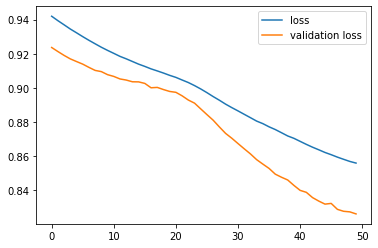

In [ ]:
history = model_dense_mfcc.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=50,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

Epoch 1/30
960/960 [==============================] - 3s 3ms/step - loss: 0.8535 - val_loss: 0.8255
Epoch 2/30
960/960 [==============================] - 3s 3ms/step - loss: 0.8532 - val_loss: 0.8251
Epoch 3/30
960/960 [==============================] - 2s 2ms/step - loss: 0.8529 - val_loss: 0.8250
Epoch 4/30
960/960 [==============================] - 2s 3ms/step - loss: 0.8528 - val_loss: 0.8250
Epoch 5/30
960/960 [==============================] - 2s 3ms/step - loss: 0.8526 - val_loss: 0.8247
Epoch 6/30
960/960 [==============================] - 2s 3ms/step - loss: 0.8524 - val_loss: 0.8248
Epoch 7/30
960/960 [==============================] - 3s 3ms/step - loss: 0.8523 - val_loss: 0.8246
Epoch 8/30
960/960 [==============================] - 2s 3ms/step - loss: 0.8522 - val_loss: 0.8245
Epoch 9/30
960/960 [==============================] - 3s 3ms/step - loss: 0.8520 - val_loss: 0.8244
Epoch 10/30
960/960 [==============================] - 2s 3ms/step - loss: 0.8519 - val_loss: 0.8243

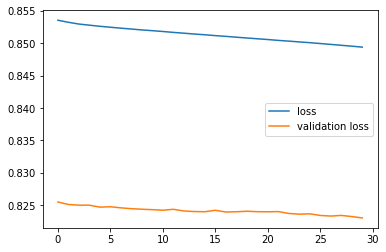

In [ ]:
history = model_dense_mfcc.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=30,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

Epoch 1/30
960/960 [==============================] - 6s 5ms/step - loss: 0.8490 - val_loss: 0.8231
Epoch 2/30
960/960 [==============================] - 4s 4ms/step - loss: 0.8490 - val_loss: 0.8231
Epoch 3/30
960/960 [==============================] - 4s 4ms/step - loss: 0.8490 - val_loss: 0.8231
Epoch 4/30
960/960 [==============================] - 2s 2ms/step - loss: 0.8490 - val_loss: 0.8231
Epoch 5/30
960/960 [==============================] - 2s 2ms/step - loss: 0.8490 - val_loss: 0.8231
Epoch 6/30
960/960 [==============================] - 2s 2ms/step - loss: 0.8489 - val_loss: 0.8231
Epoch 7/30
960/960 [==============================] - 2s 2ms/step - loss: 0.8489 - val_loss: 0.8231
Epoch 8/30
960/960 [==============================] - 2s 2ms/step - loss: 0.8489 - val_loss: 0.8231
Epoch 9/30
960/960 [==============================] - 2s 3ms/step - loss: 0.8489 - val_loss: 0.8231
Epoch 10/30
960/960 [==============================] - 2s 2ms/step - loss: 0.8489 - val_loss: 0.8230

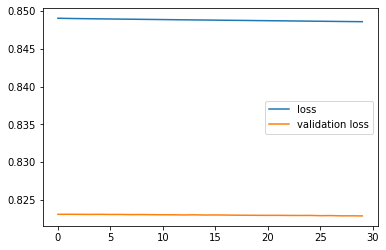

In [ ]:
history = model_dense_mfcc.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=30,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

In [ ]:
model_dense_mfcc.save('/content/drive/MyDrive/dz/mod/denseMfcc40.h5')
model_dense_mfcc.save_weights('/content/drive/MyDrive/dz/mod/denseMfccW40.h5')

In [ ]:
model_dense_mfcc = load_model('/content/drive/MyDrive/dz/mod/denseMfcc40.h5', compile = False)

In [ ]:
model_dense_mfcc.compile(optimizer=Adam(0.0001), loss='mean_squared_error') 

### autoencoder with linear

In [ ]:
input = Input(shape = (snd.shape[1],))
# encoder
x = Dense(40, activation="linear")(input)
x = Dense(32, activation="linear")(x)
x = Dense(16, activation="linear")(x)
x = Dense(8, activation="linear")(x)
x = Dense(4, activation="linear")(x)
x = Dense(2, activation="linear")(x)
# decoder
x = Dense(4, activation="linear")(x)
x = Dense(8, activation="linear")(x)
x = Dense(16, activation="linear")(x)
x = Dense(32, activation="linear")(x)
x = Dense(40, activation="linear")(x)
x = Dense(40, activation="linear")(x)

model_dense_mfcc_soft = Model(input, x)

In [ ]:
model_dense_mfcc_soft.summary()

Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 40)]              0         
                                                                 
 dense_46 (Dense)            (None, 40)                1640      
                                                                 
 dense_47 (Dense)            (None, 32)                1312      
                                                                 
 dense_48 (Dense)            (None, 16)                528       
                                                                 
 dense_49 (Dense)            (None, 8)                 136       
                                                                 
 dense_50 (Dense)            (None, 4)                 36        
                                                                 
 dense_51 (Dense)            (None, 2)                 10  

In [ ]:
model_dense_mfcc_soft.compile(optimizer=Adam(0.00001),
                  loss='mean_squared_error') # компилируем модель с оптимайзером Адам и среднеквадратичной ошибкой

Epoch 1/10
1073/1073 [==============================] - 8s 6ms/step - loss: 1.2812
Epoch 2/10
1073/1073 [==============================] - 5s 5ms/step - loss: 1.0840
Epoch 3/10
1073/1073 [==============================] - 4s 4ms/step - loss: 1.0225
Epoch 4/10
1073/1073 [==============================] - 3s 3ms/step - loss: 0.9936
Epoch 5/10
1073/1073 [==============================] - 3s 3ms/step - loss: 0.9743
Epoch 6/10
1073/1073 [==============================] - 3s 2ms/step - loss: 0.9580
Epoch 7/10
1073/1073 [==============================] - 3s 2ms/step - loss: 0.9427
Epoch 8/10
1073/1073 [==============================] - 3s 2ms/step - loss: 0.9290
Epoch 9/10
1073/1073 [==============================] - 3s 2ms/step - loss: 0.9176
Epoch 10/10
1073/1073 [==============================] - 3s 2ms/step - loss: 0.9089


KeyError: ignored

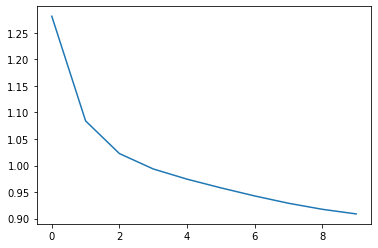

In [ ]:
history = model_dense_mfcc_soft.fit(snd, snd,
                    epochs=10,
                    batch_size=1,
                    #validation_data=([snd[val_mask]], [snd[val_mask]]))
                    )

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

Epoch 1/30
1073/1073 [==============================] - 5s 5ms/step - loss: 0.8940
Epoch 2/30
1073/1073 [==============================] - 5s 5ms/step - loss: 0.8900
Epoch 3/30
1073/1073 [==============================] - 5s 5ms/step - loss: 0.8865
Epoch 4/30
1073/1073 [==============================] - 6s 5ms/step - loss: 0.8834
Epoch 5/30
1073/1073 [==============================] - 5s 4ms/step - loss: 0.8807
Epoch 6/30
1073/1073 [==============================] - 5s 5ms/step - loss: 0.8782
Epoch 7/30
1073/1073 [==============================] - 5s 5ms/step - loss: 0.8759
Epoch 8/30
1073/1073 [==============================] - 6s 5ms/step - loss: 0.8739
Epoch 9/30
1073/1073 [==============================] - 5s 5ms/step - loss: 0.8721
Epoch 10/30
1073/1073 [==============================] - 5s 4ms/step - loss: 0.8705
Epoch 11/30
1073/1073 [==============================] - 3s 3ms/step - loss: 0.8690
Epoch 12/30
1073/1073 [==============================] - 3s 3ms/step - loss: 0.8677
E

KeyError: ignored

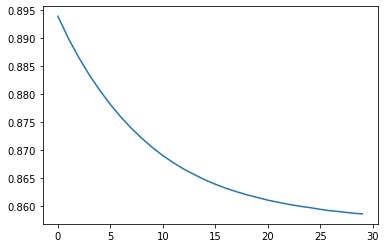

In [ ]:
history = model_dense_mfcc_soft.fit(snd, snd,
                    epochs=30,
                    batch_size=1,
                    #validation_data=([snd[val_mask]], [snd[val_mask]]))
                    )

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

Epoch 1/30
967/967 [==============================] - 5s 5ms/step - loss: 0.8813 - val_loss: 0.8495
Epoch 2/30
967/967 [==============================] - 5s 5ms/step - loss: 0.8797 - val_loss: 0.8491
Epoch 3/30
967/967 [==============================] - 5s 5ms/step - loss: 0.8781 - val_loss: 0.8488
Epoch 4/30
967/967 [==============================] - 3s 3ms/step - loss: 0.8767 - val_loss: 0.8485
Epoch 5/30
967/967 [==============================] - 3s 3ms/step - loss: 0.8753 - val_loss: 0.8485
Epoch 6/30
967/967 [==============================] - 3s 3ms/step - loss: 0.8739 - val_loss: 0.8485
Epoch 7/30
967/967 [==============================] - 3s 3ms/step - loss: 0.8727 - val_loss: 0.8486
Epoch 8/30
967/967 [==============================] - 2s 3ms/step - loss: 0.8715 - val_loss: 0.8485
Epoch 9/30
967/967 [==============================] - 3s 3ms/step - loss: 0.8705 - val_loss: 0.8487
Epoch 10/30
967/967 [==============================] - 3s 3ms/step - loss: 0.8695 - val_loss: 0.8489

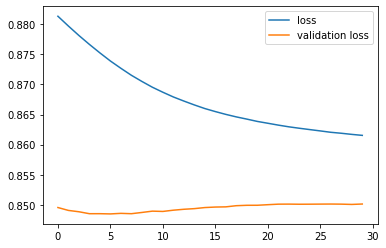

In [ ]:
history = model_dense_mfcc_soft.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=10,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

In [ ]:
predict_mfcc = model_dense_mfcc.predict(train)

In [ ]:
compare = model_dense_mfcc_soft.predict(testToCheck)

In [ ]:
plt.plot(yTest, label = 'yTest')
plt.plot(yPred, label = 'yPred')
plt.plot()

<function matplotlib.pyplot.show>

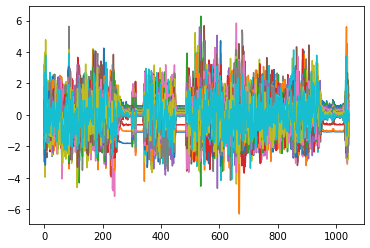

In [ ]:
plt.plot(comp2)
plt.show

In [ ]:
mse = np.mean(np.power(testToCheck - compare, 2), axis=1)

In [ ]:
print(testToCheck.shape, toCheckYTest.shape, toCheckYPred.shape)

(1043, 40) (1043,) (1043,)


In [ ]:
mse_normal = mse[toCheckYTest == 1]
mse_false = mse[toCheckYTest == 0]

In [ ]:
print("Минимальная ошибка нормальных транзакций:", round(min(mse_normal),4)) #найдем минимальную среднеквадратичную ошибку на нормальных операциях
print("Максимальная ошибка нормальных транзакций:", round(max(mse_normal),4)) #найдем максимальную среднеквадратичную ошибку на нормальных операциях
print("Средняя ошибка нормальных транзакций:", round(sum(mse_normal) / len(mse_normal),4)) # среднюю ошибку

Минимальная ошибка нормальных транзакций: 0.4378
Максимальная ошибка нормальных транзакций: 3.5834
Средняя ошибка нормальных транзакций: 1.3401


In [ ]:
print("Минимальная ошибка мошеннических транзакций:", round(min(mse_false),4)) #найдем минимальную среднеквадратичную ошибку на мошеннических операциях
print("Максимальная ошибка мошеннических транзакций:", round(max(mse_false),4)) #найдем максимальную среднеквадратичную ошибку на мошеннических операциях
print("Средняя ошибка мошеннических транзакций:", round(sum(mse_false) / len(mse_false),4)) # среднюю ошибку

Минимальная ошибка мошеннических транзакций: 0.0905
Максимальная ошибка мошеннических транзакций: 4.4633
Средняя ошибка мошеннических транзакций: 0.8243


In [ ]:
toCheckYPred = np.squeeze(toCheckYPred)

In [ ]:
mse_normal = mse[toCheckYPred > 0.7]
mse_false = mse[toCheckYPred <= 0.7]

In [ ]:
print("Минимальная ошибка нормальных транзакций:", round(min(mse_normal),4)) #найдем минимальную среднеквадратичную ошибку на нормальных операциях
print("Максимальная ошибка нормальных транзакций:", round(max(mse_normal),4)) #найдем максимальную среднеквадратичную ошибку на нормальных операциях
print("Средняя ошибка нормальных транзакций:", round(sum(mse_normal) / len(mse_normal),4)) # среднюю ошибку

Минимальная ошибка нормальных транзакций: 0.5814
Максимальная ошибка нормальных транзакций: 2.3875
Средняя ошибка нормальных транзакций: 1.3941


In [ ]:
print("Минимальная ошибка мошеннических транзакций:", round(min(mse_false),4)) #найдем минимальную среднеквадратичную ошибку на мошеннических операциях
print("Максимальная ошибка мошеннических транзакций:", round(max(mse_false),4)) #найдем максимальную среднеквадратичную ошибку на мошеннических операциях
print("Средняя ошибка мошеннических транзакций:", round(sum(mse_false) / len(mse_false),4)) # среднюю ошибку

Минимальная ошибка мошеннических транзакций: 0.0996
Максимальная ошибка мошеннических транзакций: 4.4874
Средняя ошибка мошеннических транзакций: 0.9249


### Autoencoder based on Dense layers for stft-spectors: 150 sounds

In [ ]:
input = Input(shape = (snd.shape[1],))
# encoder
x = Dense(256, activation="relu")(input)
x = Dense(128, activation="relu")(x)
x = Dense(64, activation="relu")(x)
x = Dense(32, activation="relu")(x)
x = Dense(16, activation="relu")(x)
x = Dense(8, activation="relu")(x)
x = Dense(4, activation="relu")(x)
x = Dense(2, activation="relu")(x)
# decoder
x = Dense(4, activation="relu")(x)
x = Dense(8, activation="relu")(x)
x = Dense(16, activation="relu")(x)
x = Dense(32, activation="relu")(x)
x = Dense(64, activation="relu")(x)
x = Dense(128, activation="relu")(x)
x = Dense(256, activation="relu")(x)

model_dense_mfcc = Model(input, x)

In [ ]:
model_dense_mfcc.summary()

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 256)]             0         
                                                                 
 dense_45 (Dense)            (None, 256)               65792     
                                                                 
 dense_46 (Dense)            (None, 128)               32896     
                                                                 
 dense_47 (Dense)            (None, 64)                8256      
                                                                 
 dense_48 (Dense)            (None, 32)                2080      
                                                                 
 dense_49 (Dense)            (None, 16)                528       
                                                                 
 dense_50 (Dense)            (None, 8)                 136 

In [ ]:
model_dense_mfcc.compile(optimizer=Adam(0.000001),
                  loss='mean_squared_error') # компилируем модель с оптимайзером Адам и среднеквадратичной ошибкой

Epoch 1/10
1186/1186 [==============================] - 5s 4ms/step - loss: 0.9911 - val_loss: 1.0251
Epoch 2/10
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9535 - val_loss: 0.9895
Epoch 3/10
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9393 - val_loss: 0.9858
Epoch 4/10
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9370 - val_loss: 0.9842
Epoch 5/10
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9361 - val_loss: 0.9833
Epoch 6/10
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9356 - val_loss: 0.9828
Epoch 7/10
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9353 - val_loss: 0.9824
Epoch 8/10
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9352 - val_loss: 0.9822
Epoch 9/10
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9351 - val_loss: 0.9820
Epoch 10/10
1186/1186 [==============================] - 4s 3ms/step - loss: 0.935

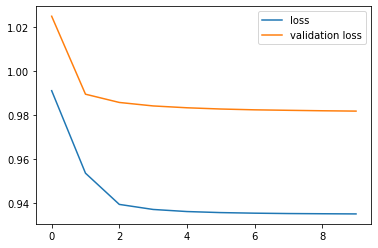

In [ ]:
history = model_dense_mfcc.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=10,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

Epoch 1/30
1186/1186 [==============================] - 5s 3ms/step - loss: 0.9348 - val_loss: 0.9818
Epoch 2/30
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9348 - val_loss: 0.9818
Epoch 3/30
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9348 - val_loss: 0.9818
Epoch 4/30
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9347 - val_loss: 0.9818
Epoch 5/30
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9347 - val_loss: 0.9818
Epoch 6/30
1186/1186 [==============================] - 3s 3ms/step - loss: 0.9347 - val_loss: 0.9817
Epoch 7/30
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9347 - val_loss: 0.9817
Epoch 8/30
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9347 - val_loss: 0.9817
Epoch 9/30
1186/1186 [==============================] - 4s 3ms/step - loss: 0.9347 - val_loss: 0.9817
Epoch 10/30
1186/1186 [==============================] - 4s 3ms/step - loss: 0.934

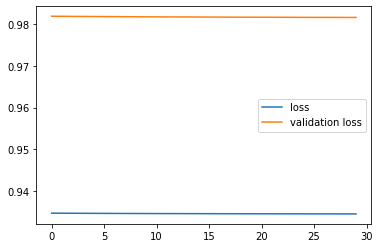

In [ ]:
history = model_dense_mfcc.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=30,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

Epoch 1/30
968/968 [==============================] - 4s 4ms/step - loss: 0.9117 - val_loss: 0.8833
Epoch 2/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9116 - val_loss: 0.8833
Epoch 3/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9116 - val_loss: 0.8833
Epoch 4/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9115 - val_loss: 0.8833
Epoch 5/30
968/968 [==============================] - 3s 4ms/step - loss: 0.9115 - val_loss: 0.8833
Epoch 6/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9115 - val_loss: 0.8833
Epoch 7/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9114 - val_loss: 0.8833
Epoch 8/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9114 - val_loss: 0.8833
Epoch 9/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9114 - val_loss: 0.8833
Epoch 10/30
968/968 [==============================] - 3s 3ms/step - loss: 0.9113 - val_loss: 0.8833

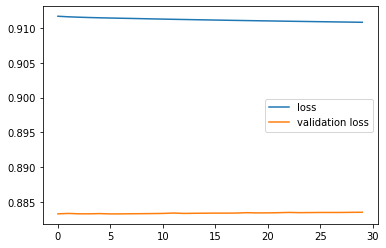

In [ ]:
history = model_dense_mfcc.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=30,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

In [ ]:
model_dense_mfcc.save('/content/drive/MyDrive/dz/mod/denseMfcc3.h5')
model_dense_mfcc.save_weights('/content/drive/MyDrive/dz/mod/denseMfccW3.h5')

In [ ]:
predict_mfcc = model_dense_mfcc(train)

### Mfcc-spectors based on clusterized sounds

In [ ]:
clustN0

### Autoencoder based on Dense layers for stft-spectors: not normalized 650 sounds - 0.9381

In [ ]:
snd = scal(clustNN1)

In [ ]:
train_mask, val_mask = mask(snd) # create train and validation sets for autoencoder

In [ ]:
input = Input(shape = (snd.shape[1],))
# encoder
x = Dense(40, activation="relu")(input)
x = Dense(32, activation="relu")(x)
x = Dense(16, activation="relu")(x)
x = Dense(8, activation="relu")(x)
x = Dense(4, activation="relu")(x)
x = Dense(2, activation="relu")(x)
# decoder
x = Dense(4, activation="relu")(x)
x = Dense(8, activation="relu")(x)
x = Dense(16, activation="relu")(x)
x = Dense(32, activation="relu")(x)
x = Dense(40, activation="linear")(x)

model_dense_mfcc = Model(input, x)

In [ ]:
model_dense_mfcc.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 40)]              0         
                                                                 
 dense (Dense)               (None, 40)                1640      
                                                                 
 dense_1 (Dense)             (None, 32)                1312      
                                                                 
 dense_2 (Dense)             (None, 16)                528       
                                                                 
 dense_3 (Dense)             (None, 8)                 136       
                                                                 
 dense_4 (Dense)             (None, 4)                 36        
                                                                 
 dense_5 (Dense)             (None, 2)                 10    

In [ ]:
model_dense_mfcc.compile(optimizer=Adam(0.00001),
                  loss='mean_squared_error') # компилируем модель с оптимайзером Адам и среднеквадратичной ошибкой

Epoch 1/10
592/592 [==============================] - 3s 3ms/step - loss: 0.9926 - val_loss: 1.0707
Epoch 2/10
592/592 [==============================] - 1s 2ms/step - loss: 0.9896 - val_loss: 1.0644
Epoch 3/10
592/592 [==============================] - 1s 2ms/step - loss: 0.9788 - val_loss: 1.0456
Epoch 4/10
592/592 [==============================] - 1s 3ms/step - loss: 0.9651 - val_loss: 1.0300
Epoch 5/10
592/592 [==============================] - 1s 2ms/step - loss: 0.9550 - val_loss: 1.0186
Epoch 6/10
592/592 [==============================] - 1s 2ms/step - loss: 0.9471 - val_loss: 1.0084
Epoch 7/10
592/592 [==============================] - 1s 2ms/step - loss: 0.9400 - val_loss: 0.9987
Epoch 8/10
592/592 [==============================] - 1s 2ms/step - loss: 0.9336 - val_loss: 0.9912
Epoch 9/10
592/592 [==============================] - 1s 2ms/step - loss: 0.9280 - val_loss: 0.9843
Epoch 10/10
592/592 [==============================] - 1s 2ms/step - loss: 0.9232 - val_loss: 0.9789

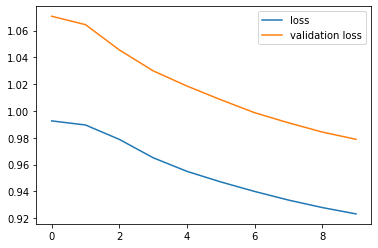

In [ ]:
history = model_dense_mfcc.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=10,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

Epoch 1/50
592/592 [==============================] - 3s 4ms/step - loss: 0.9195 - val_loss: 0.9754
Epoch 2/50
592/592 [==============================] - 1s 2ms/step - loss: 0.9165 - val_loss: 0.9720
Epoch 3/50
592/592 [==============================] - 1s 2ms/step - loss: 0.9140 - val_loss: 0.9698
Epoch 4/50
592/592 [==============================] - 2s 3ms/step - loss: 0.9120 - val_loss: 0.9681
Epoch 5/50
592/592 [==============================] - 2s 3ms/step - loss: 0.9103 - val_loss: 0.9658
Epoch 6/50
592/592 [==============================] - 2s 3ms/step - loss: 0.9087 - val_loss: 0.9644
Epoch 7/50
592/592 [==============================] - 1s 2ms/step - loss: 0.9073 - val_loss: 0.9627
Epoch 8/50
592/592 [==============================] - 1s 2ms/step - loss: 0.9061 - val_loss: 0.9623
Epoch 9/50
592/592 [==============================] - 1s 2ms/step - loss: 0.9050 - val_loss: 0.9611
Epoch 10/50
592/592 [==============================] - 1s 2ms/step - loss: 0.9040 - val_loss: 0.9602

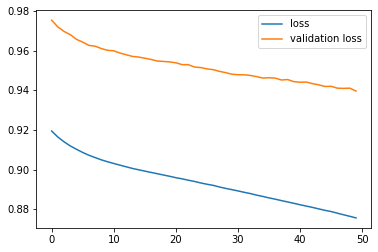

In [ ]:
history = model_dense_mfcc.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=50,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

Epoch 1/30
592/592 [==============================] - 4s 5ms/step - loss: 0.8740 - val_loss: 0.9397
Epoch 2/30
592/592 [==============================] - 3s 5ms/step - loss: 0.8739 - val_loss: 0.9397
Epoch 3/30
592/592 [==============================] - 3s 5ms/step - loss: 0.8738 - val_loss: 0.9397
Epoch 4/30
592/592 [==============================] - 3s 5ms/step - loss: 0.8737 - val_loss: 0.9396
Epoch 5/30
592/592 [==============================] - 2s 4ms/step - loss: 0.8736 - val_loss: 0.9397
Epoch 6/30
592/592 [==============================] - 1s 2ms/step - loss: 0.8735 - val_loss: 0.9395
Epoch 7/30
592/592 [==============================] - 1s 2ms/step - loss: 0.8734 - val_loss: 0.9395
Epoch 8/30
592/592 [==============================] - 1s 2ms/step - loss: 0.8733 - val_loss: 0.9395
Epoch 9/30
592/592 [==============================] - 1s 2ms/step - loss: 0.8732 - val_loss: 0.9394
Epoch 10/30
592/592 [==============================] - 1s 3ms/step - loss: 0.8731 - val_loss: 0.9394

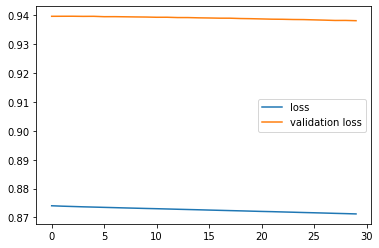

In [ ]:
history = model_dense_mfcc.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=30,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

In [ ]:
model_dense_mfcc.save('/content/drive/MyDrive/dz/mod/denseMfcc40_clust1.h5')
model_dense_mfcc.save_weights('/content/drive/MyDrive/dz/mod/denseMfccW40_clust1.h5')

In [ ]:
model_dense_mfcc = load_model('/content/drive/MyDrive/dz/mod/denseMfcc40_clist1.h5', compile = False)

In [ ]:
model_dense_mfcc.compile(optimizer=Adam(0.0001), loss='mean_squared_error') 

### Autoencoder based on Dense layers for stft-spectors: normalized 738 sounds - 0.84

In [ ]:
snd = scal(clustN0)

In [ ]:
train_mask, val_mask = mask(snd) # create train and validation sets for autoencoder

In [ ]:
input = Input(shape = (snd.shape[1],))
# encoder
x = Dense(40, activation="relu")(input)
x = Dense(32, activation="relu")(x)
x = Dense(16, activation="relu")(x)
x = Dense(8, activation="relu")(x)
x = Dense(4, activation="relu")(x)
x = Dense(2, activation="relu")(x)
# decoder
x = Dense(4, activation="relu")(x)
x = Dense(8, activation="relu")(x)
x = Dense(16, activation="relu")(x)
x = Dense(32, activation="relu")(x)
x = Dense(40, activation="linear")(x)

model_dense_mfcc = Model(input, x)

In [ ]:
model_dense_mfcc.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 40)]              0         
                                                                 
 dense_11 (Dense)            (None, 40)                1640      
                                                                 
 dense_12 (Dense)            (None, 32)                1312      
                                                                 
 dense_13 (Dense)            (None, 16)                528       
                                                                 
 dense_14 (Dense)            (None, 8)                 136       
                                                                 
 dense_15 (Dense)            (None, 4)                 36        
                                                                 
 dense_16 (Dense)            (None, 2)                 10  

In [ ]:
model_dense_mfcc.compile(optimizer=Adam(0.00001),
                  loss='mean_squared_error') # компилируем модель с оптимайзером Адам и среднеквадратичной ошибкой

Epoch 1/50
642/642 [==============================] - 2s 3ms/step - loss: 0.9774 - val_loss: 0.9698
Epoch 2/50
642/642 [==============================] - 2s 3ms/step - loss: 0.9715 - val_loss: 0.9666
Epoch 3/50
642/642 [==============================] - 2s 2ms/step - loss: 0.9675 - val_loss: 0.9637
Epoch 4/50
642/642 [==============================] - 2s 2ms/step - loss: 0.9643 - val_loss: 0.9616
Epoch 5/50
642/642 [==============================] - 2s 2ms/step - loss: 0.9617 - val_loss: 0.9594
Epoch 6/50
642/642 [==============================] - 2s 3ms/step - loss: 0.9594 - val_loss: 0.9577
Epoch 7/50
642/642 [==============================] - 2s 2ms/step - loss: 0.9574 - val_loss: 0.9563
Epoch 8/50
642/642 [==============================] - 2s 2ms/step - loss: 0.9557 - val_loss: 0.9549
Epoch 9/50
642/642 [==============================] - 2s 2ms/step - loss: 0.9542 - val_loss: 0.9534
Epoch 10/50
642/642 [==============================] - 2s 2ms/step - loss: 0.9528 - val_loss: 0.9522

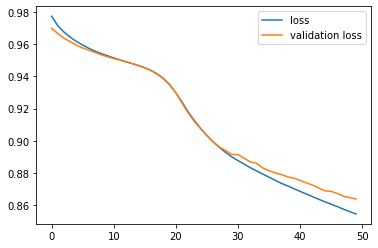

In [ ]:
history = model_dense_mfcc.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=50,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

Epoch 1/50
642/642 [==============================] - 2s 3ms/step - loss: 0.8529 - val_loss: 0.8616
Epoch 2/50
642/642 [==============================] - 2s 2ms/step - loss: 0.8513 - val_loss: 0.8614
Epoch 3/50
642/642 [==============================] - 2s 3ms/step - loss: 0.8500 - val_loss: 0.8599
Epoch 4/50
642/642 [==============================] - 2s 3ms/step - loss: 0.8486 - val_loss: 0.8592
Epoch 5/50
642/642 [==============================] - 2s 2ms/step - loss: 0.8471 - val_loss: 0.8583
Epoch 6/50
642/642 [==============================] - 2s 2ms/step - loss: 0.8458 - val_loss: 0.8579
Epoch 7/50
642/642 [==============================] - 2s 3ms/step - loss: 0.8447 - val_loss: 0.8563
Epoch 8/50
642/642 [==============================] - 2s 2ms/step - loss: 0.8433 - val_loss: 0.8559
Epoch 9/50
642/642 [==============================] - 2s 2ms/step - loss: 0.8420 - val_loss: 0.8557
Epoch 10/50
642/642 [==============================] - 2s 2ms/step - loss: 0.8410 - val_loss: 0.8539

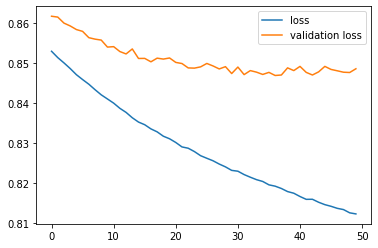

In [ ]:
history = model_dense_mfcc.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=50,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

Epoch 1/50
642/642 [==============================] - 6s 6ms/step - loss: 0.8097 - val_loss: 0.8484
Epoch 2/50
642/642 [==============================] - 4s 6ms/step - loss: 0.8095 - val_loss: 0.8479
Epoch 3/50
642/642 [==============================] - 4s 7ms/step - loss: 0.8093 - val_loss: 0.8478
Epoch 4/50
642/642 [==============================] - 4s 6ms/step - loss: 0.8092 - val_loss: 0.8479
Epoch 5/50
642/642 [==============================] - 5s 8ms/step - loss: 0.8091 - val_loss: 0.8479
Epoch 6/50
642/642 [==============================] - 4s 6ms/step - loss: 0.8090 - val_loss: 0.8481
Epoch 7/50
642/642 [==============================] - 3s 4ms/step - loss: 0.8089 - val_loss: 0.8480
Epoch 8/50
642/642 [==============================] - 3s 5ms/step - loss: 0.8089 - val_loss: 0.8479
Epoch 9/50
642/642 [==============================] - 4s 6ms/step - loss: 0.8088 - val_loss: 0.8480
Epoch 10/50
642/642 [==============================] - 3s 5ms/step - loss: 0.8087 - val_loss: 0.8478

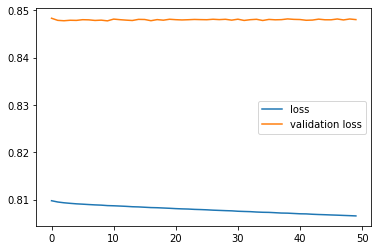

In [ ]:
history = model_dense_mfcc.fit([snd[train_mask]], [snd[train_mask]],
                    epochs=50,
                    batch_size=1,
                    validation_data=([snd[val_mask]], [snd[val_mask]]))
                    

plt.plot(history.history["loss"], label = 'loss')
plt.plot(history.history["val_loss"], label = 'validation loss')
plt.legend()
plt.show()

In [ ]:
model_dense_mfcc.save('/content/drive/MyDrive/dz/mod/denseMfcc40_clust2.h5')
model_dense_mfcc.save_weights('/content/drive/MyDrive/dz/mod/denseMfccW40_clust2.h5')

In [ ]:
model_dense_mfcc = load_model('/content/drive/MyDrive/dz/mod/denseMfcc40_clist1.h5', compile = False)

In [ ]:
model_dense_mfcc.compile(optimizer=Adam(0.0001), loss='mean_squared_error') 

## classification model Dense for stft

### simple Dense

In [ ]:
x_train.shape

(332, 111742)

In [ ]:
model = Sequential()
model.add(Dense(256, activation='relu', input_shape=(x_train.shape[1],)))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))


In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               65792     
                                                                 
 dense_1 (Dense)             (None, 128)               32896     
                                                                 
 dense_2 (Dense)             (None, 64)                8256      
                                                                 
 dense_3 (Dense)             (None, 32)                2080      
                                                                 
 dense_4 (Dense)             (None, 1)                 33        
                                                                 
Total params: 109,057
Trainable params: 109,057
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#Компилируем сеть
model.compile(optimizer=Adam(lr=0.0001),
              loss='binary_crossentropy',
              metrics=['accuracy'])

Epoch 1/5
9315/9315 [==============================] - 39s 4ms/step - loss: 0.2086 - accuracy: 0.9095 - val_loss: 0.1824 - val_accuracy: 0.9208
Epoch 2/5
9315/9315 [==============================] - 37s 4ms/step - loss: 0.1586 - accuracy: 0.9313 - val_loss: 0.1779 - val_accuracy: 0.9237
Epoch 3/5
9315/9315 [==============================] - 35s 4ms/step - loss: 0.1351 - accuracy: 0.9425 - val_loss: 0.1630 - val_accuracy: 0.9314
Epoch 4/5
9315/9315 [==============================] - 34s 4ms/step - loss: 0.1152 - accuracy: 0.9500 - val_loss: 0.1664 - val_accuracy: 0.9324
Epoch 5/5
9315/9315 [==============================] - 34s 4ms/step - loss: 0.0991 - accuracy: 0.9600 - val_loss: 0.1778 - val_accuracy: 0.9295


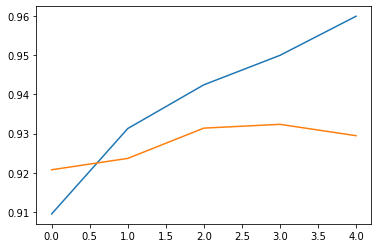

In [ ]:
history = model.fit(x_train,
                    y_train,
                    epochs=5,
                    batch_size=1,
                    validation_data=(x_test, y_test))

#Выводим график точности распознавания на обучающей и проверочной выборках
plt.plot(history.history["accuracy"], label = 'accuracy')
plt.plot(history.history["val_accuracy"], label = 'val_accuracy')
plt.legend()
plt.show()

In [ ]:
model.save('/content/drive/MyDrive/dz/mod/model_raw2.h5')
model.save_weights('/content/drive/MyDrive/dz/mod/model_raw_w2.h5')

### Predict data and analyzis

In [ ]:
lstOfTime

array([218, 132,  34,  30,  31,  31,  39,  73,  38,  41, 218,  35,  47,
        42,  35,  39,  42,  50,  76,  51,  43,  40, 218, 218,  49,  73,
        35, 209, 214, 218, 218,  77,  74,  75,  52, 134,  29,  91, 218,
        43,  44,  50, 219, 219, 218,  70,  31,  85,  33,  65,  65,  35,
       219, 218,  29,  34,  28,  30,  30,  73,  26,  30,  25, 218, 218,
       218,  87,  61,  44,  40,  28,  20,  49,  29,  23,  65,  24,  21,
        29,  53, 218,  48, 208,  56,  34,  38,  35,  48,  40, 218,  42,
        35,  82,  59,  72, 134,  94, 218,  60, 132, 218, 218,  55, 218,
        56, 211,  25,  25,  25,  22,  29,  41,  26,  88,  87, 206,  19,
        24,  22,  25,  21,  30,  55])

In [ ]:
lstOfTime_test

array([ 28,  34,  35,  42,  26,  31,  79,  35,  38,  42,  31,  86, 218,
        31,  31, 215,  60,  62,  30,  58,  29,  77,  53,  92,  31,  41,
        52, 218,  22, 220])

In [ ]:
yPred = model.predict(train) # to predict of train data

In [ ]:
yLittleTest[:28] # example of first word in yTest; 1 is a sound [ai]

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 0., 0., 0., 0., 0.], dtype=float32)

In [ ]:
yPred[:28] # example of first predicted word in yTest

array([[7.4353915e-17],
       [4.6034753e-03],
       [9.3390989e-01],
       [1.3404596e-01],
       [5.9467554e-04],
       [5.6304525e-05],
       [2.5066700e-07],
       [2.6293512e-05],
       [1.6408890e-02],
       [2.0263076e-02],
       [3.6823046e-01],
       [3.3331078e-01],
       [2.7089000e-02],
       [7.0400131e-01],
       [7.1046019e-01],
       [7.0993727e-01],
       [8.9237541e-02],
       [7.5409091e-01],
       [1.9223154e-02],
       [8.6383134e-02],
       [2.8905272e-03],
       [7.5590611e-04],
       [1.1667854e-05],
       [3.5085521e-11],
       [2.2023738e-07],
       [6.2829554e-03],
       [1.3569666e-08],
       [7.4353915e-17]], dtype=float32)

### how predicted data are corresponded to true data

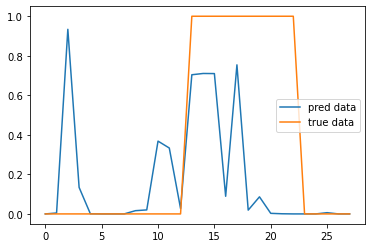

In [ ]:
# for a first test word
plt.plot(yPred[:29], label = 'pred data')
plt.plot(yLittleTest[:29], label = 'true data')
plt.legend()
plt.show()

### how predicted xTrain correspond to true yTrain

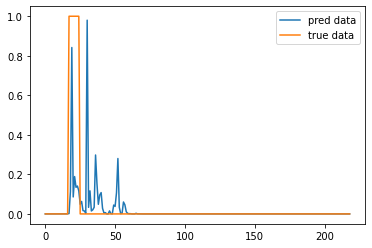

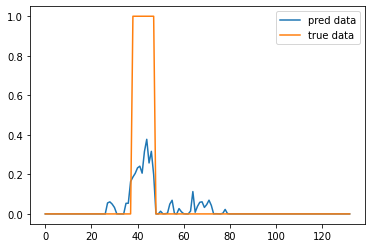

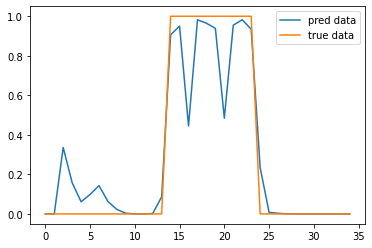

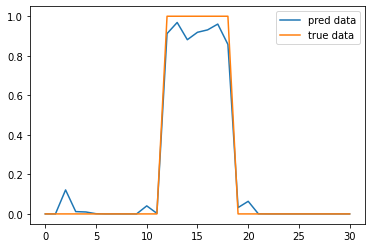

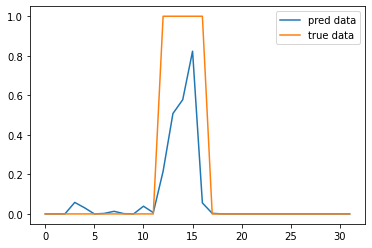

...

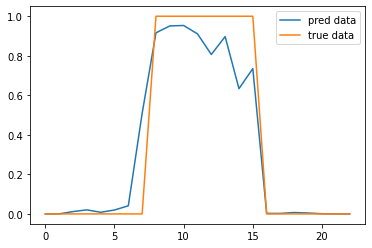

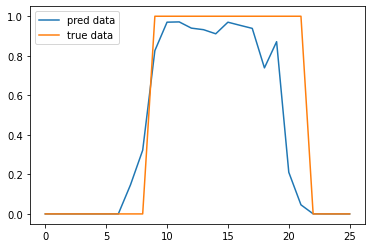

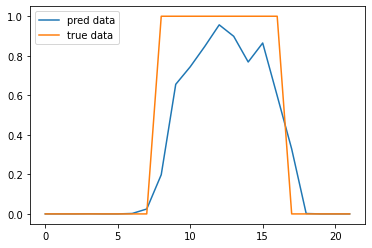

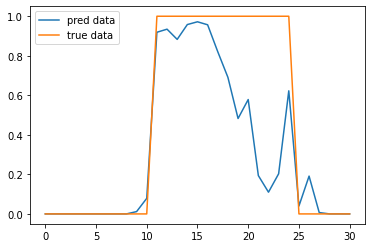

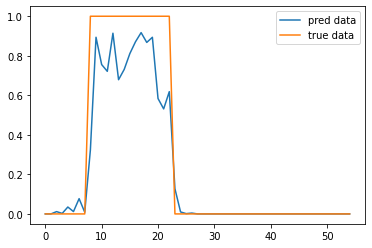

In [ ]:
sum = 0
for i in range(len(k)):
  plt.plot(yPred[sum:sum + k[i]+1], label = 'pred data')
  plt.plot(yLittle[sum:sum + k[i]+1], label = 'true data')
  sum += k[i]
  plt.legend()
  plt.show()


### how predicted xTest correspond to true yTest

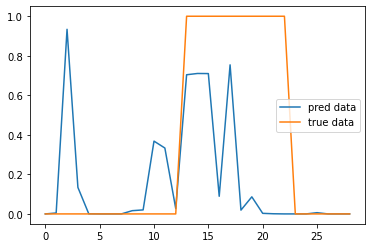

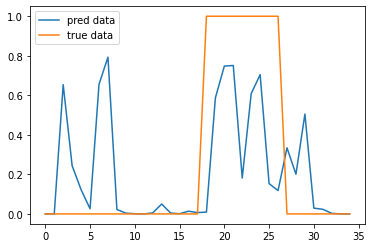

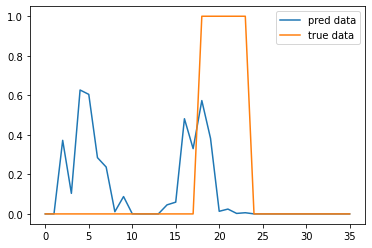

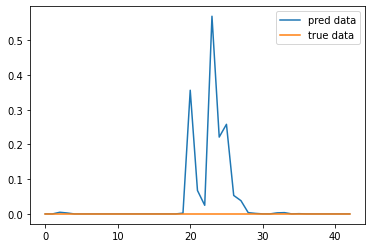

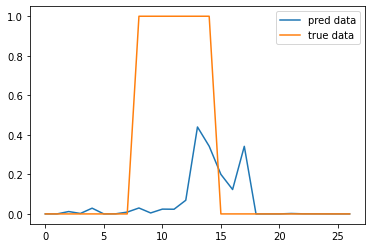

...

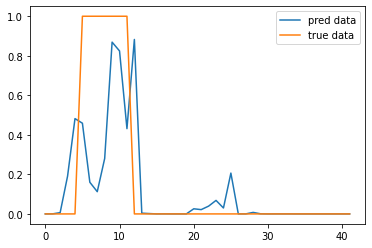

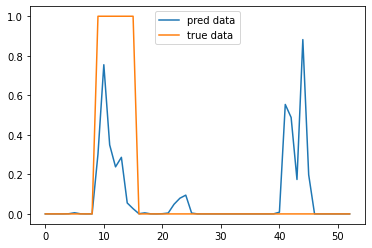

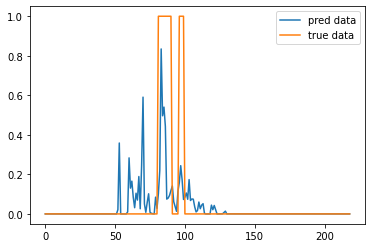

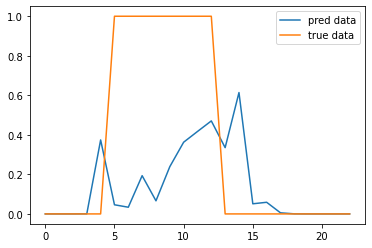

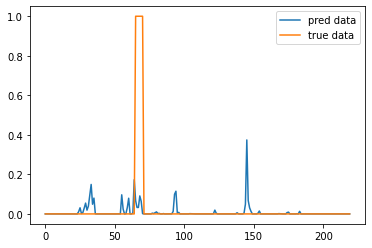

In [ ]:
plotCompare(yLittleTest, yPred, lstOfTime_test)

### autoencoder's predict xTrain: 30 sounds

In [ ]:

model = load_model('/content/drive/MyDrive/dz/mod/model_raw2.h5', compile = False)

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               65792     
                                                                 
 dense_1 (Dense)             (None, 128)               32896     
                                                                 
 dense_2 (Dense)             (None, 64)                8256      
                                                                 
 dense_3 (Dense)             (None, 32)                2080      
                                                                 
 dense_4 (Dense)             (None, 1)                 33        
                                                                 
Total params: 109,057
Trainable params: 109,057
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#Компилируем сеть
model.compile(optimizer=Adam(lr=0.0001),
              loss='binary_crossentropy',
              metrics=['accuracy'])

### Predict data and analyzis

In [ ]:
yPred = model.predict(predict_stft) # to predict of train data

In [ ]:
train

array([[-1.2690876 , -1.5614367 , -1.5800195 , ...,  0.24941999,
         0.26860327,  0.27855727],
       [-1.2690876 , -1.5614367 , -1.5800195 , ...,  0.24941999,
         0.26860327,  0.27855727],
       [-1.2690876 , -1.5614367 , -1.5800195 , ...,  0.24941999,
         0.26860327,  0.27855727],
       ...,
       [ 1.363855  ,  1.1231521 ,  0.33931208, ..., -0.9415999 ,
        -0.9376004 , -0.9323771 ],
       [ 0.9255713 ,  0.12960997, -0.878832  , ..., -0.9415999 ,
        -0.9376004 , -0.9323771 ],
       [-0.9809085 , -1.0507221 , -1.3225898 , ..., -0.9415999 ,
        -0.9376004 , -0.9323771 ]], dtype=float32)

In [ ]:
predict_stft

<tf.Tensor: shape=(10350, 256), dtype=float32, numpy=
array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)>

In [ ]:
yPred

array([[0.12583742],
       [0.12583742],
       [0.12583742],
       ...,
       [0.12583742],
       [0.12583742],
       [0.12583742]], dtype=float32)

### how predicted xTrain correspond to true yTrain

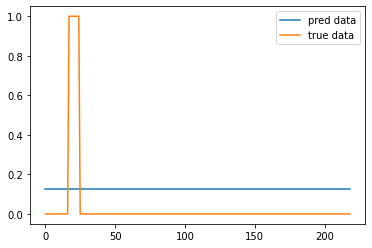

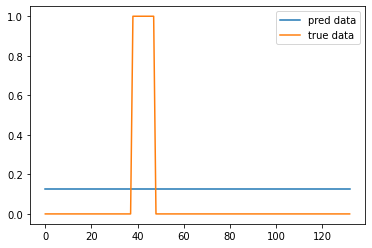

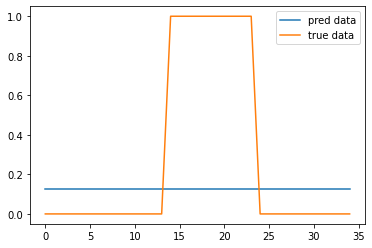

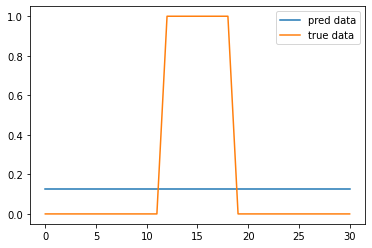

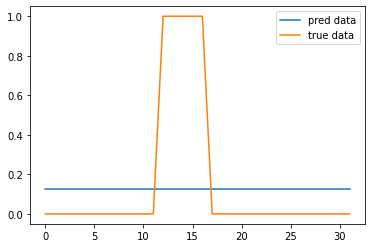

...

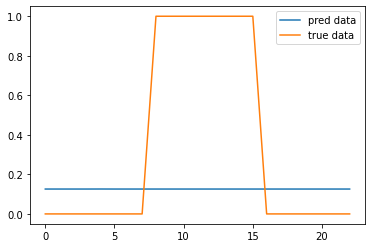

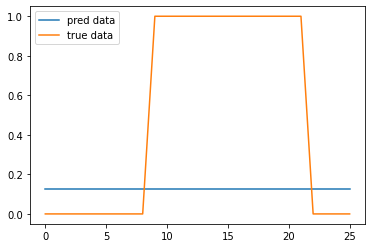

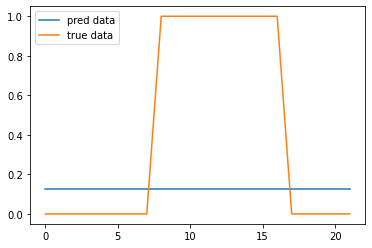

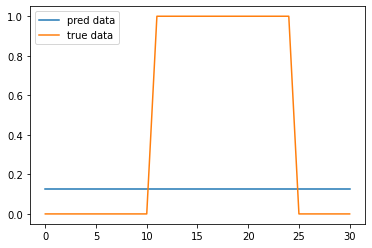

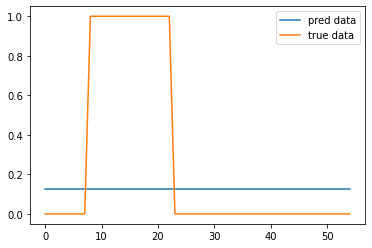

In [ ]:
plotCompare(yLittle, yPred, lstOfTime)


### how predicted xTest correspond to true yTest

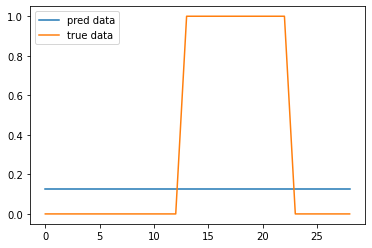

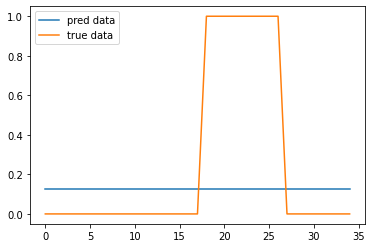

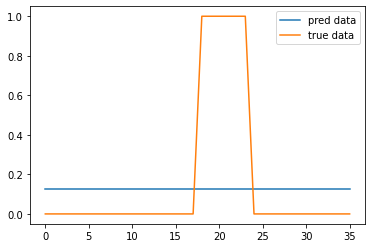

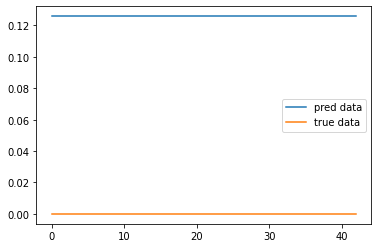

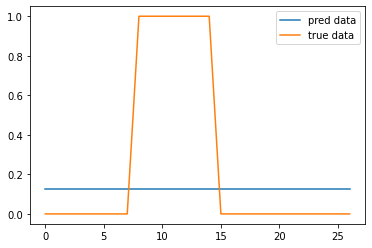

...

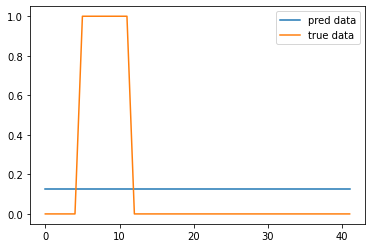

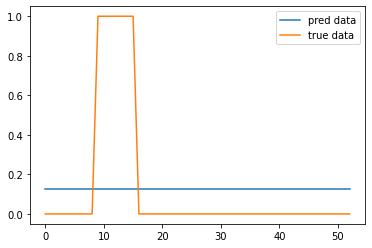

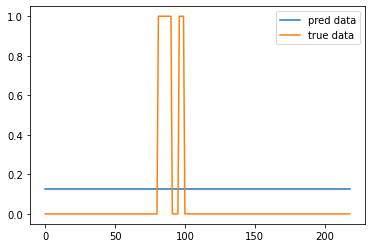

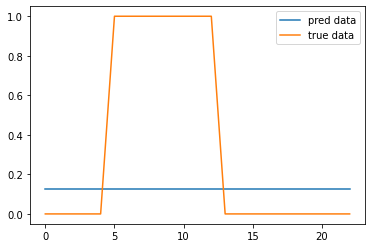

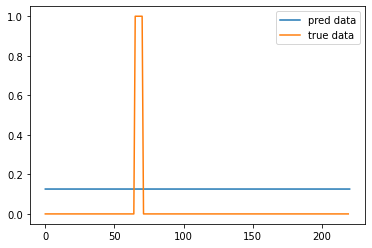

In [ ]:
plotCompare(yLittleTest, yPred, lstOfTime_test)

### autoencoder's predict xTrain: 120 sounds

In [ ]:

model = load_model('/content/drive/MyDrive/dz/mod/model_raw2.h5', compile = False)

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               65792     
                                                                 
 dense_1 (Dense)             (None, 128)               32896     
                                                                 
 dense_2 (Dense)             (None, 64)                8256      
                                                                 
 dense_3 (Dense)             (None, 32)                2080      
                                                                 
 dense_4 (Dense)             (None, 1)                 33        
                                                                 
Total params: 109,057
Trainable params: 109,057
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#Компилируем сеть
model.compile(optimizer=Adam(lr=0.0001),
              loss='binary_crossentropy',
              metrics=['accuracy'])

### Predict data and analyzis

In [ ]:
yPred = model.predict(predict_stft) # to predict of train data

In [ ]:
train

array([[-1.2690876 , -1.5614367 , -1.5800195 , ...,  0.24941999,
         0.26860327,  0.27855727],
       [-1.2690876 , -1.5614367 , -1.5800195 , ...,  0.24941999,
         0.26860327,  0.27855727],
       [-1.2690876 , -1.5614367 , -1.5800195 , ...,  0.24941999,
         0.26860327,  0.27855727],
       ...,
       [ 1.363855  ,  1.1231521 ,  0.33931208, ..., -0.9415999 ,
        -0.9376004 , -0.9323771 ],
       [ 0.9255713 ,  0.12960997, -0.878832  , ..., -0.9415999 ,
        -0.9376004 , -0.9323771 ],
       [-0.9809085 , -1.0507221 , -1.3225898 , ..., -0.9415999 ,
        -0.9376004 , -0.9323771 ]], dtype=float32)

In [ ]:
predict_stft

<tf.Tensor: shape=(10350, 256), dtype=float32, numpy=
array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)>

In [ ]:
yPred

array([[0.12583742],
       [0.12583742],
       [0.12583742],
       ...,
       [0.12583742],
       [0.12583742],
       [0.12583742]], dtype=float32)

### how predicted xTrain correspond to true yTrain

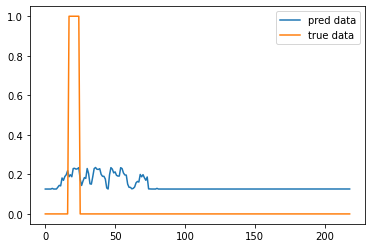

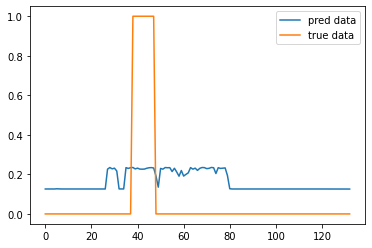

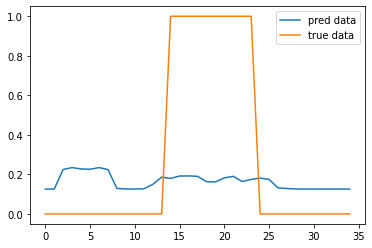

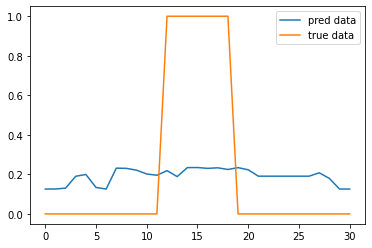

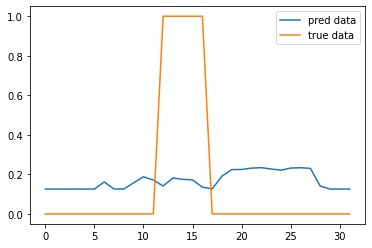

...

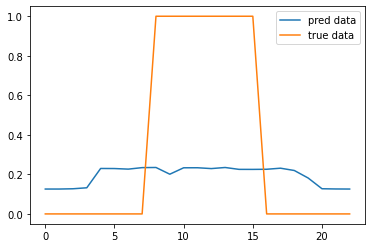

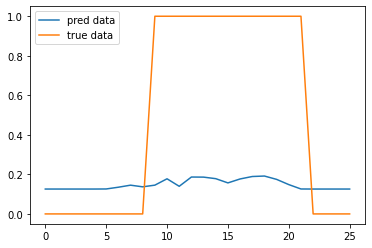

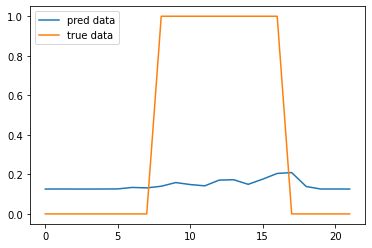

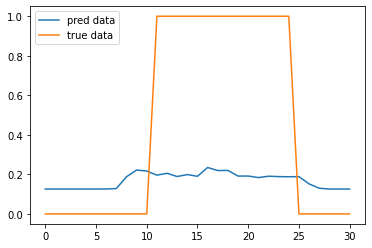

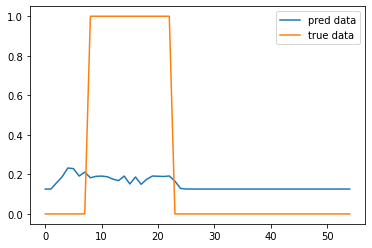

In [ ]:
plotCompare(yLittle, yPred, lstOfTime)


### how predicted xTest correspond to true yTest

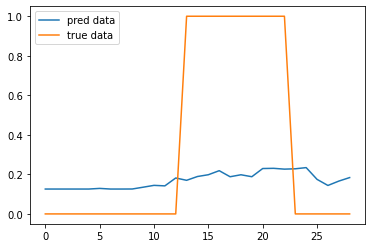

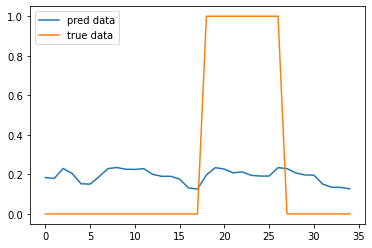

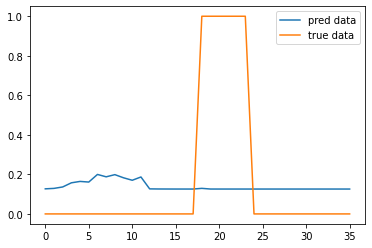

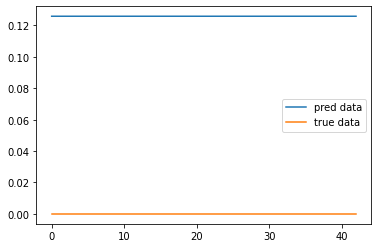

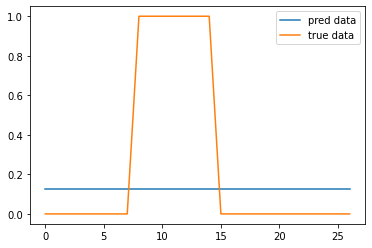

...

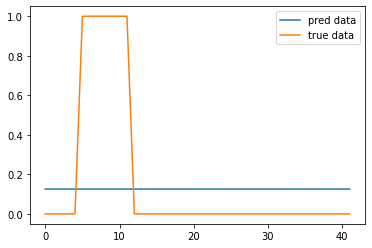

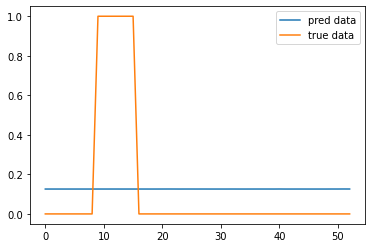

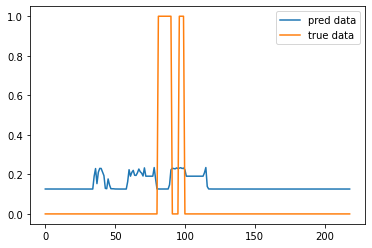

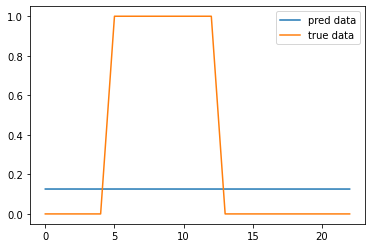

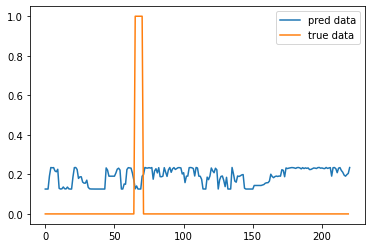

In [ ]:
plotCompare(yLittleTest, yPred, lstOfTime_test)

### autoencoder's predict xTrain: 150 sounds

In [ ]:

model = load_model('/content/drive/MyDrive/dz/mod/model_raw2.h5', compile = False)

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               65792     
                                                                 
 dense_1 (Dense)             (None, 128)               32896     
                                                                 
 dense_2 (Dense)             (None, 64)                8256      
                                                                 
 dense_3 (Dense)             (None, 32)                2080      
                                                                 
 dense_4 (Dense)             (None, 1)                 33        
                                                                 
Total params: 109,057
Trainable params: 109,057
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#Компилируем сеть
model.compile(optimizer=Adam(lr=0.0001),
              loss='binary_crossentropy',
              metrics=['accuracy'])

### Predict data and analyzis

In [ ]:
yPred = model.predict(predict_stft) # to predict of train data

In [ ]:
train

array([[-1.2690876 , -1.5614367 , -1.5800195 , ...,  0.24941999,
         0.26860327,  0.27855727],
       [-1.2690876 , -1.5614367 , -1.5800195 , ...,  0.24941999,
         0.26860327,  0.27855727],
       [-1.2690876 , -1.5614367 , -1.5800195 , ...,  0.24941999,
         0.26860327,  0.27855727],
       ...,
       [ 1.363855  ,  1.1231521 ,  0.33931208, ..., -0.9415999 ,
        -0.9376004 , -0.9323771 ],
       [ 0.9255713 ,  0.12960997, -0.878832  , ..., -0.9415999 ,
        -0.9376004 , -0.9323771 ],
       [-0.9809085 , -1.0507221 , -1.3225898 , ..., -0.9415999 ,
        -0.9376004 , -0.9323771 ]], dtype=float32)

In [ ]:
predict_stft

<tf.Tensor: shape=(10350, 256), dtype=float32, numpy=
array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)>

In [ ]:
yPred

array([[0.12583742],
       [0.12583742],
       [0.12583742],
       ...,
       [0.12583742],
       [0.12583742],
       [0.12583742]], dtype=float32)

### how predicted xTrain correspond to true yTrain

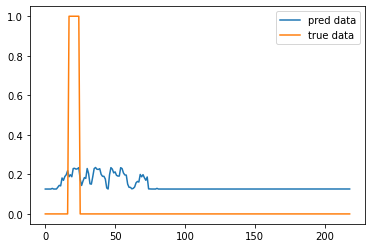

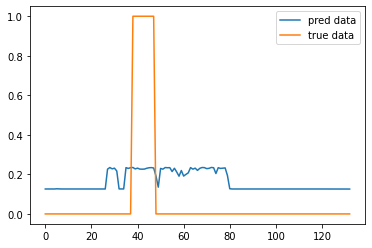

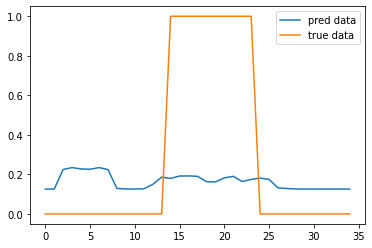

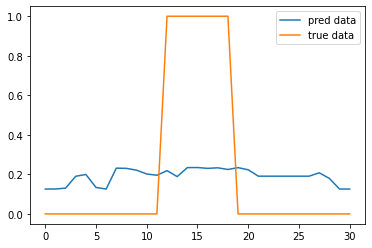

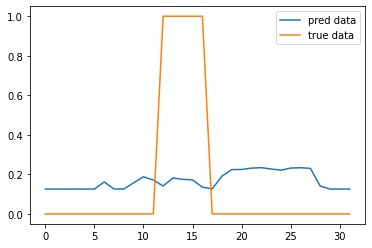

...

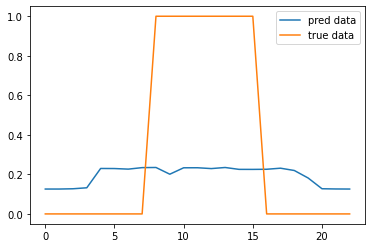

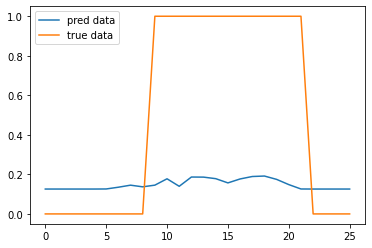

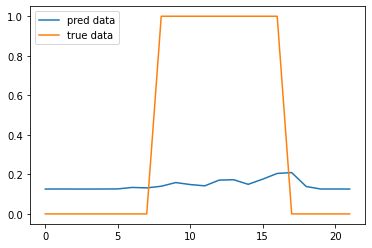

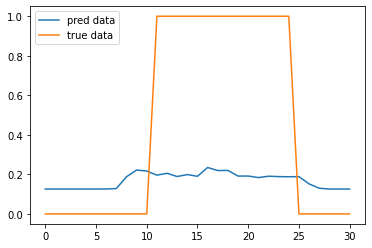

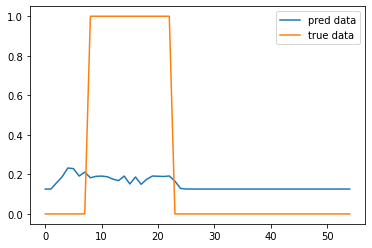

In [ ]:
plotCompare(yLittle, yPred, lstOfTime)


### how predicted xTest correspond to true yTest

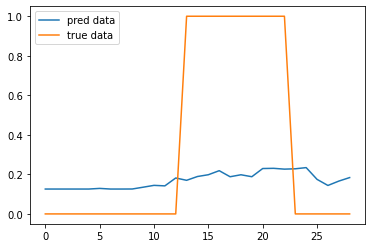

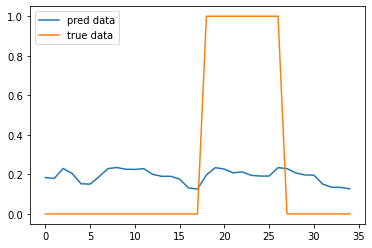

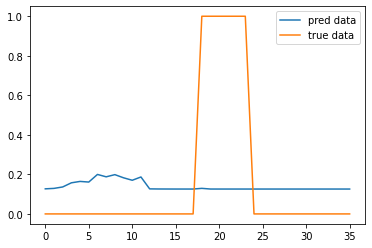

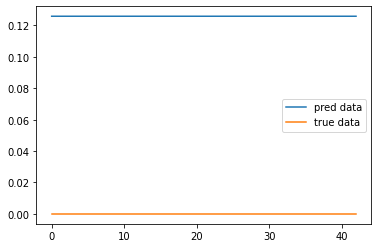

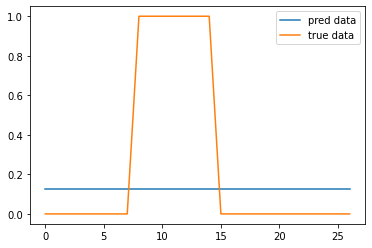

...

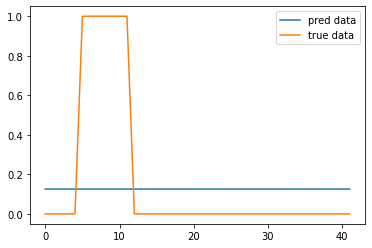

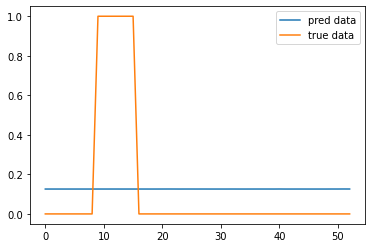

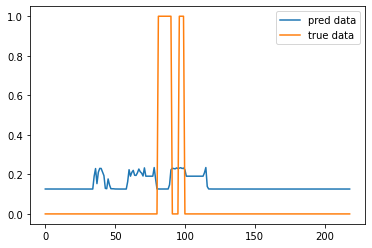

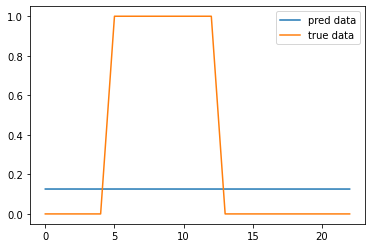

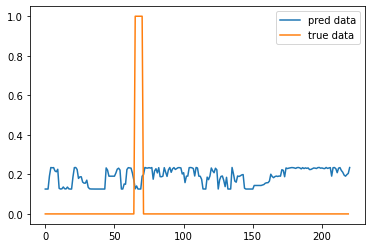

In [ ]:
plotCompare(yLittleTest, yPred, lstOfTime_test)

## кластеризация

In [ ]:
# not normalize mfcc
clustersCount = 2            # Задаем количество кластеров
kmean = KMeans(clustersCount) # Создаем объект KMeans с указанным количеством кластеров
kmean.fit(sounds)     # Произвдим кластеризацию данных xTrain01Scaled
labels = kmean.labels_   

ValueError: ignored

In [ ]:
# normalize mfcc
clustersCount = 2            # Задаем количество кластеров
kmean = KMeans(clustersCount) # Создаем объект KMeans с указанным количеством кластеров
kmean.fit(snd)           # Произвдим кластеризацию данных xTrain01
labels = kmean.labels_        # Получаем метки кластеров

In [ ]:
'''
  Функция печати информации о кластере
    Входные данные:
      - x - набор данных
'''
def printCluster(x):
  print("Размер кластера:", x.shape[0]) # Выведем количество элементов в кластере
  
  mX = np.mean(np.mean(x, axis=0), axis = 0) # Считаем среднее значение по кластеру
  minX = np.min(np.min(x, axis=0), axis = 0) # Находим минимальное значение в кластере
  maxX = np.max(np.max(x, axis=0), axis = 0) # Находим максимальное значение в кластере
  stdX = np.std(np.std(x, axis=0), axis = 0) # Находим стандартное отклонение элементов кластера
  print(f'mean: {mX}, minimum: {minX}, maximum: {maxX}, std: {stdX}')

In [ ]:
#not normalize
clustNN0 = mfcc[labels==0,:]
clustNN1 = mfcc[labels==1,:]

In [ ]:
# normalize
clustN0 = snd[labels==0,:]
clustN1 = snd[labels==1,:]

In [ ]:
printCluster(clustNN0)

Размер кластера: 420
mean: -9.607672691345215, minimum: -617.8041381835938, maximum: 283.88385009765625, std: 11.404311180114746


In [ ]:
printCluster(clustNN1)

Размер кластера: 653
mean: -7.547247409820557, minimum: -355.7785339355469, maximum: 262.57196044921875, std: 8.316579818725586


In [ ]:
printCluster(clustN0)

Размер кластера: 738
mean: 0.03281998261809349, minimum: -3.801459550857544, maximum: 4.567549705505371, std: 0.1022145003080368


In [ ]:
np.save('/content/drive/MyDrive/dz/pronounce/clustN0.npy', clustN0)

In [ ]:
printCluster(clustN1)

Размер кластера: 335
mean: -0.07230189442634583, minimum: -4.294548034667969, maximum: 5.20112943649292, std: 0.1580125242471695


In [ ]:
clustN1.shape

(466, 40)

In [ ]:
# take spectors for autoencoders - 120 sounds
stft, mfcc, lasts = toTakeRawSounds(sounds, n_fft = n_fft)

# Results of tests

In [ ]:
bd = pd.read_csv('/content/drive/MyDrive/dz/pronounce/results.csv')

In [ ]:
bd

,net,type,"accuracy, %","time, s",visibility
0,Dense,stft accur,92.95,34.0,1.0
1,Dense,mfcc accur,95.15,26.0,1.0
2,Dense,chroma_stft accur,95.15,26.0,0.0
3,Dense,accur,90.14,20.0,0.5
4,Dense,zero cross rating,89.95,54.0,0.0
5,Dense,rmse,89.97,19.0,0.0
6,Dense,spec cent,89.67,19.0,0.0
7,Dense,roll off,89.37,19.0,0.0
8,Dense,"rmse, spec cent, roll off",91.30,19.0,0.0
9,Dense,"chr stft, chrg, rmse, spec, roll",92.17,20.0,1.0


In [ ]:
bd.loc[len(bd)] = ['Dense', 'stft', 87.32, 27, 0, 30]

In [ ]:
bd.loc[len(bd)] = ['Dense', 'stft', 87.49, 22, 0, 120]

In [ ]:
bd.loc[len(bd)] = ['Dense', 'stft', 87.80, 25, 0, 150]

In [ ]:
bd['autoencoder'][12] = 120


In [ ]:
bd

,net,type,"accuracy, %","time, s",visibility,autoencoder
0,Dense,stft,92.95,34.0,1.0,0
1,Dense,mfcc 36,95.15,26.0,1.0,0
2,Dense,chroma stft,95.15,26.0,0.0,0
3,Dense,chromagram,90.14,20.0,0.5,0
4,Dense,zero cross rating,89.95,54.0,0.0,0
5,Dense,rmse,89.97,19.0,0.0,0
6,Dense,spec cent,89.67,19.0,0.0,0
7,Dense,roll off,89.37,19.0,0.0,0
8,Dense,"rmse, spec cent, roll off",91.30,19.0,0.0,0
9,Dense,"chr stft, chrg, rmse, spec, roll",92.17,20.0,1.0,0


In [ ]:
bd.to_csv('/content/drive/MyDrive/dz/pronounce/results.csv', index=False)

Задачи: 

Проверить, до какого предела оптимально сжимать на автокодировщике - в 2 раза, в 100 раз? для распознавания. 

Определить, не повысят ли точность принципы u,w-нетки (и т.д.), когда подаются на новые уровни входы со старых, чтобы сохранить контуры

Проверить, какие из способов обработки звуков - фурье, mfcc, stft и другие какой вклад вносят в точность. Например, подать дополнительным входом частоту пересечения нуля и все остальные, а потом отсекать

Проверить зависимости точности "эталонов" от количества звуков в выборке: 50, 100, 200

Проверить точность работы при разной "упаковке" исходных данных - либо спектры, как они записаны, либо сдвоенные, смещённые - для удобства обработки автокодировщиком. 

Проверить, какой оптимальный n_ftt для каждого из звуков - 511 или другие значения

Проверить архитектуры автокодировщиков и классификаторов и другие гиперпараметры нейронных сетей для достижения максимальной точности. 

Проверить тип оптимизации - адам и т.д. какой лучше подходит

Проверить, какая ошибка - кроссэнтропи, бинарная и т.д. лучше подходит для автокодировщиков, какой тип ошибки считать - и какие они вообще бывают, чтобы сравнивать

проверить, какой тип релу, лики релу и т.д. лучше подходит.

# Результаты и выводы

Наилучший результат из единичных параметров аудио показал mfcc. Отдельные chroma_stft, chromagram и т.д. не показали результатов. Concatenate "мелких" признаков типа chroma_stft даёт результат, сравнимый со спектром stft. 

Для дальнейших исследований остановились на mfcc

Дифтонг [ai] при распознавании давал погрешность: классификатор распознавал и звук [ai], и некоторые звуки [a], [i]. 

### Данные оценки работы классификатора: 

истинно распознанные звуки: 119

звуки, распознанные, как истинные, но ими не являются: 115

распознанные, как ложные, но они истинные: 137

распознанные как ложные - и они являются ложными: 1676

Word Recognition Rate: 87.69 %

Word Error Rate: 12.31 %

Точность: 0.51 

Полнота: 0.46 

Гармоническое среднее: 0.49

Вывод: на дифтонгах проводить классификацию нет смысла, лучше брать отдельные звуки. 

Использовался yTest, yTrain из 0 и 1, где не было целевого звука, и был целевой звук. 

Классификатор показал рост и спад вероятности с пиком, соответствовавшим 1 в yTrain, yTest. 

В дальшейшей работе использовать yTrain, yTest, в котором указываются меньшие вероятности звука. Например, там, где звук [b] ещё не закончился, а звук [a] только начался, ставить не 1 или 0, а процент: 0.7, 0.8, 0.9, 1.0, 1.0, 1.0, 0.9, 0.8. Это может повысить точность предсказаний.

### Данные по распознаванию автоэнкодером: 

Предсказанные звуки [ai] при обработке автоэнкодером не дали возможности использовать bias для отсеивания "чистых" и "не чистых" звуков. Границы ошибок перекрывались полностью, средние значения почти совпадали. 

Поэтому воспользовались обученным классификатором, и прогнали через него предсказанные звуки. Получили вероятность того, что каждый из звуков относится к [ai]. 

Полученная вероятность иногда была больше 1, иногда сильно меньше. Возможно, стоит добавить какое-то нормирование или дополнительный софтмакс слой.

Можно предположить, что эта вероятность коррелирует с чистотой звука.

###Проверил на слух каждый из распознанных звуков. Закономерности:

автоэнкодер чаще поддерживает женский голос. Тестовая выборка выбиралась наугад; возможно, в ней больше женских голосов.

в целом, автоэнкодер отражает "чистоту" произношения. Те, что распознавал классификатор, но не распознавал автоэнкодер, часто были более глухими.

Звуки, которые подаются на автоэнкодер, обрезаны при классификации. Возможно, следует изменить n_fft и задать больший плюс-минус в 500-1000 единиц. 

### Эксперимент по предобработке мин-макс скалером и стандарт скалером. Закономерности: 

МинМаксСкалер даёт большую точность. Границы звуков более широкие. В одном треке распознано меньше звуков. Точность повысилась за счёт отсеивания ложно положительных звуков. Больше можно доверять среднему значению. Автоэнкодер больше поддерживает классификатор - больше значений, отличных от 0, по сравнению со СтандартСкалером.

### Эксперимент по предобработке тренировочного набора на подготовленном автоэнкодере. 

По идее, "лишние" звуки должны были бы гаситься. На практике звуки распознавались чуть "грязнее" - захватывались соседние. Но, в отличие от других, дал лучшее предсказание на 2 целевых звука в слове.

# Results and Conclusions

he diphthong [ai] gave an error during recognition: the classifier recognized both the sound [ai] and some sounds [a], [i].

Conclusion: there is no point in classifying diphthongs, it is better to take individual sounds.

Used yTest, yTrain of 0 and 1 where there was no target sound and there was a target sound.

The classifier showed rise and fall in probability with a peak corresponding to 1 in yTrain, yTest.

In further work, use yTrain, yTest, which indicates lower sound probabilities. For example, where the sound [b] has not yet ended, and the sound [a] has just begun, put not 1 or 0, but a percentage: 0.7, 0.8, 0.9, 1.0, 1.0, 1.0, 0.9, 0.8. This can improve the accuracy of predictions.